## Mechanism Study of Diels-Alder Reactions

In [1]:
import psi4
import numpy as np
import matplotlib.pyplot as plt
#import py3Dmol
#import pandas as pd

/home/bryan/miniconda3/envs/p4env/lib/python3.10/site-packages/numpy/_core/getlimits.py:551: UserWarning: Signature b'\x00\xd0\xcc\xcc\xcc\xcc\xcc\xcc\xfb\xbf\x00\x00\x00\x00\x00\x00' for <class 'numpy.longdouble'> does not match any known type: falling back to type probe function.
This warnings indicates broken support for the dtype!
  machar = _get_machar(dtype)


In [2]:
psi4.set_memory('2GB')
psi4.set_num_threads(2)
#psi4.core.set_output_file("output_DA.dat", False)


  Memory set to   1.863 GiB by Python driver.
  Threads set to 2 by Python driver.


In [4]:
backbone = """
symmetry c1
0 1
C
C 1 1.34
sub1 2 120
sub2 2 120 3 180
sub3 1 120 3 0
sub4 1 120 3 180
sub5
sub6
sub7
sub8
"""

H12 = 'H 1 1.08'
H34 = 'H 2 1.08'
C12 = 'C 1 1.54'
C34 = 'C 2 1.54'
N1 = 'N 3 1.14 1 180 2 0'
N2 = 'N 4 1.14 1 180 2 0'
N3 = 'N 5 1.14 2 180 1 0'
N4 = 'N 6 1.14 2 180 1 0'

def replace_sub(sub1, sub2, sub3, sub4, sub5, sub6, sub7, sub8):
    replacements = {'sub1': sub1, 'sub2': sub2, 'sub3': sub3, 'sub4': sub4,
                    'sub5': sub5, 'sub6': sub6, 'sub7': sub7, 'sub8': sub8,}
    molecule = backbone
    for old, new in replacements.items():
        molecule = molecule.replace(old, new)
    return molecule

mono = replace_sub(C12, H12, H34, H34, N1, '', '', '').strip()  # Acrylnitrile
di = replace_sub(C12, C12, H34, H34, N1, N2, '', '').strip()  # 1,1-Dicyanoethene
cis_di = replace_sub(C12, H12, C34, H34, N1, N3, '', '').strip()  # cis-1,2-Dicyanoethene
trans_di = replace_sub(C12, H12, H34, C34, N1, N4, '', '').strip()  # trans-1,2-Dicyanoethene
tri = replace_sub(C12, C12, C34, H34, N1, N2, N3, '').strip()  # Tricyanoethene
tetra = replace_sub(C12, C12, C34, C34, N1, N2, N3, N4).strip()  # Tetracyanoethene

In [3]:
psi4.core.clean()
psi4.core.clean_options()

In [44]:
cyanoethene = [mono, di, cis_di, trans_di, tri, tetra]
E_cyanoethene = []
LUMO_cyanoethene = []

for mol in cyanoethene:
    psi4.core.clean()
    geom = psi4.geometry(mol)
    psi4.set_options({'basis': '6-31G(d)'})
    psi4.optimize('HF', molecule = geom)

    E, wfn = psi4.energy('HF', return_wfn=True)
    E_cyanoethene.append(E)

    LUMO = wfn.epsilon_a_subset("AO", "ALL").np[wfn.nalpha()]
    LUMO_cyanoethene.append(LUMO)

    psi4.core.clean()

Optimizer: Optimization complete!


	Unable to completely converge to displaced geometry.
	RMS(dx):  2.001e-07 	Max(dx):  6.660e-07 	RMS(dq):  1.835e-07
	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 1.84e-07

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 1.53e-08

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 5.94e-08

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 9.63e-08



Optimizer: Optimization complete!


	Unable to completely converge to displaced geometry.
	RMS(dx):  3.953e-08 	Max(dx):  1.019e-07 	RMS(dq):  4.276e-08
	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 4.28e-08

	Unable to completely converge to displaced geometry.
	RMS(dx):  3.393e-08 	Max(dx):  1.019e-07 	RMS(dq):  6.733e-08
	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 6.40e-08

	Unable to completely converge to displaced geometry.
	RMS(dx):  1.679e-07 	Max(dx):  5.040e-07 	RMS(dq):  4.190e-06
	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 2.93e-07

	Unable to completely converge to displaced geometry.
	RMS(dx):  7.656e-07 	Max(dx):  2.257e-06 	RMS(dq):  1.269e-06
	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 1.27e-06

	Unable to compl

Optimizer: Optimization complete!
Optimizer: Optimization complete!


	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 1.17e-09



Optimizer: Optimization complete!


	Unable to completely converge to displaced geometry.
	RMS(dx):  8.636e-08 	Max(dx):  2.871e-07 	RMS(dq):  1.273e-07
	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 1.27e-07

	Unable to completely converge to displaced geometry.
	RMS(dx):  5.046e-07 	Max(dx):  2.114e-06 	RMS(dq):  6.979e-07
	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 6.98e-07

	Unable to completely converge to displaced geometry.
	RMS(dx):  2.872e-06 	Max(dx):  1.251e-05 	RMS(dq):  3.755e-06
	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 2.80e-06



Optimizer: Optimization complete!


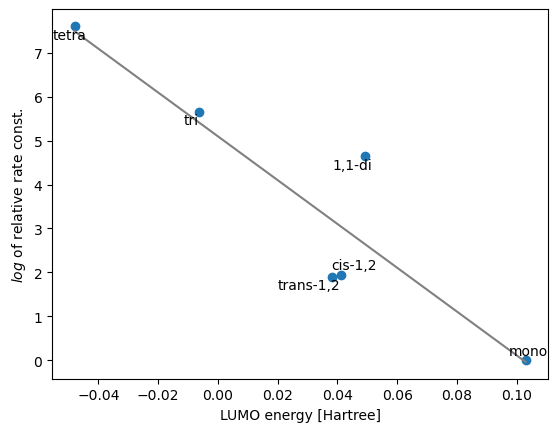

In [ ]:
from adjustText import adjust_text

rate = [0, 4.64, 1.94, 1.89, 5.66, 7.61]
label = ['mono', '1,1-di', 'cis-1,2', 'trans-1,2', 'tri', 'tetra']

x, y = LUMO_cyanoethene, rate
plt.scatter(x, y)
z = np.polyfit(x, y, 1)
p = np.poly1d(z)
plt.plot(x, p(x), color='gray', linestyle='-')

texts = [plt.text(x[i], y[i], label[i], ha='center', va='center') for i in range(len(x))]
adjust_text(texts)
plt.xlabel('LUMO energy [Hartree]', fontsize=10)
plt.ylabel('$log$ of relative rate const.', fontsize=10)

plt.show()

log of the experimental relative rate for the DA reaction with cyclopentadiene
- ref: Phys. Chem. Chem. Phys., 2013, 15, 7311-7320

https://forum.psicode.org/t/homo-lumo-energies/488/4

https://sharifsuliman.medium.com/visualizing-frontier-orbitals-with-psi4-and-python-c01f335afaad

https://iwatobipen.wordpress.com/2019/03/13/visualize-homo-lumo-with-psi4-rdkit-psi4-psikit/

https://www.andersle.no/posts/2022/mo/mo.html

https://www.chegg.com/homework-help/questions-and-answers/table-2-dienophile-structure-spartan-image-log-relative-rate-diels-alder-addition-lumo-ene-q45152390

In [3]:
psi4.core.clean()
psi4.core.clean_options()

In [ ]:
r1_ts = psi4.geometry("""
0 1
C
C  1 1.502  
C  1 1.502  2 102.9
C  2 1.352  1 109.5  3    0.0
C  3 1.352  1 109.5  2    0.0
H  1 1.105  2 111.7  4  120.0
H  1 1.105  2 111.7  4 -120.0
H  2 1.080  1 126.6  3  180.0
H  3 1.080  1 126.6  2  180.0
H  4 1.080  2 124.7  1  180.0
H  5 1.080  3 124.7  1  180.0
--
0 1                      
C  2 2.250  3  80.0  5   90.0
C 12 1.330  2 100.0  3    0.0
C 12 1.432 13 120.0  3  -90.0
N 14 1.136 12 180.0 13   66.9
H 13 1.080 12 120.0 14    0.0
H 12 1.080 13 120.0 16  180.0
H 13 1.080 12 120.0 14  180.0
symmetry c1
""")

psi4.set_options({'basis': '3-21G',
                  'opt_type': 'ts',
                  'frag_mode': 'multi',
                  'full_hess_every': 0,
                  'normal_modes_write': True
                  })

psi4.optimize('HF', molecule=r1_ts)
psi4.frequency('HF')
psi4.core.clean()


Scratch directory: /tmp/
gradient() will perform analytic gradient computation.
   => Libint2 <=

    Primary   basis highest AM E, G, H:  6, 6, 3
    Auxiliary basis highest AM E, G, H:  7, 7, 4
    Onebody   basis highest AM E, G, H:  -, -, -
    Solid Harmonics ordering:            Gaussian

*** tstart() called on LAPTOP-0TVB8UPA
*** at Tue Apr 29 13:28:45 2025

   => Loading Basis Set <=

    Name: 3-21G
    Role: ORBITAL
    Keyword: BASIS
    atoms 1-5, 12-14  entry C          line    68 file /home/bryan/miniconda3/envs/p4env/share/psi4/basis/3-21g.gbs 
    atoms 6-11, 16-18 entry H          line    21 file /home/bryan/miniconda3/envs/p4env/share/psi4/basis/3-21g.gbs 
    atoms 15          entry N          line    79 file /home/bryan/miniconda3/envs/p4env/share/psi4/basis/3-21g.gbs 


         ---------------------------------------------------------
                                   SCF
               by Justin Turney, Rob Parrish, Andy Simmonett
                          and 

In [ ]:
r1_backward = r1_ts.clone() # clone the optimized structure of the TS
r1_forward = r1_ts.clone()

psi4.set_options({'opt_type': 'irc',
                  'irc_direction': 'forward',
                  'full_hess_every': 0,
                  'irc_step_size': 0.20,
                  'geom_maxiter':500})

E_r1_for, history_r1_for = psi4.optimize('HF', molecule=r1_forward, return_history=True)

psi4.core.clean()

In [ ]:
psi4.set_options({'opt_type': 'irc',
                  'irc_direction': 'backward',
                  'full_hess_every': 0,
                  'irc_step_size': 0.20,
                  'geom_maxiter':500})

E_r1_back, history_r1_back = psi4.optimize('HF', molecule=r1_backward, return_history=True)

psi4.core.clean()

In [6]:
r2_ts = psi4.geometry("""
0 1
N  2.530273 -1.969963 -0.259385
C  1.538135 -1.410593 -0.416865
N  2.530283  1.969954 -0.259356
C  1.538141  1.410592 -0.416844
N -1.560982  1.964663 -1.861835
C -0.728312  1.408933 -1.296853
N -1.560996 -1.964623 -1.861861
C -0.728320 -1.408910 -1.296873
C  0.290373  0.712516 -0.560006
C  0.290371 -0.712510 -0.560017
H -0.121501  2.188928  1.618404
C -0.409257  1.149939  1.512948
H -2.577668  1.325844  1.136457
H -0.121505 -2.188951  1.618379
C  0.406724 -0.000014  2.024224
H  0.328283 -0.000019  3.120415
C -1.724864  0.697523  1.356367
C -0.409259 -1.149960  1.512936
H  1.466821 -0.000014  1.774689
C -1.724866 -0.697539  1.356360
H -2.577671 -1.325857  1.136444                                                                    
""")

psi4.set_options({'basis': '3-21G',
                  'opt_type': 'ts'
                  })

psi4.optimize('HF', molecule=r2_ts)
psi4.core.clean()


Scratch directory: /tmp/
gradient() will perform analytic gradient computation.
   => Libint2 <=

    Primary   basis highest AM E, G, H:  6, 6, 3
    Auxiliary basis highest AM E, G, H:  7, 7, 4
    Onebody   basis highest AM E, G, H:  -, -, -
    Solid Harmonics ordering:            Gaussian

*** tstart() called on LAPTOP-0TVB8UPA
*** at Wed Apr 30 14:19:52 2025

   => Loading Basis Set <=

    Name: 3-21G
    Role: ORBITAL
    Keyword: BASIS
    atoms 1, 3, 5, 7                       entry N          line    79 file /home/bryan/miniconda3/envs/p4env/share/psi4/basis/3-21g.gbs 
    atoms 2, 4, 6, 8-10, 12, 15, 17-18, 20 entry C          line    68 file /home/bryan/miniconda3/envs/p4env/share/psi4/basis/3-21g.gbs 
    atoms 11, 13-14, 16, 19, 21            entry H          line    21 file /home/bryan/miniconda3/envs/p4env/share/psi4/basis/3-21g.gbs 


         ---------------------------------------------------------
                                   SCF
               by Justin Tur

	Energy ratio indicates iffy step.
	Intrafrag trust radius decreased to   0.05.




	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.13971       -0.00090       -0.00004       1.13967
	              R(2,10)       1.42935        0.05771        0.00150       1.43085
	               R(3,4)       1.13972        0.02103        0.00032       1.14004
	               R(4,9)       1.42935        0.00043        0.00028       1.42963
	               R(5,6)       1.13939        0.01990        0.00030       1.13969
	               R(6,9)       1.42903       -0.00317        0.00022       1.42925
	               R(7,8)       1.13939        0.00312        0.00002       1.13941
	              R(8,10)       1.42903        0.05726        0.00152       1.43055
	              R(9,10)       1.41

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 5.04e-05





	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.13967        0.00404        0.00000       1.13967
	              R(2,10)       1.43085        0.02423        0.00014       1.43100
	               R(3,4)       1.14004        0.01085       -0.00008       1.13996
	               R(4,9)       1.42963       -0.00115       -0.00044       1.42918
	               R(5,6)       1.13969        0.01083       -0.00006       1.13963
	               R(6,9)       1.42925       -0.00335       -0.00056       1.42869
	               R(7,8)       1.13941        0.00503       -0.00002       1.13939
	              R(8,10)       1.43055        0.02390        0.00010       1.43064
	              R(9,10)       1.42

	Energy ratio indicates iffy step.
	Intrafrag trust radius decreased to 0.0375.




	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.13967        0.01162        0.00050       1.14017
	              R(2,10)       1.43100       -0.00090       -0.00040       1.43060
	               R(3,4)       1.13996        0.00678        0.00024       1.14020
	               R(4,9)       1.42918        0.00307        0.00049       1.42968
	               R(5,6)       1.13963        0.00763        0.00028       1.13990
	               R(6,9)       1.42869        0.00354        0.00060       1.42929
	               R(7,8)       1.13939        0.01137        0.00048       1.13986
	              R(8,10)       1.43064       -0.00367       -0.00064       1.43000
	              R(9,10)       1.42

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 5.23e-05





	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.14017        0.00049        0.00007       1.14024
	              R(2,10)       1.43060       -0.00526       -0.00282       1.42777
	               R(3,4)       1.14020        0.00031       -0.00004       1.14017
	               R(4,9)       1.42968       -0.00128       -0.00015       1.42952
	               R(5,6)       1.13990        0.00051       -0.00002       1.13989
	               R(6,9)       1.42929       -0.00091        0.00016       1.42945
	               R(7,8)       1.13986        0.00096        0.00011       1.13998
	              R(8,10)       1.43000       -0.00434       -0.00208       1.42792
	              R(9,10)       1.42

	Energy ratio indicates iffy step.
	Intrafrag trust radius decreased to 0.0844.
	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 2.47e-05





	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.14023        0.00039        0.00003       1.14025
	              R(2,10)       1.42746        0.01084        0.00147       1.42893
	               R(3,4)       1.14001       -0.00023        0.00003       1.14004
	               R(4,9)       1.42997       -0.00467       -0.00033       1.42965
	               R(5,6)       1.13971       -0.00054        0.00001       1.13973
	               R(6,9)       1.42950        0.00008        0.00011       1.42960
	               R(7,8)       1.13999       -0.00574       -0.00018       1.13981
	              R(8,10)       1.42778       -0.00496       -0.00024       1.42753
	              R(9,10)       1.40

	Energy ratio indicates iffy step.
	Intrafrag trust radius decreased to 0.0633.




	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.13998        0.00214        0.00018       1.14015
	              R(2,10)       1.42902       -0.00477       -0.00051       1.42851
	               R(3,4)       1.13992        0.00130        0.00013       1.14005
	               R(4,9)       1.43025       -0.00785       -0.00098       1.42926
	               R(5,6)       1.13965        0.00097        0.00010       1.13975
	               R(6,9)       1.42911       -0.00049        0.00017       1.42927
	               R(7,8)       1.13978        0.00036        0.00008       1.13986
	              R(8,10)       1.42884       -0.00295       -0.00022       1.42862
	              R(9,10)       1.40

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 6.67e-05





	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.14015       -0.00373       -0.00019       1.13996
	              R(2,10)       1.42851        0.00208        0.00034       1.42885
	               R(3,4)       1.14005        0.00005        0.00018       1.14023
	               R(4,9)       1.42926       -0.00085       -0.00077       1.42849
	               R(5,6)       1.13975       -0.00034        0.00008       1.13983
	               R(6,9)       1.42927       -0.00346       -0.00064       1.42863
	               R(7,8)       1.13986       -0.00293       -0.00017       1.13969
	              R(8,10)       1.42862        0.00042        0.00022       1.42884
	              R(9,10)       1.39

	Energy ratio indicates iffy step.
	Intrafrag trust radius decreased to 0.0475.




	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.13996       -0.00111       -0.00005       1.13991
	              R(2,10)       1.42885        0.00756        0.00106       1.42991
	               R(3,4)       1.14023       -0.00135       -0.00006       1.14017
	               R(4,9)       1.42849       -0.00167       -0.00005       1.42844
	               R(5,6)       1.13983       -0.00081       -0.00003       1.13980
	               R(6,9)       1.42863       -0.00195       -0.00026       1.42837
	               R(7,8)       1.13969        0.00023        0.00001       1.13970
	              R(8,10)       1.42884        0.00716        0.00094       1.42979
	              R(9,10)       1.40

	Energy ratio indicates iffy step.
	Intrafrag trust radius decreased to  0.107.




	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.14011       -0.00166       -0.00008       1.14002
	              R(2,10)       1.42950       -0.00070       -0.00012       1.42938
	               R(3,4)       1.14009       -0.00099       -0.00003       1.14006
	               R(4,9)       1.42910        0.00135        0.00005       1.42916
	               R(5,6)       1.13982       -0.00121       -0.00005       1.13977
	               R(6,9)       1.42893       -0.00118       -0.00016       1.42877
	               R(7,8)       1.13981       -0.00124       -0.00007       1.13974
	              R(8,10)       1.42890        0.00083        0.00009       1.42899
	              R(9,10)       1.40

In [ ]:
r2_ts_back = r2_ts.clone()
r2_ts_for = r2_ts.clone()

psi4.set_options({'basis': '3-21G',
                  'opt_type': 'irc',
                  'irc_direction': 'backward',
                  'irc_step_size': 0.20,
                  'geom_maxiter': 100})

E_back = psi4.optimize('HF', molecule = r2_ts_back)
psi4.core.clean()


Scratch directory: /tmp/
gradient() will perform analytic gradient computation.
   => Libint2 <=

    Primary   basis highest AM E, G, H:  6, 6, 3
    Auxiliary basis highest AM E, G, H:  7, 7, 4
    Onebody   basis highest AM E, G, H:  -, -, -
    Solid Harmonics ordering:            Gaussian

*** tstart() called on LAPTOP-0TVB8UPA
*** at Wed Apr 30 14:26:50 2025

   => Loading Basis Set <=

    Name: 3-21G
    Role: ORBITAL
    Keyword: BASIS
    atoms 1, 3, 5, 7                       entry N          line    79 file /home/bryan/miniconda3/envs/p4env/share/psi4/basis/3-21g.gbs 
    atoms 2, 4, 6, 8-10, 12, 15, 17-18, 20 entry C          line    68 file /home/bryan/miniconda3/envs/p4env/share/psi4/basis/3-21g.gbs 
    atoms 11, 13-14, 16, 19, 21            entry H          line    21 file /home/bryan/miniconda3/envs/p4env/share/psi4/basis/3-21g.gbs 


         ---------------------------------------------------------
                                   SCF
               by Justin Tur

In [ ]:
psi4.core.clean_options()

psi4.set_options({'basis': '3-21G',
                  'normal_modes_write': True
                  })

psi4.frequency('HF')
psi4.core.clean()


Scratch directory: /tmp/
gradient() will perform analytic gradient computation.
   => Libint2 <=

    Primary   basis highest AM E, G, H:  6, 6, 3
    Auxiliary basis highest AM E, G, H:  7, 7, 4
    Onebody   basis highest AM E, G, H:  -, -, -
    Solid Harmonics ordering:            Gaussian

*** tstart() called on LAPTOP-0TVB8UPA
*** at Wed Apr 30 10:54:28 2025

   => Loading Basis Set <=

    Name: 3-21G
    Role: ORBITAL
    Keyword: BASIS
    atoms 1, 3, 5, 7                       entry N          line    79 file /home/bryan/miniconda3/envs/p4env/share/psi4/basis/3-21g.gbs 
    atoms 2, 4, 6, 8-10, 12, 15, 17-18, 20 entry C          line    68 file /home/bryan/miniconda3/envs/p4env/share/psi4/basis/3-21g.gbs 
    atoms 11, 13-14, 16, 19, 21            entry H          line    21 file /home/bryan/miniconda3/envs/p4env/share/psi4/basis/3-21g.gbs 


         ---------------------------------------------------------
                                   SCF
               by Justin Tur

: 

https://pubs.acs.org/doi/10.1021/acs.accounts.2c00343

https://www.reddit.com/r/comp_chem/comments/k07kqw/improving_my_transition_state_guesses/?rdt=64623

https://psicode.org/psi4manual/master/optking.html

https://chemistry.stackexchange.com/questions/294/z-matrix-of-a-series-of-5-colinear-atoms#:~:text=You%20cannot%20have%20bond%20angles,gradients%20can%20ruin%20your%20day.

In [6]:
psi4.core.clean_options()
psi4.core.clean()

In [7]:
PES = {}
dihedrals = np.linspace(0, 180, 19)

def PES_dihedral(molecule):
    with open(f'molecules/{molecule}.txt', 'r') as f:
        mol = f.read()

    geom = psi4.geometry(mol)

    psi4.set_options({'basis': '3-21G',
                      'intrafrag_step_limit': 0.1,
                      'frozen_dihedral': (' 1 2 3 4 ')})

    PES[molecule] = []

    for phi in dihedrals:
        geom.D = phi
        E = psi4.optimize('HF')
        PES[molecule].append(E)

    psi4.core.clean()

In [8]:
PES_dihedral('1,3-butadiene')

Molecule: geometry: Molecule is not complete, please use 'update_geometry'
                    once all variables are set.
Molecule: Setting geometry variable D to 0.000000

Scratch directory: /tmp/
gradient() will perform analytic gradient computation.
   => Libint2 <=

    Primary   basis highest AM E, G, H:  6, 6, 3
    Auxiliary basis highest AM E, G, H:  7, 7, 4
    Onebody   basis highest AM E, G, H:  -, -, -
    Solid Harmonics ordering:            Gaussian

*** tstart() called on LAPTOP-0TVB8UPA
*** at Thu May  1 15:37:01 2025

   => Loading Basis Set <=

    Name: 3-21G
    Role: ORBITAL
    Keyword: BASIS
    atoms 1-4  entry C          line    68 file /home/bryan/miniconda3/envs/p4env/share/psi4/basis/3-21g.gbs 
    atoms 5-10 entry H          line    21 file /home/bryan/miniconda3/envs/p4env/share/psi4/basis/3-21g.gbs 


         ---------------------------------------------------------
                                   SCF
               by Justin Turney, Rob Parrish, And

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 1.31e-12



Optimizer: Optimization complete!

	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.32013       -0.00057       -0.00006       1.32007
	               R(1,5)       1.07275       -0.00013       -0.00001       1.07274
	               R(1,6)       1.07324       -0.00063       -0.00008       1.07316
	               R(2,3)       1.47863       -0.00029       -0.00018       1.47846
	               R(2,7)       1.07503       -0.00042       -0.00006       1.07498
	               R(3,4)       1.32013       -0.00057       -0.00006       1.32007
	              R(3,10)       1.07503       -0.00042       -0.00006       1.07498
	               R(4,8)       1.07275       -0.00013       -0.00001       1.07274


	Previous geometry is closer to target in internal coordinates, so using that one.




*** tstop() called on LAPTOP-0TVB8UPA at Thu May  1 15:37:21 2025
Module time:
	user time   =       1.73 seconds =       0.03 minutes
	system time =       0.03 seconds =       0.00 minutes
	total time  =          1 seconds =       0.02 minutes
Total time:
	user time   =    5970.62 seconds =      99.51 minutes
	system time =     495.25 seconds =       8.25 minutes
	total time  =       4605 seconds =      76.75 minutes

*** tstart() called on LAPTOP-0TVB8UPA
*** at Thu May  1 15:37:21 2025


         ------------------------------------------------------------
                                   SCF GRAD                          
                          Rob Parrish, Justin Turney,                
                       Andy Simmonett, and Alex Sokolov              
         ------------------------------------------------------------

  ==> Geometry <==

    Molecular point group: c2
    Full point group: C2

    Geometry (in Angstrom), charge = 0, multiplicity = 1:

       Center     

	Best geometry has RMS(Delta(q)) = 2.18e-06





	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.31992        0.00130        0.00011       1.32003
	               R(1,5)       1.07277       -0.00007       -0.00001       1.07276
	               R(1,6)       1.07324       -0.00017       -0.00003       1.07321
	               R(2,3)       1.47796        0.00064        0.00008       1.47804
	               R(2,7)       1.07510       -0.00006       -0.00001       1.07509
	               R(3,4)       1.31992        0.00130        0.00011       1.32003
	              R(3,10)       1.07510       -0.00006       -0.00001       1.07509
	               R(4,8)       1.07277       -0.00007       -0.00001       1.07276
	               R(4,9)       1.07

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 3.02e-08



Optimizer: Optimization complete!

	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.31997       -0.00027       -0.00002       1.31994
	               R(1,5)       1.07279       -0.00000       -0.00000       1.07279
	               R(1,6)       1.07330        0.00005        0.00001       1.07331
	               R(2,3)       1.47739       -0.00029       -0.00004       1.47735
	               R(2,7)       1.07533        0.00001        0.00000       1.07533
	               R(3,4)       1.31997       -0.00027       -0.00002       1.31994
	              R(3,10)       1.07533        0.00001        0.00000       1.07533
	               R(4,8)       1.07279       -0.00000       -0.00000       1.07279


	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 7.02e-07





	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.31646        0.00099        0.00005       1.31651
	               R(1,5)       1.07336        0.00029        0.00004       1.07340
	               R(1,6)       1.07355       -0.00003       -0.00000       1.07354
	               R(2,3)       1.48581        0.00110        0.00029       1.48610
	               R(2,7)       1.07698       -0.00074       -0.00009       1.07689
	               R(3,4)       1.31646        0.00099        0.00005       1.31651
	              R(3,10)       1.07698       -0.00074       -0.00009       1.07689
	               R(4,8)       1.07336        0.00029        0.00004       1.07340
	               R(4,9)       1.07

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 2.05e-06



Module time:
	user time   =       1.93 seconds =       0.03 minutes
	system time =       0.03 seconds =       0.00 minutes
	total time  =          2 seconds =       0.03 minutes
Total time:
	user time   =    6073.33 seconds =     101.22 minutes
	system time =     499.69 seconds =       8.33 minutes
	total time  =       4689 seconds =      78.15 minutes

*** tstart() called on LAPTOP-0TVB8UPA
*** at Thu May  1 15:38:45 2025


         ------------------------------------------------------------
                                   SCF GRAD                          
                          Rob Parrish, Justin Turney,                
                       Andy Simmonett, and Alex Sokolov              
         ------------------------------------------------------------

  ==> Geometry <==

    Molecular point group: c2
    Full point group: C2

    Geometry (in Angstrom), charge = 0, multiplicity = 1:

       Center              X                  Y                   Z               Mas

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 3.94e-06





	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.31657       -0.00058       -0.00004       1.31653
	               R(1,5)       1.07328       -0.00019       -0.00004       1.07324
	               R(1,6)       1.07405        0.00018        0.00004       1.07410
	               R(2,3)       1.49016       -0.00163       -0.00035       1.48981
	               R(2,7)       1.07612       -0.00004       -0.00002       1.07610
	               R(3,4)       1.31657       -0.00058       -0.00004       1.31653
	              R(3,10)       1.07612       -0.00004       -0.00002       1.07610
	               R(4,8)       1.07328       -0.00019       -0.00004       1.07324
	               R(4,9)       1.07

	Failed to converge alpha. Doing simple step-scaling instead.



*** tstop() called on LAPTOP-0TVB8UPA at Thu May  1 15:39:22 2025
Module time:
	user time   =       1.63 seconds =       0.03 minutes
	system time =       0.06 seconds =       0.00 minutes
	total time  =          2 seconds =       0.03 minutes
Total time:
	user time   =    6121.67 seconds =     102.03 minutes
	system time =     501.94 seconds =       8.37 minutes
	total time  =       4726 seconds =      78.77 minutes

*** tstart() called on LAPTOP-0TVB8UPA
*** at Thu May  1 15:39:22 2025


         ------------------------------------------------------------
                                   SCF GRAD                          
                          Rob Parrish, Justin Turney,                
                       Andy Simmonett, and Alex Sokolov              
         ------------------------------------------------------------

  ==> Geometry <==

    Molecular point group: c2
    Full point group: C2

    Geometry (in Angstrom), charge = 0, multiplicity = 1:

       Center     

	Failed to converge alpha. Doing simple step-scaling instead.



*** tstop() called on LAPTOP-0TVB8UPA at Thu May  1 15:39:30 2025
Module time:
	user time   =       1.70 seconds =       0.03 minutes
	system time =       0.09 seconds =       0.00 minutes
	total time  =          1 seconds =       0.02 minutes
Total time:
	user time   =    6132.14 seconds =     102.20 minutes
	system time =     502.48 seconds =       8.37 minutes
	total time  =       4734 seconds =      78.90 minutes

*** tstart() called on LAPTOP-0TVB8UPA
*** at Thu May  1 15:39:30 2025


         ------------------------------------------------------------
                                   SCF GRAD                          
                          Rob Parrish, Justin Turney,                
                       Andy Simmonett, and Alex Sokolov              
         ------------------------------------------------------------

  ==> Geometry <==

    Molecular point group: c2
    Full point group: C2

    Geometry (in Angstrom), charge = 0, multiplicity = 1:

       Center     

	Change in internal coordinate of 6.30e-01 exceeds limit of 5.00e-01.
	Skipping Hessian update for step 3.
	Change in internal coordinate of 6.30e-01 exceeds limit of 5.00e-01.
	Skipping Hessian update for step 2.
	Energy has increased in a minimization.
	Energy ratio indicates iffy step.
	Intrafrag trust radius decreased to  0.225.



*** tstop() called on LAPTOP-0TVB8UPA at Thu May  1 15:39:33 2025
Module time:
	user time   =       1.80 seconds =       0.03 minutes
	system time =       0.04 seconds =       0.00 minutes
	total time  =          1 seconds =       0.02 minutes
Total time:
	user time   =    6135.28 seconds =     102.25 minutes
	system time =     502.59 seconds =       8.38 minutes
	total time  =       4737 seconds =      78.95 minutes

*** tstart() called on LAPTOP-0TVB8UPA
*** at Thu May  1 15:39:33 2025


         ------------------------------------------------------------
                                   SCF GRAD                          
                          Rob Parrish, Justin Turney,                
                       Andy Simmonett, and Alex Sokolov              
         ------------------------------------------------------------

  ==> Geometry <==

    Molecular point group: c2
    Full point group: C2

    Geometry (in Angstrom), charge = 0, multiplicity = 1:

       Center     

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 4.21e-04





	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.32066        0.01102        0.00023       1.32089
	               R(1,5)       1.07225        0.00210        0.00039       1.07264
	               R(1,6)       1.07476       -0.00040       -0.00013       1.07463
	               R(2,3)       1.46942        0.04966        0.00906       1.47848
	               R(2,7)       1.07579        0.00811        0.00087       1.07666
	               R(3,4)       1.32066        0.01102        0.00023       1.32089
	              R(3,10)       1.07579        0.00811        0.00087       1.07666
	               R(4,8)       1.07225        0.00210        0.00039       1.07264
	               R(4,9)       1.07

	Change in internal coordinate of 5.23e-01 exceeds limit of 5.00e-01.
	Skipping Hessian update for step 1.



    			-----------------------------------------

    			 OPTKING 3.0: for geometry optimizations 

    			     By R.A. King, Bethel University     

    			        with contributions from          

    			    A.V. Copan, J. Cayton, A. Heide      

    			-----------------------------------------

    
	                            ===> Fragment 1 <== 

	 Z (Atomic Numbers)          Masses                          Geom                  
	       6.000000            12.000000          3.04045707  1.41061946  0.40585306   
	       6.000000            12.000000          0.71471367  1.20028312 -0.47579129   
	       6.000000            12.000000         -0.71471367 -1.20028312 -0.47579129   
	       6.000000            12.000000         -3.04045707 -1.41061946  0.40585306   
	       1.000000             1.007825          3.92422434  3.21768273  0.65525305   
	       1.000000             1.007825          4.16778015 -0.21586652  0.86151685   
	       1.000000             1.007825         -0

	Change in internal coordinate of 5.10e-01 exceeds limit of 5.00e-01.
	Skipping Hessian update for step 4.



    			-----------------------------------------

    			 OPTKING 3.0: for geometry optimizations 

    			     By R.A. King, Bethel University     

    			        with contributions from          

    			    A.V. Copan, J. Cayton, A. Heide      

    			-----------------------------------------

    
	                            ===> Fragment 1 <== 

	 Z (Atomic Numbers)          Masses                          Geom                  
	       6.000000            12.000000          3.04453331  1.40973711  0.41440626   
	       6.000000            12.000000          0.72157341  1.19875835 -0.46291287   
	       6.000000            12.000000         -0.72157341 -1.19875835 -0.46291287   
	       6.000000            12.000000         -3.04453331 -1.40973711  0.41440626   
	       1.000000             1.007825          3.98130193  3.20432835  0.52367836   
	       1.000000             1.007825          4.10711442 -0.20413917  1.03804705   
	       1.000000             1.007825         -0

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 2.13e-04





	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.31874       -0.00081       -0.00048       1.31826
	               R(1,5)       1.07281       -0.00006        0.00010       1.07291
	               R(1,6)       1.07445       -0.00008       -0.00007       1.07438
	               R(2,3)       1.48082       -0.00339        0.00155       1.48237
	               R(2,7)       1.07603       -0.00068       -0.00024       1.07578
	               R(3,4)       1.31874       -0.00081       -0.00048       1.31826
	              R(3,10)       1.07603       -0.00068       -0.00024       1.07578
	               R(4,8)       1.07281       -0.00006        0.00010       1.07291
	               R(4,9)       1.07

	Change in internal coordinate of 6.27e-01 exceeds limit of 5.00e-01.
	Skipping Hessian update for step 4.



*** tstop() called on LAPTOP-0TVB8UPA at Thu May  1 15:39:41 2025
Module time:
	user time   =       1.72 seconds =       0.03 minutes
	system time =       0.03 seconds =       0.00 minutes
	total time  =          2 seconds =       0.03 minutes
Total time:
	user time   =    6144.48 seconds =     102.41 minutes
	system time =     503.00 seconds =       8.38 minutes
	total time  =       4745 seconds =      79.08 minutes

*** tstart() called on LAPTOP-0TVB8UPA
*** at Thu May  1 15:39:41 2025


         ------------------------------------------------------------
                                   SCF GRAD                          
                          Rob Parrish, Justin Turney,                
                       Andy Simmonett, and Alex Sokolov              
         ------------------------------------------------------------

  ==> Geometry <==

    Molecular point group: c2
    Full point group: C2

    Geometry (in Angstrom), charge = 0, multiplicity = 1:

       Center     

	Energy has increased in a minimization.
	Energy ratio indicates iffy step.
	Intrafrag trust radius decreased to   0.25.


Module time:
	user time   =       1.83 seconds =       0.03 minutes
	system time =       0.12 seconds =       0.00 minutes
	total time  =          1 seconds =       0.02 minutes
Total time:
	user time   =    6147.69 seconds =     102.46 minutes
	system time =     503.14 seconds =       8.39 minutes
	total time  =       4747 seconds =      79.12 minutes

*** tstart() called on LAPTOP-0TVB8UPA
*** at Thu May  1 15:39:43 2025


         ------------------------------------------------------------
                                   SCF GRAD                          
                          Rob Parrish, Justin Turney,                
                       Andy Simmonett, and Alex Sokolov              
         ------------------------------------------------------------

  ==> Geometry <==

    Molecular point group: c2
    Full point group: C2

    Geometry (in Angstrom), charge = 0, multiplicity = 1:

       Center              X                  Y                   Z               Mas

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 1.86e-08



Optimizer: Optimization complete!


	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.31829        0.00028        0.00001       1.31829
	               R(1,5)       1.07286        0.00016        0.00000       1.07286
	               R(1,6)       1.07440       -0.00006       -0.00000       1.07440
	               R(2,3)       1.48175        0.00012        0.00003       1.48178
	               R(2,7)       1.07569        0.00023        0.00001       1.07571
	               R(3,4)       1.31829        0.00028        0.00001       1.31829
	              R(3,10)       1.07569        0.00023        0.00001       1.07571
	               R(4,8)       1.07286        0.00016        0.00000       1.07286

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 2.18e-06




*** tstop() called on LAPTOP-0TVB8UPA at Thu May  1 15:39:59 2025
Module time:
	user time   =       2.42 seconds =       0.04 minutes
	system time =       0.06 seconds =       0.00 minutes
	total time  =          2 seconds =       0.03 minutes
Total time:
	user time   =    6168.09 seconds =     102.80 minutes
	system time =     504.20 seconds =       8.40 minutes
	total time  =       4763 seconds =      79.38 minutes

*** tstart() called on LAPTOP-0TVB8UPA
*** at Thu May  1 15:39:59 2025


         ------------------------------------------------------------
                                   SCF GRAD                          
                          Rob Parrish, Justin Turney,                
                       Andy Simmonett, and Alex Sokolov              
         ------------------------------------------------------------

  ==> Geometry <==

    Molecular point group: c2
    Full point group: C2

    Geometry (in Angstrom), charge = 0, multiplicity = 1:

       Center     

	Failed to converge alpha. Doing simple step-scaling instead.



    			-----------------------------------------

    			 OPTKING 3.0: for geometry optimizations 

    			     By R.A. King, Bethel University     

    			        with contributions from          

    			    A.V. Copan, J. Cayton, A. Heide      

    			-----------------------------------------

    
	                            ===> Fragment 1 <== 

	 Z (Atomic Numbers)          Masses                          Geom                  
	       6.000000            12.000000          3.18947398  1.24672273  0.25361234   
	       6.000000            12.000000          0.75525641  1.16870288 -0.28285362   
	       6.000000            12.000000         -0.75525641 -1.16870288 -0.28285362   
	       6.000000            12.000000         -3.18947398 -1.24672273  0.25361234   
	       1.000000             1.007825          4.20926972  2.99680539  0.32875177   
	       1.000000             1.007825          4.25806083 -0.43826533  0.62964985   
	       1.000000             1.007825         -0

	Change in internal coordinate of 6.28e-01 exceeds limit of 5.00e-01.
	Skipping Hessian update for step 3.
	Change in internal coordinate of 6.36e-01 exceeds limit of 5.00e-01.
	Skipping Hessian update for step 2.
	Energy has increased in a minimization.
	Energy ratio indicates iffy step.
	Intrafrag trust radius decreased to  0.225.



    			-----------------------------------------

    			 OPTKING 3.0: for geometry optimizations 

    			     By R.A. King, Bethel University     

    			        with contributions from          

    			    A.V. Copan, J. Cayton, A. Heide      

    			-----------------------------------------

    
	                            ===> Fragment 1 <== 

	 Z (Atomic Numbers)          Masses                          Geom                  
	       6.000000            12.000000          3.15354595  1.30571552  0.23530475   
	       6.000000            12.000000          0.73979127  1.23062196 -0.30864156   
	       6.000000            12.000000         -0.73979127 -1.23062196 -0.30864156   
	       6.000000            12.000000         -3.15354595 -1.30571552  0.23530475   
	       1.000000             1.007825          4.10843510  3.06010759  0.59894842   
	       1.000000             1.007825          4.28306462 -0.37725242  0.34063041   
	       1.000000             1.007825         -0

	Change in internal coordinate of 5.04e-01 exceeds limit of 5.00e-01.
	Skipping Hessian update for step 4.



*** tstop() called on LAPTOP-0TVB8UPA at Thu May  1 15:40:20 2025
Module time:
	user time   =       1.78 seconds =       0.03 minutes
	system time =       0.16 seconds =       0.00 minutes
	total time  =          2 seconds =       0.03 minutes
Total time:
	user time   =    6194.04 seconds =     103.23 minutes
	system time =     505.41 seconds =       8.42 minutes
	total time  =       4784 seconds =      79.73 minutes

*** tstart() called on LAPTOP-0TVB8UPA
*** at Thu May  1 15:40:20 2025


         ------------------------------------------------------------
                                   SCF GRAD                          
                          Rob Parrish, Justin Turney,                
                       Andy Simmonett, and Alex Sokolov              
         ------------------------------------------------------------

  ==> Geometry <==

    Molecular point group: c2
    Full point group: C2

    Geometry (in Angstrom), charge = 0, multiplicity = 1:

       Center     

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 2.26e-04





	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.31933        0.00567        0.00012       1.31945
	               R(1,5)       1.07278       -0.00112       -0.00010       1.07268
	               R(1,6)       1.07440        0.00008        0.00002       1.07442
	               R(2,3)       1.47875       -0.03591       -0.00381       1.47494
	               R(2,7)       1.07571       -0.00010       -0.00009       1.07562
	               R(3,4)       1.31933        0.00567        0.00012       1.31945
	              R(3,10)       1.07571       -0.00010       -0.00009       1.07562
	               R(4,8)       1.07278       -0.00112       -0.00010       1.07268
	               R(4,9)       1.07

	Change in internal coordinate of 6.25e-01 exceeds limit of 5.00e-01.
	Skipping Hessian update for step 4.



*** tstop() called on LAPTOP-0TVB8UPA at Thu May  1 15:40:23 2025
Module time:
	user time   =       1.69 seconds =       0.03 minutes
	system time =       0.06 seconds =       0.00 minutes
	total time  =          2 seconds =       0.03 minutes
Total time:
	user time   =    6197.22 seconds =     103.29 minutes
	system time =     505.53 seconds =       8.43 minutes
	total time  =       4787 seconds =      79.78 minutes

*** tstart() called on LAPTOP-0TVB8UPA
*** at Thu May  1 15:40:23 2025


         ------------------------------------------------------------
                                   SCF GRAD                          
                          Rob Parrish, Justin Turney,                
                       Andy Simmonett, and Alex Sokolov              
         ------------------------------------------------------------

  ==> Geometry <==

    Molecular point group: c2
    Full point group: C2

    Geometry (in Angstrom), charge = 0, multiplicity = 1:

       Center     

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 2.32e-07





	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.31945        0.00220        0.00024       1.31970
	               R(1,5)       1.07268       -0.00040       -0.00009       1.07259
	               R(1,6)       1.07442        0.00004        0.00002       1.07445
	               R(2,3)       1.47494       -0.01139       -0.00227       1.47267
	               R(2,7)       1.07562        0.00005        0.00007       1.07569
	               R(3,4)       1.31945        0.00220        0.00024       1.31970
	              R(3,10)       1.07562        0.00005        0.00007       1.07569
	               R(4,8)       1.07268       -0.00040       -0.00009       1.07259
	               R(4,9)       1.07

	Change in internal coordinate of 6.28e-01 exceeds limit of 5.00e-01.
	Skipping Hessian update for step 4.


	total time  =       4789 seconds =      79.82 minutes

*** tstart() called on LAPTOP-0TVB8UPA
*** at Thu May  1 15:40:25 2025


         ------------------------------------------------------------
                                   SCF GRAD                          
                          Rob Parrish, Justin Turney,                
                       Andy Simmonett, and Alex Sokolov              
         ------------------------------------------------------------

  ==> Geometry <==

    Molecular point group: c2
    Full point group: C2

    Geometry (in Angstrom), charge = 0, multiplicity = 1:

       Center              X                  Y                   Z               Mass       
    ------------   -----------------  -----------------  -----------------  -----------------
         C            1.687914043718     0.659657876294     0.134237647221    12.000000000000
         C            0.399768450460     0.618364840236    -0.149614088079    12.000000000000
         

	Energy has increased in a minimization.
	Energy ratio indicates iffy step.
	Intrafrag trust radius decreased to   0.25.


Module time:
	user time   =       1.82 seconds =       0.03 minutes
	system time =       0.05 seconds =       0.00 minutes
	total time  =          2 seconds =       0.03 minutes
Total time:
	user time   =    6203.40 seconds =     103.39 minutes
	system time =     505.83 seconds =       8.43 minutes
	total time  =       4792 seconds =      79.87 minutes

*** tstart() called on LAPTOP-0TVB8UPA
*** at Thu May  1 15:40:28 2025


         ------------------------------------------------------------
                                   SCF GRAD                          
                          Rob Parrish, Justin Turney,                
                       Andy Simmonett, and Alex Sokolov              
         ------------------------------------------------------------

  ==> Geometry <==

    Molecular point group: c2
    Full point group: C2

    Geometry (in Angstrom), charge = 0, multiplicity = 1:

       Center              X                  Y                   Z               Mas

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 1.55e-03





	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.31098        0.13325        0.00663       1.31761
	               R(1,5)       1.07204        0.01698        0.00100       1.07304
	               R(1,6)       1.07747       -0.03366       -0.00215       1.07532
	               R(2,3)       1.50233        0.35712        0.01654       1.51887
	               R(2,7)       1.08018       -0.05981       -0.00365       1.07653
	               R(3,4)       1.31098        0.13325        0.00663       1.31761
	              R(3,10)       1.08018       -0.05981       -0.00365       1.07653
	               R(4,8)       1.07204        0.01698        0.00100       1.07304
	               R(4,9)       1.07

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 3.39e-06




    			-----------------------------------------

    			 OPTKING 3.0: for geometry optimizations 

    			     By R.A. King, Bethel University     

    			        with contributions from          

    			    A.V. Copan, J. Cayton, A. Heide      

    			-----------------------------------------

    
	                            ===> Fragment 1 <== 

	 Z (Atomic Numbers)          Masses                          Geom                  
	       6.000000            12.000000          3.23398710  1.19336850  0.17034886   
	       6.000000            12.000000          0.76548695  1.15839760 -0.18939011   
	       6.000000            12.000000         -0.76548695 -1.15839760 -0.18939011   
	       6.000000            12.000000         -3.23398710 -1.19336850  0.17034886   
	       1.000000             1.007825          4.28036640  2.92840894  0.22028711   
	       1.000000             1.007825          4.30450415 -0.51397844  0.41786682   
	       1.000000             1.007825         -0

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 3.60e-07





	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.32009        0.00011        0.00001       1.32010
	               R(1,5)       1.07252       -0.00009       -0.00002       1.07250
	               R(1,6)       1.07442        0.00009        0.00002       1.07444
	               R(2,3)       1.46969       -0.00049       -0.00011       1.46958
	               R(2,7)       1.07564        0.00017        0.00003       1.07567
	               R(3,4)       1.32009        0.00011        0.00001       1.32010
	              R(3,10)       1.07564        0.00017        0.00003       1.07567
	               R(4,8)       1.07252       -0.00009       -0.00002       1.07250
	               R(4,9)       1.07

	Failed to converge alpha. Doing simple step-scaling instead.



    			-----------------------------------------

    			 OPTKING 3.0: for geometry optimizations 

    			     By R.A. King, Bethel University     

    			        with contributions from          

    			    A.V. Copan, J. Cayton, A. Heide      

    			-----------------------------------------

    
	                            ===> Fragment 1 <== 

	 Z (Atomic Numbers)          Masses                          Geom                  
	       6.000000            12.000000          3.23418452  1.19322388  0.16975611   
	       6.000000            12.000000          0.76585816  1.15824730 -0.18988743   
	       6.000000            12.000000         -0.76585816 -1.15824730 -0.18988743   
	       6.000000            12.000000         -3.23418452 -1.19322388  0.16975611   
	       1.000000             1.007825          4.27961204  2.92857920  0.22688843   
	       1.000000             1.007825          4.30514904 -0.51472211  0.41156140   
	       1.000000             1.007825         -0

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 3.87e-07





	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.32033        0.00012        0.00001       1.32034
	               R(1,5)       1.07246       -0.00005       -0.00001       1.07245
	               R(1,6)       1.07442        0.00005        0.00001       1.07443
	               R(2,3)       1.46782       -0.00036       -0.00007       1.46776
	               R(2,7)       1.07564        0.00008        0.00001       1.07565
	               R(3,4)       1.32033        0.00012        0.00001       1.32034
	              R(3,10)       1.07564        0.00008        0.00001       1.07565
	               R(4,8)       1.07246       -0.00005       -0.00001       1.07245
	               R(4,9)       1.07

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 3.57e-08



Optimizer: Optimization complete!


	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.32034        0.00007        0.00001       1.32034
	               R(1,5)       1.07245        0.00000       -0.00000       1.07245
	               R(1,6)       1.07443        0.00000        0.00000       1.07443
	               R(2,3)       1.46776       -0.00004       -0.00001       1.46775
	               R(2,7)       1.07565        0.00001        0.00000       1.07565
	               R(3,4)       1.32034        0.00007        0.00001       1.32034
	              R(3,10)       1.07565        0.00001        0.00000       1.07565
	               R(4,8)       1.07245        0.00000       -0.00000       1.07245

	Unable to completely converge to displaced geometry.
	RMS(dx):  1.758e-06 	Max(dx):  3.871e-06 	RMS(dq):  3.195e-06
	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 1.47e-06



Optimizer: Optimization complete!


	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.32041        0.00011        0.00001       1.32041
	               R(1,5)       1.07244       -0.00000       -0.00000       1.07244
	               R(1,6)       1.07442        0.00001        0.00000       1.07443
	               R(2,3)       1.46717       -0.00009       -0.00002       1.46715
	               R(2,7)       1.07564        0.00001        0.00000       1.07564
	               R(3,4)       1.32041        0.00011        0.00001       1.32041
	              R(3,10)       1.07564        0.00001        0.00000       1.07564
	               R(4,8)       1.07244       -0.00000       -0.00000       1.07244

In [9]:
PES_dihedral('2-methoxy-1,3-butadiene')

Molecule: geometry: Molecule is not complete, please use 'update_geometry'
                    once all variables are set.
Molecule: Setting geometry variable D to 0.000000

Scratch directory: /tmp/
gradient() will perform analytic gradient computation.
   => Libint2 <=

    Primary   basis highest AM E, G, H:  6, 6, 3
    Auxiliary basis highest AM E, G, H:  7, 7, 4
    Onebody   basis highest AM E, G, H:  -, -, -
    Solid Harmonics ordering:            Gaussian

*** tstart() called on LAPTOP-0TVB8UPA
*** at Thu May  1 15:43:56 2025

   => Loading Basis Set <=

    Name: 3-21G
    Role: ORBITAL
    Keyword: BASIS
    atoms 1-4, 11          entry C          line    68 file /home/bryan/miniconda3/envs/p4env/share/psi4/basis/3-21g.gbs 
    atoms 5-6, 8-10, 12-14 entry H          line    21 file /home/bryan/miniconda3/envs/p4env/share/psi4/basis/3-21g.gbs 
    atoms 7                entry O          line    90 file /home/bryan/miniconda3/envs/p4env/share/psi4/basis/3-21g.gbs 


         

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 6.15e-06





	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.31572        0.08346        0.00779       1.32351
	               R(1,5)       1.06669        0.01402        0.00432       1.07101
	               R(1,6)       1.06560        0.01184        0.00433       1.06993
	               R(2,3)       1.45748        0.16271        0.02768       1.48516
	               R(2,7)       1.35999        0.14592        0.01760       1.37759
	               R(3,4)       1.31322        0.06945        0.00857       1.32180
	              R(3,10)       1.06907        0.01339        0.00322       1.07229
	               R(4,8)       1.06869        0.02383        0.00471       1.07340
	               R(4,9)       1.07

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 3.72e-09





	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.32084        0.00016       -0.00001       1.32083
	               R(1,5)       1.06933       -0.00044       -0.00007       1.06926
	               R(1,6)       1.06883        0.00017        0.00002       1.06885
	               R(2,3)       1.47924       -0.00412       -0.00078       1.47846
	               R(2,7)       1.37622        0.00052        0.00009       1.37631
	               R(3,4)       1.31736       -0.00212       -0.00019       1.31717
	              R(3,10)       1.07198       -0.00018       -0.00004       1.07194
	               R(4,8)       1.07241       -0.00016       -0.00003       1.07239
	               R(4,9)       1.07

	Energy has increased in a minimization.
	Energy ratio indicates iffy step.
	Intrafrag trust radius decreased to  0.025.




	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.32082        0.00110        0.00005       1.32088
	               R(1,5)       1.06937       -0.00032       -0.00004       1.06933
	               R(1,6)       1.06894       -0.00047       -0.00005       1.06889
	               R(2,3)       1.47814        0.00112        0.00014       1.47827
	               R(2,7)       1.37622       -0.00056       -0.00003       1.37619
	               R(3,4)       1.31714        0.00108        0.00005       1.31719
	              R(3,10)       1.07209       -0.00039       -0.00005       1.07204
	               R(4,8)       1.07243       -0.00020       -0.00002       1.07241
	               R(4,9)       1.07

	Energy has increased in a minimization.
	Energy ratio indicates iffy step.
	Intrafrag trust radius decreased to 0.0188.




	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.32095       -0.00039       -0.00005       1.32090
	               R(1,5)       1.06935       -0.00009       -0.00002       1.06933
	               R(1,6)       1.06887       -0.00003        0.00000       1.06888
	               R(2,3)       1.47829        0.00004        0.00000       1.47829
	               R(2,7)       1.37613       -0.00039        0.00001       1.37614
	               R(3,4)       1.31727       -0.00061       -0.00006       1.31720
	              R(3,10)       1.07204        0.00005        0.00000       1.07204
	               R(4,8)       1.07240       -0.00007       -0.00000       1.07240
	               R(4,9)       1.07

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 6.06e-09





	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.32087        0.00023        0.00002       1.32089
	               R(1,5)       1.06934       -0.00003       -0.00000       1.06934
	               R(1,6)       1.06889       -0.00010       -0.00002       1.06888
	               R(2,3)       1.47824        0.00028        0.00005       1.47829
	               R(2,7)       1.37616       -0.00025       -0.00003       1.37613
	               R(3,4)       1.31718        0.00017        0.00002       1.31720
	              R(3,10)       1.07205       -0.00003       -0.00001       1.07204
	               R(4,8)       1.07241       -0.00003       -0.00001       1.07240
	               R(4,9)       1.07

	Energy has increased in a minimization.
	Energy ratio indicates iffy step.
	Intrafrag trust radius decreased to  0.025.




	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.32084        0.00215        0.00011       1.32095
	               R(1,5)       1.06952       -0.00049       -0.00007       1.06946
	               R(1,6)       1.06906       -0.00081       -0.00008       1.06898
	               R(2,3)       1.47717        0.00301        0.00033       1.47751
	               R(2,7)       1.37603       -0.00163       -0.00008       1.37595
	               R(3,4)       1.31703        0.00224        0.00011       1.31715
	              R(3,10)       1.07241       -0.00080       -0.00009       1.07231
	               R(4,8)       1.07249       -0.00038       -0.00004       1.07245
	               R(4,9)       1.07

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 5.55e-06





	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.32095        0.00021        0.00017       1.32112
	               R(1,5)       1.06946        0.00001        0.00010       1.06955
	               R(1,6)       1.06898       -0.00011       -0.00007       1.06891
	               R(2,3)       1.47751        0.00020        0.00018       1.47768
	               R(2,7)       1.37595       -0.00089       -0.00037       1.37558
	               R(3,4)       1.31715        0.00028        0.00023       1.31738
	              R(3,10)       1.07231       -0.00011       -0.00001       1.07230
	               R(4,8)       1.07245       -0.00008       -0.00001       1.07245
	               R(4,9)       1.07

	Energy has increased in a minimization.
	Energy ratio indicates iffy step.
	Intrafrag trust radius decreased to 0.0188.




	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.32112       -0.00015       -0.00010       1.32102
	               R(1,5)       1.06955       -0.00084       -0.00010       1.06945
	               R(1,6)       1.06891        0.00009        0.00004       1.06895
	               R(2,3)       1.47768       -0.00045       -0.00011       1.47757
	               R(2,7)       1.37558        0.00128        0.00026       1.37584
	               R(3,4)       1.31738       -0.00166       -0.00019       1.31718
	              R(3,10)       1.07230        0.00004        0.00001       1.07231
	               R(4,8)       1.07245       -0.00022       -0.00001       1.07244
	               R(4,9)       1.07

	Energy has increased in a minimization.
	Energy ratio indicates iffy step.
	Intrafrag trust radius decreased to  0.025.




	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.32082        0.00215        0.00017       1.32099
	               R(1,5)       1.06970       -0.00053       -0.00005       1.06965
	               R(1,6)       1.06912       -0.00056       -0.00007       1.06905
	               R(2,3)       1.47662        0.00235        0.00033       1.47695
	               R(2,7)       1.37568       -0.00169       -0.00018       1.37550
	               R(3,4)       1.31691        0.00196        0.00017       1.31708
	              R(3,10)       1.07276       -0.00069       -0.00009       1.07267
	               R(4,8)       1.07256       -0.00036       -0.00004       1.07252
	               R(4,9)       1.07

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 2.88e-06





	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.32099        0.00008        0.00000       1.32099
	               R(1,5)       1.06965       -0.00016        0.00012       1.06977
	               R(1,6)       1.06905       -0.00006        0.00000       1.06905
	               R(2,3)       1.47695        0.00010       -0.00001       1.47694
	               R(2,7)       1.37550       -0.00079       -0.00025       1.37525
	               R(3,4)       1.31708       -0.00018        0.00006       1.31714
	              R(3,10)       1.07267       -0.00011        0.00004       1.07271
	               R(4,8)       1.07252       -0.00012        0.00003       1.07255
	               R(4,9)       1.07

	Energy ratio indicates iffy step.
	Intrafrag trust radius decreased to 0.0188.




	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.32099        0.00143        0.00003       1.32103
	               R(1,5)       1.06977       -0.00106       -0.00013       1.06964
	               R(1,6)       1.06905       -0.00031       -0.00001       1.06903
	               R(2,3)       1.47694        0.00099        0.00005       1.47699
	               R(2,7)       1.37525        0.00041        0.00018       1.37543
	               R(3,4)       1.31714       -0.00008       -0.00006       1.31709
	              R(3,10)       1.07271       -0.00036       -0.00005       1.07267
	               R(4,8)       1.07255       -0.00040       -0.00004       1.07251
	               R(4,9)       1.07

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 9.58e-08





	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.32103       -0.00028       -0.00003       1.32099
	               R(1,5)       1.06964       -0.00001        0.00000       1.06964
	               R(1,6)       1.06903        0.00005        0.00001       1.06904
	               R(2,3)       1.47699       -0.00040       -0.00006       1.47693
	               R(2,7)       1.37543       -0.00047       -0.00005       1.37538
	               R(3,4)       1.31709       -0.00029       -0.00002       1.31706
	              R(3,10)       1.07267       -0.00003       -0.00001       1.07265
	               R(4,8)       1.07251       -0.00003       -0.00000       1.07251
	               R(4,9)       1.07

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 1.62e-05





	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.32030        0.00599        0.00034       1.32065
	               R(1,5)       1.06983        0.00043        0.00006       1.06989
	               R(1,6)       1.06927       -0.00121       -0.00011       1.06915
	               R(2,3)       1.47592        0.00718        0.00076       1.47668
	               R(2,7)       1.37580       -0.00630       -0.00048       1.37532
	               R(3,4)       1.31618        0.00885        0.00050       1.31669
	              R(3,10)       1.07340       -0.00276       -0.00025       1.07315
	               R(4,8)       1.07268       -0.00041       -0.00003       1.07265
	               R(4,9)       1.07

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 4.22e-06





	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.32065        0.00174        0.00025       1.32089
	               R(1,5)       1.06989       -0.00034        0.00018       1.07007
	               R(1,6)       1.06915       -0.00031       -0.00008       1.06907
	               R(2,3)       1.47668        0.00152        0.00081       1.47749
	               R(2,7)       1.37532       -0.00188       -0.00071       1.37461
	               R(3,4)       1.31669        0.00144        0.00038       1.31707
	              R(3,10)       1.07315       -0.00049        0.00002       1.07317
	               R(4,8)       1.07265       -0.00028        0.00003       1.07268
	               R(4,9)       1.07

	Energy has increased in a minimization.
	Energy ratio indicates iffy step.
	Intrafrag trust radius decreased to  0.025.




	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.32089        0.00158       -0.00004       1.32085
	               R(1,5)       1.07007       -0.00165       -0.00023       1.06984
	               R(1,6)       1.06907       -0.00027        0.00002       1.06909
	               R(2,3)       1.47749       -0.00007       -0.00039       1.47710
	               R(2,7)       1.37461        0.00019        0.00036       1.37497
	               R(3,4)       1.31707       -0.00046       -0.00021       1.31686
	              R(3,10)       1.07317       -0.00109       -0.00010       1.07307
	               R(4,8)       1.07268       -0.00077       -0.00008       1.07260
	               R(4,9)       1.07

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 1.62e-08



Optimizer: Optimization complete!

	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.32081        0.00003        0.00001       1.32082
	               R(1,5)       1.06984        0.00006        0.00001       1.06985
	               R(1,6)       1.06910       -0.00002       -0.00000       1.06910
	               R(2,3)       1.47693        0.00019        0.00003       1.47697
	               R(2,7)       1.37499       -0.00032       -0.00003       1.37496
	               R(3,4)       1.31680        0.00012        0.00001       1.31681
	              R(3,10)       1.07306        0.00002       -0.00000       1.07306
	               R(4,8)       1.07260        0.00002        0.00000       1.07261


	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 5.86e-05





	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.32081       -0.00860       -0.00089       1.31992
	               R(1,5)       1.06984        0.00104        0.00018       1.07002
	               R(1,6)       1.06910        0.00080        0.00014       1.06924
	               R(2,3)       1.47693        0.00082        0.00015       1.47708
	               R(2,7)       1.37499        0.00323        0.00041       1.37540
	               R(3,4)       1.31680       -0.00932       -0.00095       1.31585
	              R(3,10)       1.07306        0.00438        0.00076       1.07382
	               R(4,8)       1.07260        0.00098        0.00017       1.07277
	               R(4,9)       1.07

	Energy has increased in a minimization.
	Energy ratio indicates iffy step.
	Intrafrag trust radius decreased to  0.075.
	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 2.22e-06





	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.32028        0.00325        0.00022       1.32049
	               R(1,5)       1.07020       -0.00246       -0.00031       1.06989
	               R(1,6)       1.06915       -0.00026       -0.00002       1.06913
	               R(2,3)       1.47854       -0.00185       -0.00051       1.47803
	               R(2,7)       1.37454        0.00409        0.00048       1.37502
	               R(3,4)       1.31649        0.00083        0.00001       1.31649
	              R(3,10)       1.07363       -0.00127       -0.00016       1.07347
	               R(4,8)       1.07280       -0.00061       -0.00008       1.07272
	               R(4,9)       1.07

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 4.84e-08



Optimizer: Optimization complete!


	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.32038       -0.00004       -0.00000       1.32038
	               R(1,5)       1.07004       -0.00002       -0.00001       1.07004
	               R(1,6)       1.06915        0.00000       -0.00000       1.06915
	               R(2,3)       1.47785       -0.00016       -0.00002       1.47784
	               R(2,7)       1.37474       -0.00015       -0.00002       1.37472
	               R(3,4)       1.31644       -0.00036       -0.00003       1.31642
	              R(3,10)       1.07349        0.00002        0.00000       1.07349
	               R(4,8)       1.07272        0.00001       -0.00000       1.07272

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 4.00e-05





	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.32038       -0.00973       -0.00101       1.31937
	               R(1,5)       1.07004        0.00074        0.00013       1.07017
	               R(1,6)       1.06915        0.00057        0.00010       1.06924
	               R(2,3)       1.47785        0.00722        0.00133       1.47918
	               R(2,7)       1.37474        0.00350        0.00045       1.37519
	               R(3,4)       1.31644       -0.00993       -0.00101       1.31543
	              R(3,10)       1.07349        0.00405        0.00071       1.07420
	               R(4,8)       1.07272        0.00082        0.00014       1.07287
	               R(4,9)       1.07

	Energy ratio indicates iffy step.
	Intrafrag trust radius decreased to  0.025.




	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.31958        0.00203        0.00014       1.31973
	               R(1,5)       1.07022       -0.00020       -0.00005       1.07017
	               R(1,6)       1.06922       -0.00015       -0.00002       1.06921
	               R(2,3)       1.47959        0.00000       -0.00026       1.47934
	               R(2,7)       1.37489       -0.00176       -0.00007       1.37482
	               R(3,4)       1.31575        0.00205        0.00010       1.31586
	              R(3,10)       1.07406       -0.00084       -0.00010       1.07396
	               R(4,8)       1.07288       -0.00020       -0.00004       1.07284
	               R(4,9)       1.07

	Energy has increased in a minimization.
	Energy ratio indicates iffy step.
	Intrafrag trust radius decreased to 0.0188.




	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.31963        0.00106        0.00008       1.31972
	               R(1,5)       1.07036       -0.00099       -0.00015       1.07021
	               R(1,6)       1.06921       -0.00009       -0.00001       1.06920
	               R(2,3)       1.48084       -0.00511       -0.00110       1.47975
	               R(2,7)       1.37435        0.00044        0.00026       1.37461
	               R(3,4)       1.31600       -0.00110       -0.00011       1.31589
	              R(3,10)       1.07401       -0.00053       -0.00006       1.07395
	               R(4,8)       1.07294       -0.00063       -0.00009       1.07285
	               R(4,9)       1.07

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 1.46e-08





	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.31972        0.00018        0.00002       1.31973
	               R(1,5)       1.07021       -0.00005        0.00000       1.07022
	               R(1,6)       1.06920       -0.00002       -0.00000       1.06920
	               R(2,3)       1.47959        0.00014        0.00013       1.47972
	               R(2,7)       1.37463       -0.00001       -0.00003       1.37461
	               R(3,4)       1.31588       -0.00001        0.00002       1.31590
	              R(3,10)       1.07395       -0.00003       -0.00000       1.07394
	               R(4,8)       1.07286       -0.00003        0.00000       1.07286
	               R(4,9)       1.07

	Energy ratio indicates iffy step.
	Intrafrag trust radius decreased to 0.0422.
	Failed to converge alpha. Doing simple step-scaling instead.


Optimizer: Optimization complete!

	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.31973        0.00006       -0.00004       1.31969
	               R(1,5)       1.07022       -0.00005       -0.00043       1.06979
	               R(1,6)       1.06920       -0.00001        0.00004       1.06924
	               R(2,3)       1.47972       -0.00044       -0.00243       1.47729
	               R(2,7)       1.37461       -0.00017        0.00159       1.37620
	               R(3,4)       1.31590       -0.00015       -0.00041       1.31549
	              R(3,10)       1.07394       -0.00004       -0.00001       1.07394
	               R(4,8)       1.07286       -0.00005       -0.00018       1.07268


	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 7.61e-07





	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.31875        0.00384        0.00001       1.31876
	               R(1,5)       1.07029        0.00015        0.00004       1.07033
	               R(1,6)       1.06931       -0.00017        0.00001       1.06932
	               R(2,3)       1.48199        0.00016        0.00061       1.48260
	               R(2,7)       1.37505       -0.00290       -0.00013       1.37493
	               R(3,4)       1.31498        0.00484        0.00009       1.31507
	              R(3,10)       1.07452       -0.00140       -0.00001       1.07451
	               R(4,8)       1.07296        0.00008        0.00004       1.07299
	               R(4,9)       1.07

	Energy has increased in a minimization.
	Energy ratio indicates iffy step.
	Intrafrag trust radius decreased to  0.025.



    			-----------------------------------------

    			 OPTKING 3.0: for geometry optimizations 

    			     By R.A. King, Bethel University     

    			        with contributions from          

    			    A.V. Copan, J. Cayton, A. Heide      

    			-----------------------------------------

    
	                            ===> Fragment 1 <== 

	 Z (Atomic Numbers)          Masses                          Geom                  
	       6.000000            12.000000         -0.21302592 -0.20560284 -2.94460646   
	       6.000000            12.000000         -0.21302592 -0.20560284 -0.45251138   
	       6.000000            12.000000         -0.21302592 -2.54790628  1.08474388   
	       6.000000            12.000000          1.73481560 -4.08293589  1.24417981   
	       1.000000             1.007825         -0.27499455  1.48381105 -4.05504293   
	       1.000000             1.007825         -0.12706951 -1.96006886 -3.94348899   
	       8.000000            15.994915         -0

	Energy ratio indicates iffy step.
	Intrafrag trust radius decreased to 0.0188.




	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.31890        0.00040        0.00005       1.31895
	               R(1,5)       1.07037       -0.00024       -0.00004       1.07033
	               R(1,6)       1.06932       -0.00017       -0.00002       1.06929
	               R(2,3)       1.48317       -0.00456       -0.00089       1.48228
	               R(2,7)       1.37461       -0.00056        0.00006       1.37468
	               R(3,4)       1.31530       -0.00055       -0.00005       1.31526
	              R(3,10)       1.07440       -0.00040       -0.00004       1.07436
	               R(4,8)       1.07302       -0.00034       -0.00005       1.07297
	               R(4,9)       1.07

	Energy has increased in a minimization.
	Energy ratio indicates iffy step.
	Intrafrag trust radius decreased to  0.025.



*** tstop() called on LAPTOP-0TVB8UPA at Thu May  1 15:48:18 2025
Module time:
	user time   =       3.11 seconds =       0.05 minutes
	system time =       0.05 seconds =       0.00 minutes
	total time  =          2 seconds =       0.03 minutes
Total time:
	user time   =    6627.40 seconds =     110.46 minutes
	system time =     524.28 seconds =       8.74 minutes
	total time  =       5262 seconds =      87.70 minutes

*** tstart() called on LAPTOP-0TVB8UPA
*** at Thu May  1 15:48:18 2025


         ------------------------------------------------------------
                                   SCF GRAD                          
                          Rob Parrish, Justin Turney,                
                       Andy Simmonett, and Alex Sokolov              
         ------------------------------------------------------------

  ==> Geometry <==

    Molecular point group: c1
    Full point group: C1

    Geometry (in Angstrom), charge = 0, multiplicity = 1:

       Center     

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 1.39e-06





	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.31822        0.00128       -0.00023       1.31799
	               R(1,5)       1.07035        0.00014        0.00007       1.07042
	               R(1,6)       1.06946       -0.00019       -0.00000       1.06945
	               R(2,3)       1.48550       -0.00194       -0.00032       1.48518
	               R(2,7)       1.37500       -0.00193        0.00009       1.37508
	               R(3,4)       1.31462        0.00144       -0.00023       1.31439
	              R(3,10)       1.07472       -0.00065        0.00008       1.07479
	               R(4,8)       1.07307        0.00002       -0.00003       1.07304
	               R(4,9)       1.07

	Energy ratio indicates iffy step.
	Intrafrag trust radius decreased to 0.0563.


Optimizer: Optimization complete!


	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.31837       -0.00075       -0.00004       1.31833
	               R(1,5)       1.07034        0.00039        0.00004       1.07038
	               R(1,6)       1.06943       -0.00007       -0.00001       1.06942
	               R(2,3)       1.48530       -0.00047       -0.00011       1.48519
	               R(2,7)       1.37489       -0.00156       -0.00013       1.37476
	               R(3,4)       1.31472        0.00003        0.00000       1.31472
	              R(3,10)       1.07465       -0.00017       -0.00003       1.07462
	               R(4,8)       1.07307        0.00003        0.00000       1.07307

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 3.00e-05





	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.31837       -0.00560       -0.00057       1.31780
	               R(1,5)       1.07034        0.00034        0.00006       1.07040
	               R(1,6)       1.06943        0.00115        0.00020       1.06963
	               R(2,3)       1.48530        0.01369        0.00259       1.48788
	               R(2,7)       1.37489        0.00135        0.00017       1.37506
	               R(3,4)       1.31472       -0.00470       -0.00047       1.31425
	              R(3,10)       1.07465        0.00088        0.00015       1.07480
	               R(4,8)       1.07307        0.00017        0.00003       1.07310
	               R(4,9)       1.07

	Energy has increased in a minimization.
	Energy ratio indicates iffy step.
	Intrafrag trust radius decreased to  0.025.




	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.31758        0.00397        0.00032       1.31790
	               R(1,5)       1.07035       -0.00026       -0.00002       1.07033
	               R(1,6)       1.06974       -0.00070       -0.00010       1.06964
	               R(2,3)       1.48941       -0.00646       -0.00113       1.48828
	               R(2,7)       1.37512       -0.00194       -0.00017       1.37494
	               R(3,4)       1.31398        0.00346        0.00029       1.31427
	              R(3,10)       1.07487       -0.00107       -0.00013       1.07473
	               R(4,8)       1.07313        0.00015        0.00001       1.07314
	               R(4,9)       1.07

	Energy has increased in a minimization.
	Energy ratio indicates iffy step.
	Intrafrag trust radius decreased to 0.0188.




	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.31780        0.00166        0.00017       1.31797
	               R(1,5)       1.07025        0.00092        0.00010       1.07036
	               R(1,6)       1.06971       -0.00065       -0.00010       1.06961
	               R(2,3)       1.48934       -0.00524       -0.00121       1.48814
	               R(2,7)       1.37489       -0.00223       -0.00007       1.37482
	               R(3,4)       1.31406        0.00391        0.00033       1.31439
	              R(3,10)       1.07477       -0.00129       -0.00012       1.07465
	               R(4,8)       1.07316        0.00032        0.00001       1.07316
	               R(4,9)       1.07

	Failed to converge alpha. Doing simple step-scaling instead.
	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 2.50e-04



Optimizer: Optimization complete!


	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.31794       -0.00024       -0.00003       1.31791
	               R(1,5)       1.07034        0.00023        0.00001       1.07034
	               R(1,6)       1.06963       -0.00005        0.00002       1.06965
	               R(2,3)       1.48819        0.00015        0.00111       1.48929
	               R(2,7)       1.37484       -0.00091       -0.00059       1.37425
	               R(3,4)       1.31427        0.00026        0.00012       1.31439
	              R(3,10)       1.07472       -0.00009       -0.00001       1.07470
	               R(4,8)       1.07314        0.00005        0.00007       1.07322

	Energy has increased in a minimization.
	Energy ratio indicates iffy step.



*** tstop() called on LAPTOP-0TVB8UPA at Thu May  1 15:49:16 2025
Module time:
	user time   =       2.61 seconds =       0.04 minutes
	system time =       0.10 seconds =       0.00 minutes
	total time  =          2 seconds =       0.03 minutes
Total time:
	user time   =    6707.48 seconds =     111.79 minutes
	system time =     527.16 seconds =       8.79 minutes
	total time  =       5320 seconds =      88.67 minutes

*** tstart() called on LAPTOP-0TVB8UPA
*** at Thu May  1 15:49:16 2025


         ------------------------------------------------------------
                                   SCF GRAD                          
                          Rob Parrish, Justin Turney,                
                       Andy Simmonett, and Alex Sokolov              
         ------------------------------------------------------------

  ==> Geometry <==

    Molecular point group: c1
    Full point group: C1

    Geometry (in Angstrom), charge = 0, multiplicity = 1:

       Center     

	Intrafrag trust radius decreased to  0.075.




	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.31787        0.00199        0.00016       1.31803
	               R(1,5)       1.07021       -0.00133       -0.00019       1.07002
	               R(1,6)       1.06997       -0.00056       -0.00006       1.06990
	               R(2,3)       1.49049       -0.00228       -0.00034       1.49015
	               R(2,7)       1.37495        0.00372        0.00031       1.37526
	               R(3,4)       1.31398        0.00193        0.00010       1.31408
	              R(3,10)       1.07461       -0.00070       -0.00008       1.07453
	               R(4,8)       1.07311        0.00033        0.00003       1.07314
	               R(4,9)       1.07

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 7.52e-05





	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.31787        0.00289        0.00013       1.31800
	               R(1,5)       1.07018        0.00018        0.00001       1.07019
	               R(1,6)       1.07003       -0.00100       -0.00016       1.06988
	               R(2,3)       1.49081       -0.00206       -0.00079       1.49002
	               R(2,7)       1.37443        0.00217        0.00049       1.37492
	               R(3,4)       1.31384        0.00643        0.00033       1.31416
	              R(3,10)       1.07455       -0.00160       -0.00002       1.07453
	               R(4,8)       1.07310        0.00089        0.00006       1.07315
	               R(4,9)       1.07

	Energy ratio indicates iffy step.
	Intrafrag trust radius decreased to  0.169.




	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.31793        0.00096        0.00005       1.31797
	               R(1,5)       1.07031       -0.00038       -0.00004       1.07027
	               R(1,6)       1.06987       -0.00004       -0.00000       1.06986
	               R(2,3)       1.49015       -0.00006       -0.00002       1.49013
	               R(2,7)       1.37448        0.00137        0.00014       1.37462
	               R(3,4)       1.31417        0.00012       -0.00001       1.31417
	              R(3,10)       1.07449       -0.00001        0.00001       1.07450
	               R(4,8)       1.07316       -0.00004       -0.00001       1.07315
	               R(4,9)       1.07

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 6.43e-05





	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.31797        0.00385        0.00039       1.31836
	               R(1,5)       1.07027       -0.00063       -0.00011       1.07016
	               R(1,6)       1.06986        0.00125        0.00021       1.07007
	               R(2,3)       1.49013       -0.00167       -0.00031       1.48982
	               R(2,7)       1.37462       -0.00090       -0.00011       1.37450
	               R(3,4)       1.31417        0.00163        0.00016       1.31433
	              R(3,10)       1.07450       -0.00149       -0.00026       1.07424
	               R(4,8)       1.07315       -0.00042       -0.00007       1.07308
	               R(4,9)       1.07

	Energy has increased in a minimization.
	Energy ratio indicates iffy step.
	Intrafrag trust radius decreased to  0.075.



*** tstop() called on LAPTOP-0TVB8UPA at Thu May  1 15:49:45 2025
Module time:
	user time   =       2.83 seconds =       0.05 minutes
	system time =       0.08 seconds =       0.00 minutes
	total time  =          3 seconds =       0.05 minutes
Total time:
	user time   =    6746.59 seconds =     112.44 minutes
	system time =     528.47 seconds =       8.81 minutes
	total time  =       5349 seconds =      89.15 minutes

*** tstart() called on LAPTOP-0TVB8UPA
*** at Thu May  1 15:49:45 2025


         ------------------------------------------------------------
                                   SCF GRAD                          
                          Rob Parrish, Justin Turney,                
                       Andy Simmonett, and Alex Sokolov              
         ------------------------------------------------------------

  ==> Geometry <==

    Molecular point group: c1
    Full point group: C1

    Geometry (in Angstrom), charge = 0, multiplicity = 1:

       Center     

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 5.01e-07





	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.31870        0.00031        0.00004       1.31874
	               R(1,5)       1.06999       -0.00092       -0.00014       1.06984
	               R(1,6)       1.07021       -0.00053       -0.00007       1.07015
	               R(2,3)       1.48919        0.00111        0.00003       1.48922
	               R(2,7)       1.37451        0.00403        0.00040       1.37492
	               R(3,4)       1.31432        0.00247        0.00014       1.31446
	              R(3,10)       1.07412       -0.00023       -0.00001       1.07412
	               R(4,8)       1.07298        0.00036        0.00003       1.07301
	               R(4,9)       1.07

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 2.59e-05





	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.31874       -0.00210       -0.00013       1.31861
	               R(1,5)       1.06984        0.00186        0.00035       1.07019
	               R(1,6)       1.07015       -0.00004        0.00011       1.07025
	               R(2,3)       1.48922        0.00214       -0.00020       1.48903
	               R(2,7)       1.37492       -0.00706       -0.00124       1.37367
	               R(3,4)       1.31446        0.00137       -0.00023       1.31423
	              R(3,10)       1.07412       -0.00042       -0.00000       1.07411
	               R(4,8)       1.07301        0.00015       -0.00009       1.07293
	               R(4,9)       1.07

	Energy has increased in a minimization.
	Energy ratio indicates iffy step.
	Intrafrag trust radius decreased to  0.169.




	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.31858        0.00211        0.00004       1.31862
	               R(1,5)       1.07018       -0.00090       -0.00009       1.07009
	               R(1,6)       1.07009        0.00000        0.00002       1.07011
	               R(2,3)       1.48953       -0.00059       -0.00003       1.48951
	               R(2,7)       1.37398        0.00356        0.00038       1.37436
	               R(3,4)       1.31470       -0.00197       -0.00022       1.31448
	              R(3,10)       1.07405        0.00015        0.00007       1.07411
	               R(4,8)       1.07305       -0.00029       -0.00002       1.07303
	               R(4,9)       1.07

	Energy has increased in a minimization.
	Energy ratio indicates iffy step.
	Intrafrag trust radius decreased to  0.075.




	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.31991       -0.00070       -0.00005       1.31987
	               R(1,5)       1.06980       -0.00121       -0.00016       1.06964
	               R(1,6)       1.07030       -0.00023       -0.00003       1.07027
	               R(2,3)       1.48529        0.00371        0.00047       1.48575
	               R(2,7)       1.37402        0.00569        0.00063       1.37465
	               R(3,4)       1.31515        0.00189        0.00010       1.31525
	              R(3,10)       1.07368        0.00039        0.00011       1.07379
	               R(4,8)       1.07279        0.00008       -0.00002       1.07277
	               R(4,9)       1.07

	Energy has increased in a minimization.
	Energy ratio indicates iffy step.
	Intrafrag trust radius decreased to  0.169.




	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.31965        0.00136        0.00007       1.31972
	               R(1,5)       1.06993       -0.00076       -0.00007       1.06986
	               R(1,6)       1.07025       -0.00009       -0.00001       1.07024
	               R(2,3)       1.48607       -0.00062       -0.00005       1.48603
	               R(2,7)       1.37390        0.00309        0.00020       1.37410
	               R(3,4)       1.31532       -0.00090       -0.00009       1.31523
	              R(3,10)       1.07377       -0.00014       -0.00003       1.07374
	               R(4,8)       1.07278        0.00002        0.00002       1.07281
	               R(4,9)       1.07

	Energy ratio indicates iffy step.
	Intrafrag trust radius decreased to  0.025.




	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.32115       -0.00337       -0.00048       1.32067
	               R(1,5)       1.06960        0.00028        0.00008       1.06968
	               R(1,6)       1.07025        0.00006        0.00000       1.07026
	               R(2,3)       1.48018        0.00841        0.00194       1.48213
	               R(2,7)       1.37339        0.00236        0.00025       1.37364
	               R(3,4)       1.31630       -0.00264       -0.00034       1.31596
	              R(3,10)       1.07328        0.00176        0.00022       1.07351
	               R(4,8)       1.07266       -0.00030        0.00001       1.07267
	               R(4,9)       1.07

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 9.74e-06





	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.32067        0.00103        0.00047       1.32114
	               R(1,5)       1.06968       -0.00013       -0.00012       1.06956
	               R(1,6)       1.07026       -0.00001        0.00002       1.07028
	               R(2,3)       1.48213       -0.00179       -0.00148       1.48064
	               R(2,7)       1.37364        0.00024        0.00015       1.37378
	               R(3,4)       1.31596        0.00070        0.00023       1.31619
	              R(3,10)       1.07351        0.00013        0.00017       1.07367
	               R(4,8)       1.07267       -0.00020       -0.00018       1.07249
	               R(4,9)       1.07

	Energy has increased in a minimization.
	Energy ratio indicates iffy step.
	Intrafrag trust radius decreased to 0.0188.




	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.32114       -0.00377       -0.00048       1.32067
	               R(1,5)       1.06956        0.00058        0.00011       1.06967
	               R(1,6)       1.07028       -0.00014       -0.00002       1.07026
	               R(2,3)       1.48064        0.00439        0.00134       1.48198
	               R(2,7)       1.37378       -0.00247       -0.00018       1.37361
	               R(3,4)       1.31619       -0.00001       -0.00017       1.31602
	              R(3,10)       1.07367       -0.00069       -0.00011       1.07356
	               R(4,8)       1.07249        0.00061        0.00014       1.07263
	               R(4,9)       1.07

	Energy has increased in a minimization.
	Energy ratio indicates iffy step.
	Intrafrag trust radius decreased to  0.025.


Module time:
	user time   =       3.24 seconds =       0.05 minutes
	system time =       0.11 seconds =       0.00 minutes
	total time  =          2 seconds =       0.03 minutes
Total time:
	user time   =    6884.64 seconds =     114.74 minutes
	system time =     533.64 seconds =       8.89 minutes
	total time  =       5445 seconds =      90.75 minutes

*** tstart() called on LAPTOP-0TVB8UPA
*** at Thu May  1 15:51:21 2025


         ------------------------------------------------------------
                                   SCF GRAD                          
                          Rob Parrish, Justin Turney,                
                       Andy Simmonett, and Alex Sokolov              
         ------------------------------------------------------------

  ==> Geometry <==

    Molecular point group: c1
    Full point group: C1

    Geometry (in Angstrom), charge = 0, multiplicity = 1:

       Center              X                  Y                   Z               Mas

	Energy ratio indicates iffy step.
	Intrafrag trust radius decreased to 0.0188.




	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.32178       -0.00084       -0.00019       1.32159
	               R(1,5)       1.06953       -0.00007        0.00000       1.06953
	               R(1,6)       1.07017       -0.00003        0.00000       1.07017
	               R(2,3)       1.47700        0.00451        0.00104       1.47804
	               R(2,7)       1.37255        0.00282        0.00036       1.37292
	               R(3,4)       1.31667       -0.00030       -0.00005       1.31662
	              R(3,10)       1.07341       -0.00013       -0.00007       1.07333
	               R(4,8)       1.07247        0.00028        0.00008       1.07255
	               R(4,9)       1.07

	Energy has increased in a minimization.
	Energy ratio indicates iffy step.



    			-----------------------------------------

    			 OPTKING 3.0: for geometry optimizations 

    			     By R.A. King, Bethel University     

    			        with contributions from          

    			    A.V. Copan, J. Cayton, A. Heide      

    			-----------------------------------------

    
	                            ===> Fragment 1 <== 

	 Z (Atomic Numbers)          Masses                          Geom                  
	       6.000000            12.000000         -0.30239810 -0.42913583 -3.27039165   
	       6.000000            12.000000         -0.30239810 -0.42913583 -0.77187678   
	       6.000000            12.000000         -0.30239810 -2.78087164  0.72431431   
	       6.000000            12.000000          0.74053900 -2.95701135  2.97739077   
	       1.000000             1.007825         -0.20285220  1.25470653 -4.38359521   
	       1.000000             1.007825         -0.42343074 -2.18001809 -4.27480066   
	       8.000000            15.994915         -0

	Intrafrag trust radius decreased to  0.025.




	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.32216        0.00004       -0.00004       1.32211
	               R(1,5)       1.06947       -0.00016       -0.00001       1.06946
	               R(1,6)       1.07007        0.00011        0.00002       1.07009
	               R(2,3)       1.47500        0.00089        0.00040       1.47540
	               R(2,7)       1.37205        0.00098        0.00018       1.37222
	               R(3,4)       1.31712       -0.00178       -0.00014       1.31698
	              R(3,10)       1.07306        0.00066        0.00008       1.07315
	               R(4,8)       1.07254       -0.00023       -0.00002       1.07252
	               R(4,9)       1.07

	Energy has increased in a minimization.
	Energy ratio indicates iffy step.
	Intrafrag trust radius decreased to 0.0188.




	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.32243       -0.00119       -0.00024       1.32219
	               R(1,5)       1.06943        0.00014        0.00003       1.06946
	               R(1,6)       1.07005        0.00027        0.00004       1.07009
	               R(2,3)       1.47308        0.01071        0.00209       1.47517
	               R(2,7)       1.37138        0.00560        0.00076       1.37214
	               R(3,4)       1.31712       -0.00208       -0.00016       1.31696
	              R(3,10)       1.07306        0.00108        0.00012       1.07318
	               R(4,8)       1.07246        0.00004        0.00004       1.07250
	               R(4,9)       1.07

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 2.34e-07





	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.32214        0.00033        0.00002       1.32217
	               R(1,5)       1.06948       -0.00015       -0.00002       1.06946
	               R(1,6)       1.07008        0.00000        0.00000       1.07009
	               R(2,3)       1.47505        0.00050        0.00008       1.47513
	               R(2,7)       1.37200        0.00093        0.00011       1.37211
	               R(3,4)       1.31703       -0.00009       -0.00002       1.31701
	              R(3,10)       1.07312        0.00027        0.00004       1.07316
	               R(4,8)       1.07251       -0.00004       -0.00001       1.07251
	               R(4,9)       1.07

	Energy has increased in a minimization.
	Energy ratio indicates iffy step.
	Intrafrag trust radius decreased to  0.025.




	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.32256        0.00016       -0.00001       1.32255
	               R(1,5)       1.06942       -0.00010       -0.00001       1.06941
	               R(1,6)       1.07000        0.00004        0.00001       1.07001
	               R(2,3)       1.47293        0.00106        0.00025       1.47318
	               R(2,7)       1.37137        0.00088        0.00012       1.37149
	               R(3,4)       1.31727       -0.00057       -0.00003       1.31724
	              R(3,10)       1.07297        0.00023        0.00003       1.07300
	               R(4,8)       1.07250       -0.00005       -0.00000       1.07250
	               R(4,9)       1.07

	Energy has increased in a minimization.
	Energy ratio indicates iffy step.
	Intrafrag trust radius decreased to 0.0188.




	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.32262       -0.00005       -0.00005       1.32258
	               R(1,5)       1.06940        0.00020        0.00002       1.06943
	               R(1,6)       1.07001        0.00000        0.00000       1.07001
	               R(2,3)       1.47211        0.00625        0.00104       1.47314
	               R(2,7)       1.37102        0.00301        0.00039       1.37141
	               R(3,4)       1.31710        0.00147        0.00013       1.31723
	              R(3,10)       1.07303       -0.00010       -0.00002       1.07301
	               R(4,8)       1.07245        0.00027        0.00005       1.07250
	               R(4,9)       1.07

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 2.24e-08





	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.32254        0.00005        0.00000       1.32255
	               R(1,5)       1.06942        0.00005        0.00001       1.06943
	               R(1,6)       1.07001       -0.00003       -0.00000       1.07001
	               R(2,3)       1.47307        0.00041        0.00008       1.47315
	               R(2,7)       1.37139        0.00003        0.00001       1.37140
	               R(3,4)       1.31722        0.00039        0.00004       1.31726
	              R(3,10)       1.07300        0.00002        0.00000       1.07300
	               R(4,8)       1.07250        0.00002        0.00000       1.07250
	               R(4,9)       1.07

	Failed to converge alpha. Doing simple step-scaling instead.


Optimizer: Optimization complete!


	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.32255        0.00009       -0.00021       1.32234
	               R(1,5)       1.06943       -0.00003       -0.00009       1.06934
	               R(1,6)       1.07001        0.00001        0.00005       1.07006
	               R(2,3)       1.47315       -0.00030        0.00089       1.47404
	               R(2,7)       1.37140       -0.00009        0.00140       1.37280
	               R(3,4)       1.31726       -0.00015       -0.00011       1.31715
	              R(3,10)       1.07300        0.00001        0.00007       1.07307
	               R(4,8)       1.07250       -0.00003        0.00004       1.07254

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 5.98e-05





	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.32255        0.00231        0.00024       1.32279
	               R(1,5)       1.06943       -0.00018       -0.00003       1.06940
	               R(1,6)       1.07001       -0.00033       -0.00005       1.06995
	               R(2,3)       1.47315       -0.00528       -0.00093       1.47222
	               R(2,7)       1.37140       -0.00241       -0.00030       1.37111
	               R(3,4)       1.31726        0.00236        0.00024       1.31750
	              R(3,10)       1.07300       -0.00099       -0.00017       1.07283
	               R(4,8)       1.07250        0.00018        0.00003       1.07253
	               R(4,9)       1.07

	Energy has increased in a minimization.
	Energy ratio indicates iffy step.
	Intrafrag trust radius decreased to  0.025.




	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.32279        0.00008       -0.00000       1.32278
	               R(1,5)       1.06939       -0.00005       -0.00001       1.06939
	               R(1,6)       1.06996        0.00001        0.00000       1.06996
	               R(2,3)       1.47172        0.00117        0.00016       1.47188
	               R(2,7)       1.37091        0.00073        0.00007       1.37098
	               R(3,4)       1.31735        0.00001       -0.00001       1.31734
	              R(3,10)       1.07289        0.00005        0.00001       1.07290
	               R(4,8)       1.07249        0.00001       -0.00000       1.07249
	               R(4,9)       1.07

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 3.54e-06





	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.32278       -0.00011       -0.00001       1.32277
	               R(1,5)       1.06939        0.00011        0.00001       1.06940
	               R(1,6)       1.06996        0.00001        0.00000       1.06997
	               R(2,3)       1.47188        0.00032       -0.00044       1.47144
	               R(2,7)       1.37098       -0.00048       -0.00024       1.37074
	               R(3,4)       1.31734        0.00020       -0.00010       1.31724
	              R(3,10)       1.07290       -0.00005        0.00003       1.07294
	               R(4,8)       1.07249        0.00002       -0.00003       1.07247
	               R(4,9)       1.07

	Energy has increased in a minimization.
	Energy ratio indicates iffy step.
	Intrafrag trust radius decreased to 0.0188.




	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.32277        0.00040        0.00002       1.32279
	               R(1,5)       1.06940        0.00004        0.00000       1.06940
	               R(1,6)       1.06997       -0.00005       -0.00001       1.06996
	               R(2,3)       1.47144        0.00327        0.00048       1.47192
	               R(2,7)       1.37074        0.00177        0.00021       1.37096
	               R(3,4)       1.31724        0.00146        0.00012       1.31736
	              R(3,10)       1.07294       -0.00027       -0.00004       1.07290
	               R(4,8)       1.07247        0.00020        0.00003       1.07249
	               R(4,9)       1.07

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 8.26e-09



Optimizer: Optimization complete!


	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.32277        0.00002        0.00000       1.32278
	               R(1,5)       1.06940        0.00004        0.00001       1.06940
	               R(1,6)       1.06996       -0.00002       -0.00000       1.06996
	               R(2,3)       1.47188        0.00026        0.00005       1.47193
	               R(2,7)       1.37094       -0.00007       -0.00001       1.37094
	               R(3,4)       1.31734        0.00026        0.00003       1.31737
	              R(3,10)       1.07290       -0.00003       -0.00001       1.07290
	               R(4,8)       1.07249        0.00002        0.00000       1.07250

	Energy has increased in a minimization.
	Energy ratio indicates iffy step.
	Intrafrag trust radius decreased to  0.025.


Module time:
	user time   =       2.42 seconds =       0.04 minutes
	system time =       0.02 seconds =       0.00 minutes
	total time  =          2 seconds =       0.03 minutes
Total time:
	user time   =    7066.42 seconds =     117.77 minutes
	system time =     540.36 seconds =       9.01 minutes
	total time  =       5574 seconds =      92.90 minutes

*** tstart() called on LAPTOP-0TVB8UPA
*** at Thu May  1 15:53:30 2025


         ------------------------------------------------------------
                                   SCF GRAD                          
                          Rob Parrish, Justin Turney,                
                       Andy Simmonett, and Alex Sokolov              
         ------------------------------------------------------------

  ==> Geometry <==

    Molecular point group: c1
    Full point group: C1

    Geometry (in Angstrom), charge = 0, multiplicity = 1:

       Center              X                  Y                   Z               Mas

	Energy ratio indicates iffy step.
	Intrafrag trust radius decreased to 0.0188.




	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.32284        0.00029        0.00002       1.32286
	               R(1,5)       1.06939        0.00002       -0.00000       1.06939
	               R(1,6)       1.06995       -0.00004       -0.00000       1.06994
	               R(2,3)       1.47130        0.00143        0.00021       1.47151
	               R(2,7)       1.37070        0.00072        0.00009       1.37079
	               R(3,4)       1.31734        0.00076        0.00005       1.31739
	              R(3,10)       1.07287       -0.00010       -0.00001       1.07286
	               R(4,8)       1.07249        0.00007        0.00001       1.07250
	               R(4,9)       1.07

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 9.79e-07





	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.32286       -0.00009       -0.00001       1.32285
	               R(1,5)       1.06939        0.00004        0.00000       1.06939
	               R(1,6)       1.06994        0.00000        0.00000       1.06995
	               R(2,3)       1.47151        0.00001       -0.00001       1.47150
	               R(2,7)       1.37079       -0.00025       -0.00002       1.37078
	               R(3,4)       1.31739       -0.00002       -0.00001       1.31738
	              R(3,10)       1.07286       -0.00001        0.00000       1.07286
	               R(4,8)       1.07250       -0.00001       -0.00000       1.07249
	               R(4,9)       1.07

	Unable to completely converge to displaced geometry.
	RMS(dx):  2.157e-06 	Max(dx):  8.620e-06 	RMS(dq):  1.508e-06
	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 1.45e-06



Optimizer: Optimization complete!


	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.32285        0.00004        0.00000       1.32285
	               R(1,5)       1.06939        0.00002        0.00000       1.06940
	               R(1,6)       1.06995       -0.00001       -0.00000       1.06994
	               R(2,3)       1.47150        0.00011        0.00002       1.47152
	               R(2,7)       1.37078       -0.00006       -0.00000       1.37077
	               R(3,4)       1.31738        0.00011        0.00001       1.31739
	              R(3,10)       1.07286       -0.00002       -0.00000       1.07286
	               R(4,8)       1.07249        0.00001        0.00000       1.07250

In [16]:
PES_dihedral('2-methyl-1,3-butadiene')

Molecule: geometry: Molecule is not complete, please use 'update_geometry'
                    once all variables are set.
Molecule: Setting geometry variable D to 0.000000

Scratch directory: /tmp/
gradient() will perform analytic gradient computation.
   => Libint2 <=

    Primary   basis highest AM E, G, H:  6, 6, 3
    Auxiliary basis highest AM E, G, H:  7, 7, 4
    Onebody   basis highest AM E, G, H:  -, -, -
    Solid Harmonics ordering:            Gaussian

*** tstart() called on LAPTOP-0TVB8UPA
*** at Thu May  1 16:08:38 2025

   => Loading Basis Set <=

    Name: 3-21G
    Role: ORBITAL
    Keyword: BASIS
    atoms 1-4, 10    entry C          line    68 file /home/bryan/miniconda3/envs/p4env/share/psi4/basis/3-21g.gbs 
    atoms 5-9, 11-13 entry H          line    21 file /home/bryan/miniconda3/envs/p4env/share/psi4/basis/3-21g.gbs 


         ---------------------------------------------------------
                                   SCF
               by Justin Turney, Rob 

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 2.47e-06




    			-----------------------------------------

    			 OPTKING 3.0: for geometry optimizations 

    			     By R.A. King, Bethel University     

    			        with contributions from          

    			    A.V. Copan, J. Cayton, A. Heide      

    			-----------------------------------------

    
	                            ===> Fragment 1 <== 

	 Z (Atomic Numbers)          Masses                          Geom                  
	       6.000000            12.000000         -1.97122119  3.26983612  0.00000000   
	       6.000000            12.000000         -1.97122119  0.73760312  0.00000000   
	       6.000000            12.000000          0.54906709 -0.71748600  0.00000000   
	       6.000000            12.000000          2.74204520  0.54863050  0.00000000   
	       1.000000             1.007825         -3.75506160  4.29973686  0.00000000   
	       1.000000             1.007825         -0.18738079  4.29973686  0.00000000   
	       1.000000             1.007825         -3

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 2.84e-09





	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.31894        0.00582        0.00059       1.31954
	               R(1,5)       1.07280        0.00034        0.00010       1.07290
	               R(1,6)       1.07296       -0.00089       -0.00010       1.07286
	               R(2,3)       1.48650        0.00322        0.00052       1.48702
	               R(2,7)       1.07592       -0.00007        0.00003       1.07595
	               R(3,4)       1.32088        0.00432        0.00045       1.32133
	              R(3,10)       1.51710        0.00339        0.00085       1.51794
	               R(4,8)       1.07304       -0.00008        0.00001       1.07305
	               R(4,9)       1.07

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 2.25e-07





	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.31939       -0.00009        0.00002       1.31941
	               R(1,5)       1.07297       -0.00022       -0.00003       1.07293
	               R(1,6)       1.07302        0.00005       -0.00001       1.07302
	               R(2,3)       1.48492        0.00000        0.00007       1.48499
	               R(2,7)       1.07625       -0.00003       -0.00002       1.07623
	               R(3,4)       1.32128        0.00006        0.00003       1.32131
	              R(3,10)       1.51770       -0.00000       -0.00003       1.51767
	               R(4,8)       1.07320       -0.00020       -0.00003       1.07317
	               R(4,9)       1.07

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 3.32e-07





	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.31915        0.00046        0.00007       1.31921
	               R(1,5)       1.07307       -0.00029       -0.00005       1.07302
	               R(1,6)       1.07320       -0.00010       -0.00002       1.07318
	               R(2,3)       1.48360        0.00120        0.00027       1.48387
	               R(2,7)       1.07653       -0.00025       -0.00005       1.07648
	               R(3,4)       1.32109        0.00065        0.00008       1.32117
	              R(3,10)       1.51752       -0.00045       -0.00012       1.51740
	               R(4,8)       1.07336       -0.00024       -0.00004       1.07333
	               R(4,9)       1.07

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 3.91e-07





	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.31875        0.00062        0.00007       1.31882
	               R(1,5)       1.07318       -0.00024       -0.00004       1.07314
	               R(1,6)       1.07332       -0.00009       -0.00002       1.07330
	               R(2,3)       1.48310        0.00168        0.00034       1.48344
	               R(2,7)       1.07680       -0.00038       -0.00007       1.07673
	               R(3,4)       1.32073        0.00076        0.00008       1.32082
	              R(3,10)       1.51725       -0.00070       -0.00016       1.51709
	               R(4,8)       1.07354       -0.00018       -0.00003       1.07352
	               R(4,9)       1.07

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 8.17e-08



Optimizer: Optimization complete!

	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.31882       -0.00004       -0.00000       1.31882
	               R(1,5)       1.07314       -0.00002       -0.00001       1.07313
	               R(1,6)       1.07330        0.00000       -0.00000       1.07330
	               R(2,3)       1.48344       -0.00001        0.00001       1.48345
	               R(2,7)       1.07673       -0.00008       -0.00001       1.07672
	               R(3,4)       1.32082       -0.00010       -0.00000       1.32081
	              R(3,10)       1.51709       -0.00009       -0.00002       1.51707
	               R(4,8)       1.07352       -0.00001       -0.00000       1.07351


	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 4.74e-05





	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.31882       -0.00948       -0.00098       1.31784
	               R(1,5)       1.07314        0.00079        0.00014       1.07328
	               R(1,6)       1.07330        0.00082        0.00014       1.07345
	               R(2,3)       1.48344       -0.00311       -0.00058       1.48285
	               R(2,7)       1.07673        0.00311        0.00055       1.07728
	               R(3,4)       1.32082       -0.00835       -0.00087       1.31995
	              R(3,10)       1.51709        0.00098        0.00020       1.51729
	               R(4,8)       1.07352        0.00110        0.00019       1.07371
	               R(4,9)       1.07

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 3.64e-07





	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.31821        0.00029        0.00003       1.31824
	               R(1,5)       1.07329       -0.00015       -0.00002       1.07326
	               R(1,6)       1.07339       -0.00001       -0.00000       1.07339
	               R(2,3)       1.48368        0.00146        0.00030       1.48398
	               R(2,7)       1.07703       -0.00033       -0.00006       1.07698
	               R(3,4)       1.32020        0.00034        0.00003       1.32023
	              R(3,10)       1.51692       -0.00058       -0.00013       1.51679
	               R(4,8)       1.07372       -0.00009       -0.00001       1.07371
	               R(4,9)       1.07

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 7.63e-08



Optimizer: Optimization complete!

	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.31824        0.00007        0.00001       1.31824
	               R(1,5)       1.07326       -0.00001       -0.00000       1.07326
	               R(1,6)       1.07339       -0.00002       -0.00000       1.07339
	               R(2,3)       1.48398        0.00019        0.00005       1.48402
	               R(2,7)       1.07698       -0.00012       -0.00002       1.07696
	               R(3,4)       1.32023       -0.00001        0.00000       1.32023
	              R(3,10)       1.51679       -0.00013       -0.00003       1.51676
	               R(4,8)       1.07371       -0.00000       -0.00000       1.07371


	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 1.39e-07





	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.31688       -0.00025       -0.00003       1.31685
	               R(1,5)       1.07345       -0.00002       -0.00000       1.07345
	               R(1,6)       1.07357        0.00003        0.00001       1.07358
	               R(2,3)       1.48759        0.00065        0.00016       1.48776
	               R(2,7)       1.07733       -0.00016       -0.00003       1.07730
	               R(3,4)       1.31878       -0.00038       -0.00005       1.31873
	              R(3,10)       1.51636       -0.00011       -0.00003       1.51633
	               R(4,8)       1.07400        0.00001        0.00000       1.07400
	               R(4,9)       1.07

	Failed to converge alpha. Doing simple step-scaling instead.


Optimizer: Optimization complete!

	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.31685        0.00006        0.00677       1.32362
	               R(1,5)       1.07345        0.00002        0.00012       1.07356
	               R(1,6)       1.07358       -0.00003       -0.00053       1.07304
	               R(2,3)       1.48776        0.00012       -0.00504       1.48271
	               R(2,7)       1.07730       -0.00008       -0.00207       1.07523
	               R(3,4)       1.31873       -0.00003        0.00545       1.32418
	              R(3,10)       1.51633       -0.00005       -0.00085       1.51549
	               R(4,8)       1.07400        0.00001       -0.00014       1.07386


	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 1.21e-06




    			-----------------------------------------

    			 OPTKING 3.0: for geometry optimizations 

    			     By R.A. King, Bethel University     

    			        with contributions from          

    			    A.V. Copan, J. Cayton, A. Heide      

    			-----------------------------------------

    
	                            ===> Fragment 1 <== 

	 Z (Atomic Numbers)          Masses                          Geom                  
	       6.000000            12.000000          0.13488638  1.82070187 -3.26874108   
	       6.000000            12.000000          0.13488638  1.82070187 -0.78150889   
	       6.000000            12.000000          0.13488638 -0.51550738  0.79069445   
	       6.000000            12.000000          2.21641350 -1.81374405  1.22196901   
	       1.000000             1.007825          0.06732618  3.54447869 -4.33586539   
	       1.000000             1.007825          0.22394353  0.09397507 -4.33068383   
	       1.000000             1.007825          0

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 4.13e-08





	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.31630       -0.00021       -0.00003       1.31628
	               R(1,5)       1.07347        0.00004        0.00001       1.07348
	               R(1,6)       1.07374       -0.00003       -0.00000       1.07374
	               R(2,3)       1.49036        0.00020        0.00008       1.49044
	               R(2,7)       1.07728       -0.00012       -0.00002       1.07726
	               R(3,4)       1.31813       -0.00031       -0.00004       1.31808
	              R(3,10)       1.51622       -0.00007       -0.00002       1.51621
	               R(4,8)       1.07406        0.00006        0.00001       1.07407
	               R(4,9)       1.07

	Failed to converge alpha. Doing simple step-scaling instead.


Optimizer: Optimization complete!

	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.31628        0.00004        0.00053       1.31681
	               R(1,5)       1.07348        0.00002        0.00061       1.07409
	               R(1,6)       1.07374       -0.00002        0.00010       1.07384
	               R(2,3)       1.49044        0.00005        0.00644       1.49688
	               R(2,7)       1.07726       -0.00004       -0.00123       1.07603
	               R(3,4)       1.31808       -0.00002       -0.00049       1.31759
	              R(3,10)       1.51621       -0.00004       -0.00129       1.51491
	               R(4,8)       1.07407        0.00002        0.00044       1.07451


	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 8.85e-07





	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.31595        0.00041        0.00001       1.31596
	               R(1,5)       1.07341        0.00034        0.00004       1.07345
	               R(1,6)       1.07397       -0.00013       -0.00000       1.07396
	               R(2,3)       1.49287        0.00074        0.00025       1.49312
	               R(2,7)       1.07715       -0.00077       -0.00011       1.07703
	               R(3,4)       1.31773        0.00015       -0.00001       1.31772
	              R(3,10)       1.51628       -0.00048       -0.00007       1.51621
	               R(4,8)       1.07403        0.00015        0.00002       1.07405
	               R(4,9)       1.07

	Failed to converge alpha. Doing simple step-scaling instead.


Optimizer: Optimization complete!

	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.31596        0.00004       -0.00372       1.31224
	               R(1,5)       1.07347        0.00002       -0.00244       1.07103
	               R(1,6)       1.07395       -0.00003        0.00163       1.07558
	               R(2,3)       1.49315       -0.00009       -0.00099       1.49217
	               R(2,7)       1.07700        0.00000        0.00768       1.08468
	               R(3,4)       1.31772        0.00003       -0.00248       1.31523
	              R(3,10)       1.51615       -0.00010        0.00356       1.51971
	               R(4,8)       1.07407        0.00003       -0.00121       1.07286


	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 1.75e-06





	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.31603       -0.00072       -0.00006       1.31597
	               R(1,5)       1.07335        0.00018        0.00002       1.07337
	               R(1,6)       1.07417       -0.00006        0.00001       1.07417
	               R(2,3)       1.49503        0.00029        0.00020       1.49523
	               R(2,7)       1.07672       -0.00063       -0.00012       1.07660
	               R(3,4)       1.31770       -0.00004       -0.00001       1.31770
	              R(3,10)       1.51635       -0.00041       -0.00006       1.51629
	               R(4,8)       1.07397       -0.00004       -0.00001       1.07395
	               R(4,9)       1.07

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 4.19e-07





	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.31597        0.00013        0.00000       1.31597
	               R(1,5)       1.07337        0.00022        0.00003       1.07340
	               R(1,6)       1.07417       -0.00019       -0.00003       1.07415
	               R(2,3)       1.49523       -0.00034       -0.00001       1.49522
	               R(2,7)       1.07660       -0.00004       -0.00003       1.07657
	               R(3,4)       1.31770        0.00053        0.00005       1.31775
	              R(3,10)       1.51629       -0.00073       -0.00014       1.51615
	               R(4,8)       1.07395        0.00023        0.00003       1.07399
	               R(4,9)       1.07

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 6.39e-05




    			-----------------------------------------

    			 OPTKING 3.0: for geometry optimizations 

    			     By R.A. King, Bethel University     

    			        with contributions from          

    			    A.V. Copan, J. Cayton, A. Heide      

    			-----------------------------------------

    
	                            ===> Fragment 1 <== 

	 Z (Atomic Numbers)          Masses                          Geom                  
	       6.000000            12.000000          0.13778649  1.87713546 -3.19734349   
	       6.000000            12.000000          0.13778649  1.87713546 -0.71051878   
	       6.000000            12.000000          0.13778649 -0.47105597  0.86102374   
	       6.000000            12.000000          2.12828681 -1.15612879  2.19127546   
	       1.000000             1.007825          0.09933628  3.60188183 -4.26425676   
	       1.000000             1.007825          0.19502030  0.15219730 -4.26579761   
	       1.000000             1.007825          0

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 2.79e-08



Optimizer: Optimization complete!


	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.31640        0.00034        0.00003       1.31642
	               R(1,5)       1.07328        0.00008        0.00001       1.07329
	               R(1,6)       1.07418       -0.00000       -0.00000       1.07418
	               R(2,3)       1.49569        0.00011        0.00002       1.49570
	               R(2,7)       1.07612       -0.00002        0.00000       1.07612
	               R(3,4)       1.31825        0.00027        0.00002       1.31827
	              R(3,10)       1.51616       -0.00035       -0.00007       1.51610
	               R(4,8)       1.07382        0.00009        0.00002       1.07384

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 1.24e-06





	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.31722       -0.00037       -0.00006       1.31716
	               R(1,5)       1.07311        0.00030        0.00004       1.07315
	               R(1,6)       1.07387        0.00001       -0.00000       1.07387
	               R(2,3)       1.49415       -0.00038       -0.00017       1.49398
	               R(2,7)       1.07578        0.00034        0.00007       1.07585
	               R(3,4)       1.31908        0.00101        0.00010       1.31917
	              R(3,10)       1.51634       -0.00104       -0.00020       1.51614
	               R(4,8)       1.07357        0.00029        0.00003       1.07361
	               R(4,9)       1.07

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 1.14e-06





	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.31810        0.00026       -0.00005       1.31805
	               R(1,5)       1.07301        0.00016        0.00003       1.07304
	               R(1,6)       1.07331        0.00001        0.00003       1.07334
	               R(2,3)       1.49045        0.00066       -0.00005       1.49039
	               R(2,7)       1.07572        0.00016        0.00007       1.07579
	               R(3,4)       1.32027        0.00065        0.00007       1.32033
	              R(3,10)       1.51615       -0.00027       -0.00008       1.51607
	               R(4,8)       1.07335        0.00023        0.00003       1.07338
	               R(4,9)       1.07

	Failed to converge alpha. Doing simple step-scaling instead.




	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.31805        0.00104       -0.01214       1.30592
	               R(1,5)       1.07304       -0.00001        0.00062       1.07366
	               R(1,6)       1.07334       -0.00004        0.00098       1.07432
	               R(2,3)       1.49039        0.00064        0.04975       1.54015
	               R(2,7)       1.07579       -0.00029        0.01339       1.08918
	               R(3,4)       1.32033       -0.00010        0.02009       1.34043
	              R(3,10)       1.51607        0.00012       -0.01229       1.50378
	               R(4,8)       1.07338        0.00002       -0.00388       1.06950
	               R(4,9)       1.07

	Energy has increased in a minimization.
	Energy ratio indicates iffy step.
	Intrafrag trust radius decreased to  0.075.




	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.30592        0.13046        0.00699       1.31291
	               R(1,5)       1.07366       -0.00067       -0.00011       1.07356
	               R(1,6)       1.07432       -0.00780       -0.00061       1.07371
	               R(2,3)       1.54015       -0.24576       -0.02162       1.51852
	               R(2,7)       1.08918       -0.07218       -0.00570       1.08347
	               R(3,4)       1.34043       -0.22277       -0.01286       1.32757
	              R(3,10)       1.50378        0.05793        0.00502       1.50880
	               R(4,8)       1.06950        0.02132        0.00166       1.07116
	               R(4,9)       1.07

	Energy has increased in a minimization.
	Energy ratio indicates iffy step.
	Intrafrag trust radius decreased to   0.25.




	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.32009        0.03013        0.00130       1.32139
	               R(1,5)       1.07283       -0.00274       -0.00017       1.07266
	               R(1,6)       1.07259       -0.00196       -0.00001       1.07258
	               R(2,3)       1.49161       -0.04065       -0.00089       1.49072
	               R(2,7)       1.07528        0.00970        0.00115       1.07643
	               R(3,4)       1.32156        0.06848        0.00413       1.32569
	              R(3,10)       1.51516        0.05130        0.00491       1.52007
	               R(4,8)       1.07306        0.00351        0.00031       1.07337
	               R(4,9)       1.07

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 4.11e-04





	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.31875       -0.00384       -0.00054       1.31821
	               R(1,5)       1.07307       -0.00048       -0.00003       1.07303
	               R(1,6)       1.07291        0.00015        0.00039       1.07329
	               R(2,3)       1.48962       -0.00045        0.00118       1.49080
	               R(2,7)       1.07580        0.00081       -0.00010       1.07570
	               R(3,4)       1.32124       -0.00375       -0.00096       1.32028
	              R(3,10)       1.51666       -0.00053       -0.00044       1.51622
	               R(4,8)       1.07340       -0.00018       -0.00001       1.07339
	               R(4,9)       1.07

	Energy has increased in a minimization.
	Energy ratio indicates iffy step.
	Intrafrag trust radius decreased to   0.25.




	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.31928        0.01096       -0.00021       1.31908
	               R(1,5)       1.07252        0.00202        0.00029       1.07281
	               R(1,6)       1.07258       -0.01211       -0.00064       1.07193
	               R(2,3)       1.47939        0.07371        0.00747       1.48686
	               R(2,7)       1.07600        0.00078        0.00009       1.07608
	               R(3,4)       1.32357        0.02450       -0.00006       1.32351
	              R(3,10)       1.51859        0.03217        0.00145       1.52004
	               R(4,8)       1.07390       -0.00446       -0.00031       1.07360
	               R(4,9)       1.07

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 4.12e-04





	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.31824        0.00089       -0.00009       1.31814
	               R(1,5)       1.07301       -0.00009        0.00002       1.07303
	               R(1,6)       1.07282        0.00094        0.00049       1.07332
	               R(2,3)       1.48949        0.00134        0.00100       1.49048
	               R(2,7)       1.07579        0.00040       -0.00006       1.07573
	               R(3,4)       1.32068        0.00508       -0.00034       1.32034
	              R(3,10)       1.51664       -0.00102       -0.00055       1.51609
	               R(4,8)       1.07342       -0.00046       -0.00003       1.07339
	               R(4,9)       1.07

	Change in internal coordinate of 5.93e-01 exceeds limit of 5.00e-01.
	Skipping Hessian update for step 14.
	Change in internal coordinate of 7.06e-01 exceeds limit of 5.00e-01.
	Skipping Hessian update for step 13.
	Change in internal coordinate of 5.06e-01 exceeds limit of 5.00e-01.
	Skipping Hessian update for step 11.



*** tstop() called on LAPTOP-0TVB8UPA at Thu May  1 16:12:00 2025
Module time:
	user time   =       2.14 seconds =       0.04 minutes
	system time =       0.09 seconds =       0.00 minutes
	total time  =          2 seconds =       0.03 minutes
Total time:
	user time   =    7374.72 seconds =     122.91 minutes
	system time =     552.34 seconds =       9.21 minutes
	total time  =       6684 seconds =     111.40 minutes

*** tstart() called on LAPTOP-0TVB8UPA
*** at Thu May  1 16:12:00 2025


         ------------------------------------------------------------
                                   SCF GRAD                          
                          Rob Parrish, Justin Turney,                
                       Andy Simmonett, and Alex Sokolov              
         ------------------------------------------------------------

  ==> Geometry <==

    Molecular point group: c1
    Full point group: C1

    Geometry (in Angstrom), charge = 0, multiplicity = 1:

       Center     

	Change in internal coordinate of 5.80e-01 exceeds limit of 5.00e-01.
	Skipping Hessian update for step 10.
	Change in internal coordinate of 6.77e-01 exceeds limit of 5.00e-01.
	Skipping Hessian update for step 9.
	Energy has increased in a minimization.
	Energy ratio indicates iffy step.
	Intrafrag trust radius decreased to   0.25.




	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.31302        0.09747        0.00631       1.31933
	               R(1,5)       1.07149        0.01484        0.00139       1.07288
	               R(1,6)       1.07504       -0.00927       -0.00069       1.07434
	               R(2,3)       1.47288        0.21017        0.01871       1.49159
	               R(2,7)       1.08016       -0.01944       -0.00188       1.07828
	               R(3,4)       1.32621       -0.03710       -0.00342       1.32280
	              R(3,10)       1.52039       -0.02367       -0.00244       1.51795
	               R(4,8)       1.07357        0.00198        0.00036       1.07392
	               R(4,9)       1.07

	Change in internal coordinate of 5.41e-01 exceeds limit of 5.00e-01.
	Skipping Hessian update for step 14.
	Change in internal coordinate of 6.54e-01 exceeds limit of 5.00e-01.
	Skipping Hessian update for step 13.



    			-----------------------------------------

    			 OPTKING 3.0: for geometry optimizations 

    			     By R.A. King, Bethel University     

    			        with contributions from          

    			    A.V. Copan, J. Cayton, A. Heide      

    			-----------------------------------------

    
	                            ===> Fragment 1 <== 

	 Z (Atomic Numbers)          Masses                          Geom                  
	       6.000000            12.000000          0.13048713  1.87254785 -3.21833949   
	       6.000000            12.000000          0.13048713  1.87254785 -0.72516762   
	       6.000000            12.000000          0.13048713 -0.47576722  0.83382627   
	       6.000000            12.000000          1.79275583 -0.73818739  2.68223827   
	       1.000000             1.007825          0.56733694  3.54306107 -4.28092622   
	       1.000000             1.007825         -0.36119376  0.22676372 -4.30065287   
	       1.000000             1.007825          1

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 3.73e-04





	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.31869       -0.00078       -0.00032       1.31836
	               R(1,5)       1.07295        0.00033        0.00006       1.07301
	               R(1,6)       1.07365       -0.00070       -0.00038       1.07326
	               R(2,3)       1.49087       -0.00488       -0.00070       1.49017
	               R(2,7)       1.07661       -0.00390       -0.00068       1.07593
	               R(3,4)       1.32037       -0.00082        0.00029       1.32065
	              R(3,10)       1.51684       -0.00276       -0.00057       1.51627
	               R(4,8)       1.07342       -0.00072       -0.00007       1.07335
	               R(4,9)       1.07

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 7.19e-05





	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.31836       -0.00074       -0.00020       1.31816
	               R(1,5)       1.07301        0.00002        0.00002       1.07303
	               R(1,6)       1.07326       -0.00022        0.00006       1.07332
	               R(2,3)       1.49017       -0.00069        0.00037       1.49054
	               R(2,7)       1.07593       -0.00064       -0.00019       1.07574
	               R(3,4)       1.32065       -0.00208       -0.00032       1.32033
	              R(3,10)       1.51627       -0.00054       -0.00011       1.51616
	               R(4,8)       1.07335        0.00001        0.00004       1.07339
	               R(4,9)       1.07

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 1.39e-07





	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.31816       -0.00016       -0.00001       1.31815
	               R(1,5)       1.07303       -0.00000        0.00000       1.07303
	               R(1,6)       1.07332        0.00002        0.00000       1.07333
	               R(2,3)       1.49054       -0.00031       -0.00000       1.49054
	               R(2,7)       1.07574       -0.00002       -0.00000       1.07574
	               R(3,4)       1.32033       -0.00013       -0.00001       1.32032
	              R(3,10)       1.51616       -0.00018       -0.00002       1.51614
	               R(4,8)       1.07339       -0.00004       -0.00000       1.07338
	               R(4,9)       1.07

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 4.39e-09



Optimizer: Optimization complete!


	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.31815       -0.00014       -0.00001       1.31814
	               R(1,5)       1.07303        0.00001        0.00000       1.07304
	               R(1,6)       1.07333        0.00001       -0.00000       1.07333
	               R(2,3)       1.49054       -0.00015       -0.00000       1.49054
	               R(2,7)       1.07574       -0.00001       -0.00000       1.07574
	               R(3,4)       1.32032       -0.00007       -0.00001       1.32031
	              R(3,10)       1.51614       -0.00013       -0.00003       1.51611
	               R(4,8)       1.07338       -0.00002       -0.00000       1.07338

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 9.55e-07





	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.31893        0.00091        0.00000       1.31894
	               R(1,5)       1.07294       -0.00002        0.00000       1.07294
	               R(1,6)       1.07287       -0.00014        0.00003       1.07290
	               R(2,3)       1.48591        0.00146        0.00010       1.48601
	               R(2,7)       1.07572        0.00003        0.00004       1.07576
	               R(3,4)       1.32144        0.00002        0.00002       1.32146
	              R(3,10)       1.51595        0.00045        0.00006       1.51601
	               R(4,8)       1.07318        0.00011        0.00002       1.07319
	               R(4,9)       1.07

	Failed to converge alpha. Doing simple step-scaling instead.



*** tstop() called on LAPTOP-0TVB8UPA at Thu May  1 16:12:40 2025
Module time:
	user time   =       1.87 seconds =       0.03 minutes
	system time =       0.05 seconds =       0.00 minutes
	total time  =          1 seconds =       0.02 minutes
Total time:
	user time   =    7427.62 seconds =     123.79 minutes
	system time =     554.39 seconds =       9.24 minutes
	total time  =       6724 seconds =     112.07 minutes

*** tstart() called on LAPTOP-0TVB8UPA
*** at Thu May  1 16:12:40 2025


         ------------------------------------------------------------
                                   SCF GRAD                          
                          Rob Parrish, Justin Turney,                
                       Andy Simmonett, and Alex Sokolov              
         ------------------------------------------------------------

  ==> Geometry <==

    Molecular point group: c1
    Full point group: C1

    Geometry (in Angstrom), charge = 0, multiplicity = 1:

       Center     

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 3.84e-07




    			-----------------------------------------

    			 OPTKING 3.0: for geometry optimizations 

    			     By R.A. King, Bethel University     

    			        with contributions from          

    			    A.V. Copan, J. Cayton, A. Heide      

    			-----------------------------------------

    
	                            ===> Fragment 1 <== 

	 Z (Atomic Numbers)          Masses                          Geom                  
	       6.000000            12.000000          0.00999787  1.88682532 -3.19208183   
	       6.000000            12.000000          0.00999787  1.88682532 -0.69745712   
	       6.000000            12.000000          0.00999787 -0.38551953  0.93105735   
	       6.000000            12.000000          0.74969287 -0.22054119  3.31313379   
	       1.000000             1.007825          0.08718473  3.61973990 -4.24132189   
	       1.000000             1.007825         -0.07072374  0.18314958 -4.28688621   
	       1.000000             1.007825          0

	Failed to converge alpha. Doing simple step-scaling instead.


	system time =       0.08 seconds =       0.00 minutes
	total time  =          2 seconds =       0.03 minutes
Total time:
	user time   =    7443.48 seconds =     124.06 minutes
	system time =     554.88 seconds =       9.25 minutes
	total time  =       6735 seconds =     112.25 minutes

*** tstart() called on LAPTOP-0TVB8UPA
*** at Thu May  1 16:12:51 2025


         ------------------------------------------------------------
                                   SCF GRAD                          
                          Rob Parrish, Justin Turney,                
                       Andy Simmonett, and Alex Sokolov              
         ------------------------------------------------------------

  ==> Geometry <==

    Molecular point group: c1
    Full point group: C1

    Geometry (in Angstrom), charge = 0, multiplicity = 1:

       Center              X                  Y                   Z               Mass       
    ------------   -----------------  -----------------  --

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 7.87e-04



Optimizer: Optimization complete!

	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.32009        0.00009       -0.00260       1.31749
	               R(1,5)       1.07278       -0.00001        0.00016       1.07294
	               R(1,6)       1.07251        0.00005        0.00066       1.07317
	               R(2,3)       1.47930       -0.00010        0.00479       1.48410
	               R(2,7)       1.07559        0.00007        0.00018       1.07578
	               R(3,4)       1.32283       -0.00008       -0.00061       1.32222
	              R(3,10)       1.51547        0.00007        0.00109       1.51656
	               R(4,8)       1.07296       -0.00001        0.00020       1.07316


	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 4.51e-05




*** tstop() called on LAPTOP-0TVB8UPA at Thu May  1 16:12:55 2025
Module time:
	user time   =       2.69 seconds =       0.04 minutes
	system time =       0.12 seconds =       0.00 minutes
	total time  =          2 seconds =       0.03 minutes
Total time:
	user time   =    7448.69 seconds =     124.14 minutes
	system time =     555.06 seconds =       9.25 minutes
	total time  =       6739 seconds =     112.32 minutes

*** tstart() called on LAPTOP-0TVB8UPA
*** at Thu May  1 16:12:55 2025


         ------------------------------------------------------------
                                   SCF GRAD                          
                          Rob Parrish, Justin Turney,                
                       Andy Simmonett, and Alex Sokolov              
         ------------------------------------------------------------

  ==> Geometry <==

    Molecular point group: c1
    Full point group: C1

    Geometry (in Angstrom), charge = 0, multiplicity = 1:

       Center     

	Unable to completely converge to displaced geometry.
	RMS(dx):  2.933e-06 	Max(dx):  1.068e-05 	RMS(dq):  2.629e-06
	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 2.56e-06



Optimizer: Optimization complete!


	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.32041       -0.00005       -0.00000       1.32040
	               R(1,5)       1.07274       -0.00000       -0.00000       1.07274
	               R(1,6)       1.07240        0.00001        0.00000       1.07240
	               R(2,3)       1.47708       -0.00004       -0.00000       1.47707
	               R(2,7)       1.07553        0.00001        0.00000       1.07553
	               R(3,4)       1.32323        0.00000       -0.00000       1.32323
	              R(3,10)       1.51500        0.00000        0.00000       1.51500
	               R(4,8)       1.07287       -0.00000       -0.00000       1.07287

In [18]:
PES_dihedral('2,3-dimethyl-1,3-butadiene')

Molecule: geometry: Molecule is not complete, please use 'update_geometry'
                    once all variables are set.
Molecule: Setting geometry variable D to 0.000000

Scratch directory: /tmp/
gradient() will perform analytic gradient computation.
   => Libint2 <=

    Primary   basis highest AM E, G, H:  6, 6, 3
    Auxiliary basis highest AM E, G, H:  7, 7, 4
    Onebody   basis highest AM E, G, H:  -, -, -
    Solid Harmonics ordering:            Gaussian

*** tstart() called on LAPTOP-0TVB8UPA
*** at Thu May  1 16:14:26 2025

   => Loading Basis Set <=

    Name: 3-21G
    Role: ORBITAL
    Keyword: BASIS
    atoms 1-4, 7, 10      entry C          line    68 file /home/bryan/miniconda3/envs/p4env/share/psi4/basis/3-21g.gbs 
    atoms 5-6, 8-9, 11-16 entry H          line    21 file /home/bryan/miniconda3/envs/p4env/share/psi4/basis/3-21g.gbs 


         ---------------------------------------------------------
                                   SCF
               by Justin Tu

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 2.67e-06





	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.32367        0.00782       -0.00164       1.32202
	               R(1,5)       1.07322       -0.00194       -0.00025       1.07297
	               R(1,6)       1.06934        0.00829        0.00277       1.07211
	               R(2,3)       1.51875       -0.03228       -0.01300       1.50574
	               R(2,7)       1.46053        0.32438        0.03980       1.50032
	               R(3,4)       1.32367        0.00782       -0.00164       1.32202
	              R(3,10)       1.46053        0.32438        0.03980       1.50032
	               R(4,8)       1.07322       -0.00194       -0.00025       1.07297
	               R(4,9)       1.06

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 6.77e-09





	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.32261        0.00005        0.00000       1.32261
	               R(1,5)       1.07301       -0.00032       -0.00004       1.07297
	               R(1,6)       1.07128       -0.00014        0.00001       1.07129
	               R(2,3)       1.50387       -0.00141       -0.00040       1.50347
	               R(2,7)       1.52036        0.00458        0.00089       1.52125
	               R(3,4)       1.32261        0.00005        0.00000       1.32261
	              R(3,10)       1.52036        0.00458        0.00089       1.52125
	               R(4,8)       1.07301       -0.00032       -0.00004       1.07297
	               R(4,9)       1.07

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 1.65e-05





	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.32243        0.00103        0.00014       1.32258
	               R(1,5)       1.07302        0.00016        0.00004       1.07306
	               R(1,6)       1.07151       -0.00076       -0.00018       1.07134
	               R(2,3)       1.50192        0.00167        0.00045       1.50237
	               R(2,7)       1.52132       -0.00136       -0.00039       1.52093
	               R(3,4)       1.32243        0.00103        0.00014       1.32258
	              R(3,10)       1.52132       -0.00136       -0.00039       1.52093
	               R(4,8)       1.07302        0.00016        0.00004       1.07306
	               R(4,9)       1.07

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 1.84e-06





	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.32258       -0.00116       -0.00008       1.32250
	               R(1,5)       1.07306       -0.00016       -0.00002       1.07304
	               R(1,6)       1.07134        0.00119        0.00014       1.07148
	               R(2,3)       1.50237       -0.00408       -0.00057       1.50180
	               R(2,7)       1.52093        0.00172        0.00025       1.52118
	               R(3,4)       1.32258       -0.00116       -0.00008       1.32250
	              R(3,10)       1.52093        0.00172        0.00025       1.52118
	               R(4,8)       1.07306       -0.00016       -0.00002       1.07304
	               R(4,9)       1.07

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 1.26e-08



Optimizer: Optimization complete!

	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.32250        0.00014        0.00001       1.32251
	               R(1,5)       1.07303       -0.00002       -0.00000       1.07303
	               R(1,6)       1.07146       -0.00006       -0.00001       1.07145
	               R(2,3)       1.50199       -0.00016       -0.00002       1.50197
	               R(2,7)       1.52114       -0.00010       -0.00001       1.52113
	               R(3,4)       1.32250        0.00014        0.00001       1.32251
	              R(3,10)       1.52114       -0.00010       -0.00001       1.52113
	               R(4,8)       1.07303       -0.00002       -0.00000       1.07303


	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 4.16e-08





	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.32227       -0.00019       -0.00001       1.32226
	               R(1,5)       1.07323       -0.00012       -0.00002       1.07321
	               R(1,6)       1.07182        0.00005        0.00001       1.07182
	               R(2,3)       1.49876        0.00043        0.00010       1.49886
	               R(2,7)       1.52050       -0.00000       -0.00000       1.52049
	               R(3,4)       1.32227       -0.00019       -0.00001       1.32226
	              R(3,10)       1.52050       -0.00000       -0.00000       1.52049
	               R(4,8)       1.07323       -0.00012       -0.00002       1.07321
	               R(4,9)       1.07

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 4.00e-05





	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.32226       -0.00695       -0.00072       1.32154
	               R(1,5)       1.07321        0.00136        0.00024       1.07344
	               R(1,6)       1.07182        0.00361        0.00062       1.07245
	               R(2,3)       1.49886       -0.02720       -0.00534       1.49351
	               R(2,7)       1.52049       -0.00061       -0.00013       1.52036
	               R(3,4)       1.32226       -0.00695       -0.00072       1.32154
	              R(3,10)       1.52049       -0.00061       -0.00013       1.52036
	               R(4,8)       1.07321        0.00136        0.00024       1.07344
	               R(4,9)       1.07

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 1.01e-07





	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.32188       -0.00043       -0.00003       1.32184
	               R(1,5)       1.07346       -0.00018       -0.00003       1.07343
	               R(1,6)       1.07214        0.00015        0.00002       1.07216
	               R(2,3)       1.49595        0.00059        0.00007       1.49603
	               R(2,7)       1.51968        0.00032        0.00006       1.51974
	               R(3,4)       1.32188       -0.00043       -0.00003       1.32184
	              R(3,10)       1.51968        0.00032        0.00006       1.51974
	               R(4,8)       1.07346       -0.00018       -0.00003       1.07343
	               R(4,9)       1.07

	Failed to converge alpha. Doing simple step-scaling instead.
	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 7.86e-03



Optimizer: Optimization complete!

	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.32184        0.00005       -0.02756       1.29429
	               R(1,5)       1.07343        0.00002        0.01123       1.08466
	               R(1,6)       1.07216       -0.00006        0.01418       1.08633
	               R(2,3)       1.49603        0.00010       -0.10066       1.39536
	               R(2,7)       1.51974       -0.00023       -0.02668       1.49306
	               R(3,4)       1.32184        0.00005       -0.02756       1.29429
	              R(3,10)       1.51974       -0.00023       -0.02668       1.49306
	               R(4,8)       1.07343        0.00002        0.01123       1.08466


	Failed to converge alpha. Doing simple step-scaling instead.


Optimizer: Optimization complete!

	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.32125        0.00001        0.02905       1.35030
	               R(1,5)       1.07366        0.00003        0.00139       1.07505
	               R(1,6)       1.07240       -0.00005       -0.01187       1.06053
	               R(2,3)       1.49431        0.00019       -0.10585       1.38846
	               R(2,7)       1.51905       -0.00019       -0.01525       1.50380
	               R(3,4)       1.32125        0.00001        0.02905       1.35030
	              R(3,10)       1.51905       -0.00019       -0.01525       1.50380
	               R(4,8)       1.07366        0.00003        0.00139       1.07505


	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 4.74e-05





	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.32125       -0.00909       -0.00094       1.32032
	               R(1,5)       1.07366        0.00113        0.00019       1.07386
	               R(1,6)       1.07240        0.00160        0.00027       1.07268
	               R(2,3)       1.49431       -0.01195       -0.00230       1.49201
	               R(2,7)       1.51905       -0.00045       -0.00010       1.51895
	               R(3,4)       1.32125       -0.00909       -0.00094       1.32032
	              R(3,10)       1.51905       -0.00045       -0.00010       1.51895
	               R(4,8)       1.07366        0.00113        0.00019       1.07386
	               R(4,9)       1.07

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 4.98e-07





	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.31968        0.00015        0.00000       1.31968
	               R(1,5)       1.07406       -0.00006       -0.00000       1.07405
	               R(1,6)       1.07275       -0.00003       -0.00000       1.07275
	               R(2,3)       1.49425        0.00168        0.00041       1.49466
	               R(2,7)       1.51812       -0.00054       -0.00014       1.51798
	               R(3,4)       1.31968        0.00015        0.00000       1.31968
	              R(3,10)       1.51812       -0.00054       -0.00014       1.51798
	               R(4,8)       1.07406       -0.00006       -0.00000       1.07405
	               R(4,9)       1.07

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 2.32e-05





	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.31968       -0.00765       -0.00078       1.31889
	               R(1,5)       1.07405        0.00023        0.00004       1.07409
	               R(1,6)       1.07275        0.00122        0.00021       1.07296
	               R(2,3)       1.49466        0.00116        0.00022       1.49488
	               R(2,7)       1.51798       -0.00185       -0.00039       1.51760
	               R(3,4)       1.31968       -0.00765       -0.00078       1.31889
	              R(3,10)       1.51798       -0.00185       -0.00039       1.51760
	               R(4,8)       1.07405        0.00023        0.00004       1.07409
	               R(4,9)       1.07

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 2.17e-08



Optimizer: Optimization complete!

	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.31883        0.00005        0.00001       1.31884
	               R(1,5)       1.07414        0.00004        0.00001       1.07415
	               R(1,6)       1.07296       -0.00001       -0.00000       1.07296
	               R(2,3)       1.49622       -0.00009       -0.00002       1.49620
	               R(2,7)       1.51734       -0.00009       -0.00001       1.51733
	               R(3,4)       1.31883        0.00005        0.00001       1.31884
	              R(3,10)       1.51734       -0.00009       -0.00001       1.51733
	               R(4,8)       1.07414        0.00004        0.00001       1.07415


	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 2.47e-05





	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.31883       -0.00535       -0.00055       1.31828
	               R(1,5)       1.07414       -0.00016       -0.00003       1.07411
	               R(1,6)       1.07296        0.00151        0.00026       1.07322
	               R(2,3)       1.49622        0.00330        0.00064       1.49686
	               R(2,7)       1.51734       -0.00309       -0.00064       1.51670
	               R(3,4)       1.31883       -0.00535       -0.00055       1.31828
	              R(3,10)       1.51734       -0.00309       -0.00064       1.51670
	               R(4,8)       1.07414       -0.00016       -0.00003       1.07411
	               R(4,9)       1.07

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 2.16e-08



Optimizer: Optimization complete!

	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.31812        0.00012        0.00001       1.31813
	               R(1,5)       1.07416        0.00002        0.00000       1.07417
	               R(1,6)       1.07321        0.00000       -0.00000       1.07321
	               R(2,3)       1.49760       -0.00003       -0.00001       1.49759
	               R(2,7)       1.51665       -0.00004       -0.00001       1.51665
	               R(3,4)       1.31812        0.00012        0.00001       1.31813
	              R(3,10)       1.51665       -0.00004       -0.00001       1.51665
	               R(4,8)       1.07416        0.00002        0.00000       1.07417


	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 2.53e-05





	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.31812       -0.00246       -0.00025       1.31787
	               R(1,5)       1.07416       -0.00059       -0.00010       1.07406
	               R(1,6)       1.07321        0.00163        0.00028       1.07349
	               R(2,3)       1.49760        0.00507        0.00100       1.49859
	               R(2,7)       1.51665       -0.00310       -0.00065       1.51601
	               R(3,4)       1.31812       -0.00246       -0.00025       1.31787
	              R(3,10)       1.51665       -0.00310       -0.00065       1.51601
	               R(4,8)       1.07416       -0.00059       -0.00010       1.07406
	               R(4,9)       1.07

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 3.64e-07





	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.31778       -0.00037       -0.00003       1.31776
	               R(1,5)       1.07396        0.00029        0.00003       1.07399
	               R(1,6)       1.07369       -0.00013       -0.00001       1.07368
	               R(2,3)       1.50019       -0.00087       -0.00008       1.50011
	               R(2,7)       1.51577        0.00023        0.00002       1.51579
	               R(3,4)       1.31778       -0.00037       -0.00003       1.31776
	              R(3,10)       1.51577        0.00023        0.00002       1.51579
	               R(4,8)       1.07396        0.00029        0.00003       1.07399
	               R(4,9)       1.07

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 4.70e-07





	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.31899        0.00007       -0.00000       1.31899
	               R(1,5)       1.07359        0.00036        0.00005       1.07365
	               R(1,6)       1.07342        0.00004        0.00001       1.07343
	               R(2,3)       1.50166       -0.00186       -0.00043       1.50123
	               R(2,7)       1.51647       -0.00037       -0.00005       1.51642
	               R(3,4)       1.31899        0.00007       -0.00000       1.31899
	              R(3,10)       1.51647       -0.00037       -0.00005       1.51642
	               R(4,8)       1.07359        0.00036        0.00005       1.07365
	               R(4,9)       1.07

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 1.70e-08



Optimizer: Optimization complete!

	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.31899        0.00031        0.00002       1.31901
	               R(1,5)       1.07365        0.00001        0.00000       1.07365
	               R(1,6)       1.07343        0.00001        0.00000       1.07343
	               R(2,3)       1.50123        0.00051        0.00008       1.50131
	               R(2,7)       1.51642       -0.00008       -0.00002       1.51640
	               R(3,4)       1.31899        0.00031        0.00002       1.31901
	              R(3,10)       1.51642       -0.00008       -0.00002       1.51640
	               R(4,8)       1.07365        0.00001        0.00000       1.07365


	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 3.00e-07





	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.32014        0.00019        0.00001       1.32015
	               R(1,5)       1.07343        0.00028        0.00005       1.07348
	               R(1,6)       1.07272       -0.00006        0.00000       1.07272
	               R(2,3)       1.50044       -0.00112       -0.00038       1.50006
	               R(2,7)       1.51730       -0.00007        0.00001       1.51730
	               R(3,4)       1.32014        0.00019        0.00001       1.32015
	              R(3,10)       1.51730       -0.00007        0.00001       1.51730
	               R(4,8)       1.07343        0.00028        0.00005       1.07348
	               R(4,9)       1.07

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 8.21e-09



Optimizer: Optimization complete!

	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.32015        0.00028        0.00002       1.32018
	               R(1,5)       1.07348       -0.00003       -0.00000       1.07348
	               R(1,6)       1.07272        0.00007        0.00001       1.07273
	               R(2,3)       1.50006        0.00033        0.00005       1.50011
	               R(2,7)       1.51730        0.00001       -0.00000       1.51730
	               R(3,4)       1.32015        0.00028        0.00002       1.32018
	              R(3,10)       1.51730        0.00001       -0.00000       1.51730
	               R(4,8)       1.07348       -0.00003       -0.00000       1.07348


	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 1.45e-07





	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.32140        0.00028        0.00002       1.32143
	               R(1,5)       1.07336       -0.00009       -0.00001       1.07335
	               R(1,6)       1.07199       -0.00000       -0.00001       1.07198
	               R(2,3)       1.49713        0.00181        0.00034       1.49747
	               R(2,7)       1.51834        0.00002       -0.00000       1.51834
	               R(3,4)       1.32140        0.00028        0.00002       1.32143
	              R(3,10)       1.51834        0.00002       -0.00000       1.51834
	               R(4,8)       1.07336       -0.00009       -0.00001       1.07335
	               R(4,9)       1.07

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 7.39e-06





	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.32143        0.00795        0.00083       1.32226
	               R(1,5)       1.07335       -0.00078       -0.00014       1.07321
	               R(1,6)       1.07198       -0.00419       -0.00072       1.07126
	               R(2,3)       1.49747       -0.00233       -0.00046       1.49701
	               R(2,7)       1.51834        0.00045        0.00009       1.51843
	               R(3,4)       1.32143        0.00795        0.00083       1.32226
	              R(3,10)       1.51834        0.00045        0.00009       1.51843
	               R(4,8)       1.07335       -0.00078       -0.00014       1.07321
	               R(4,9)       1.07

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 7.45e-07





	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.32248        0.00011       -0.00001       1.32247
	               R(1,5)       1.07320        0.00025        0.00004       1.07324
	               R(1,6)       1.07142        0.00022        0.00008       1.07150
	               R(2,3)       1.49439        0.00015       -0.00019       1.49420
	               R(2,7)       1.51888       -0.00000        0.00003       1.51891
	               R(3,4)       1.32248        0.00011       -0.00001       1.32247
	              R(3,10)       1.51888       -0.00000        0.00003       1.51891
	               R(4,8)       1.07320        0.00025        0.00004       1.07324
	               R(4,9)       1.07

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 1.50e-06





	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.32305        0.00082        0.00010       1.32316
	               R(1,5)       1.07314       -0.00011       -0.00002       1.07312
	               R(1,6)       1.07104        0.00076        0.00008       1.07112
	               R(2,3)       1.49349       -0.00640       -0.00104       1.49245
	               R(2,7)       1.51879        0.00073        0.00011       1.51890
	               R(3,4)       1.32305        0.00082        0.00010       1.32316
	              R(3,10)       1.51879        0.00073        0.00011       1.51890
	               R(4,8)       1.07314       -0.00011       -0.00002       1.07312
	               R(4,9)       1.07

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 8.34e-09



Optimizer: Optimization complete!

	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.32321       -0.00036       -0.00004       1.32317
	               R(1,5)       1.07312        0.00003        0.00001       1.07312
	               R(1,6)       1.07112        0.00016        0.00002       1.07114
	               R(2,3)       1.49215        0.00020        0.00008       1.49223
	               R(2,7)       1.51894        0.00018        0.00003       1.51897
	               R(3,4)       1.32321       -0.00036       -0.00004       1.32317
	              R(3,10)       1.51894        0.00018        0.00003       1.51897
	               R(4,8)       1.07312        0.00003        0.00001       1.07312


	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 1.78e-06





	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.32354        0.00019        0.00000       1.32354
	               R(1,5)       1.07308       -0.00013       -0.00002       1.07306
	               R(1,6)       1.07082        0.00089        0.00020       1.07102
	               R(2,3)       1.49185       -0.00567       -0.00126       1.49059
	               R(2,7)       1.51887        0.00041        0.00011       1.51897
	               R(3,4)       1.32354        0.00019        0.00000       1.32354
	              R(3,10)       1.51887        0.00041        0.00011       1.51897
	               R(4,8)       1.07308       -0.00013       -0.00002       1.07306
	               R(4,9)       1.07

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 3.79e-08



Optimizer: Optimization complete!

	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.32358       -0.00001       -0.00000       1.32358
	               R(1,5)       1.07304        0.00001        0.00000       1.07304
	               R(1,6)       1.07088        0.00008        0.00001       1.07089
	               R(2,3)       1.49111       -0.00042       -0.00006       1.49105
	               R(2,7)       1.51887        0.00005        0.00001       1.51888
	               R(3,4)       1.32358       -0.00001       -0.00000       1.32358
	              R(3,10)       1.51887        0.00005        0.00001       1.51888
	               R(4,8)       1.07304        0.00001        0.00000       1.07304


	Unable to completely converge to displaced geometry.
	RMS(dx):  2.077e-06 	Max(dx):  5.439e-06 	RMS(dq):  4.637e-06
	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 4.30e-06





	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.32366        0.00068        0.00004       1.32370
	               R(1,5)       1.07302        0.00009        0.00001       1.07303
	               R(1,6)       1.07090       -0.00089       -0.00008       1.07082
	               R(2,3)       1.49015        0.00459        0.00047       1.49062
	               R(2,7)       1.51891       -0.00066       -0.00009       1.51882
	               R(3,4)       1.32366        0.00068        0.00004       1.32370
	              R(3,10)       1.51891       -0.00066       -0.00009       1.51882
	               R(4,8)       1.07302        0.00009        0.00001       1.07303
	               R(4,9)       1.07

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 6.68e-07





	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.32370        0.00016        0.00002       1.32372
	               R(1,5)       1.07303       -0.00005       -0.00001       1.07302
	               R(1,6)       1.07082       -0.00013       -0.00003       1.07079
	               R(2,3)       1.49062        0.00056        0.00016       1.49078
	               R(2,7)       1.51882        0.00001       -0.00000       1.51881
	               R(3,4)       1.32370        0.00016        0.00002       1.32372
	              R(3,10)       1.51882        0.00001       -0.00000       1.51881
	               R(4,8)       1.07303       -0.00005       -0.00001       1.07302
	               R(4,9)       1.07

	Unable to completely converge to displaced geometry.
	RMS(dx):  5.456e-07 	Max(dx):  2.084e-06 	RMS(dq):  2.505e-06
	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 1.44e-06



Optimizer: Optimization complete!


	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.32372       -0.00011       -0.00001       1.32371
	               R(1,5)       1.07302       -0.00002       -0.00000       1.07302
	               R(1,6)       1.07079        0.00015        0.00002       1.07081
	               R(2,3)       1.49078       -0.00078       -0.00011       1.49067
	               R(2,7)       1.51881        0.00008        0.00001       1.51883
	               R(3,4)       1.32372       -0.00011       -0.00001       1.32371
	              R(3,10)       1.51881        0.00008        0.00001       1.51883
	               R(4,8)       1.07302       -0.00002       -0.00000       1.07302

In [ ]:
PES_dihedral('trans-1-methyl-1,3-butadiene')

Molecule: geometry: Molecule is not complete, please use 'update_geometry'
                    once all variables are set.
Molecule: Setting geometry variable D to 0.000000

Scratch directory: /tmp/
gradient() will perform analytic gradient computation.
   => Libint2 <=

    Primary   basis highest AM E, G, H:  6, 6, 3
    Auxiliary basis highest AM E, G, H:  7, 7, 4
    Onebody   basis highest AM E, G, H:  -, -, -
    Solid Harmonics ordering:            Gaussian

*** tstart() called on LAPTOP-0TVB8UPA
*** at Thu May  1 16:24:11 2025

   => Loading Basis Set <=

    Name: 3-21G
    Role: ORBITAL
    Keyword: BASIS
    atoms 1-4, 8    entry C          line    68 file /home/bryan/miniconda3/envs/p4env/share/psi4/basis/3-21g.gbs 
    atoms 5-7, 9-13 entry H          line    21 file /home/bryan/miniconda3/envs/p4env/share/psi4/basis/3-21g.gbs 


         ---------------------------------------------------------
                                   SCF
               by Justin Turney, Rob Pa

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 7.58e-05





	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.33519       -0.12229       -0.01484       1.32035
	               R(1,5)       1.08635       -0.08598       -0.01430       1.07205
	               R(1,6)       1.08496       -0.10405       -0.01222       1.07274
	               R(2,3)       1.53502       -0.16918       -0.05489       1.48013
	               R(2,7)       1.08643       -0.08143       -0.01261       1.07382
	               R(3,4)       1.33725       -0.09783       -0.01741       1.31984
	              R(3,10)       1.08669       -0.07461       -0.01122       1.07547
	               R(4,8)       1.38392        0.95260        0.08288       1.46680
	               R(4,9)       1.08

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 3.89e-07





	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.32035        0.01854        0.00202       1.32237
	               R(1,5)       1.07205        0.00358        0.00106       1.07311
	               R(1,6)       1.07274       -0.00649        0.00083       1.07356
	               R(2,3)       1.48013        0.02513       -0.00062       1.47951
	               R(2,7)       1.07382        0.00449        0.00159       1.07541
	               R(3,4)       1.31984        0.03976        0.00284       1.32268
	              R(3,10)       1.07547        0.00326        0.00140       1.07687
	               R(4,8)       1.46680        0.27227        0.02737       1.49417
	               R(4,9)       1.07

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 4.64e-08





	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.32067        0.00043        0.00001       1.32068
	               R(1,5)       1.07276       -0.00006        0.00003       1.07279
	               R(1,6)       1.07332       -0.00099       -0.00009       1.07323
	               R(2,3)       1.47761        0.00031       -0.00018       1.47743
	               R(2,7)       1.07541       -0.00057       -0.00005       1.07536
	               R(3,4)       1.32097        0.00103        0.00003       1.32100
	              R(3,10)       1.07669       -0.00059       -0.00006       1.07662
	               R(4,8)       1.51398        0.01520        0.00240       1.51638
	               R(4,9)       1.07

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 4.14e-09





	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.32068        0.00007       -0.00001       1.32067
	               R(1,5)       1.07279       -0.00017       -0.00003       1.07276
	               R(1,6)       1.07323       -0.00040       -0.00005       1.07318
	               R(2,3)       1.47743        0.00092        0.00011       1.47754
	               R(2,7)       1.07536       -0.00020       -0.00003       1.07533
	               R(3,4)       1.32100       -0.00022       -0.00007       1.32093
	              R(3,10)       1.07662       -0.00021       -0.00003       1.07659
	               R(4,8)       1.51638        0.00466        0.00092       1.51730
	               R(4,9)       1.07

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 1.86e-06





	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.32051        0.00140        0.00012       1.32063
	               R(1,5)       1.07281       -0.00010       -0.00001       1.07279
	               R(1,6)       1.07329       -0.00033       -0.00005       1.07324
	               R(2,3)       1.47694        0.00114        0.00016       1.47711
	               R(2,7)       1.07548       -0.00021       -0.00003       1.07546
	               R(3,4)       1.32081        0.00131        0.00012       1.32093
	              R(3,10)       1.07673       -0.00024       -0.00003       1.07670
	               R(4,8)       1.51747       -0.00032       -0.00005       1.51742
	               R(4,9)       1.07

	Energy has increased in a minimization.
	Energy ratio indicates iffy step.
	Intrafrag trust radius decreased to   0.25.




	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.20140        1.87542        0.06114       1.26254
	               R(1,5)       1.09373       -0.08645       -0.00439       1.08934
	               R(1,6)       1.11398       -0.20967       -0.00977       1.10421
	               R(2,3)       1.29960        1.84562        0.07220       1.37180
	               R(2,7)       1.09772       -0.07685       -0.00416       1.09356
	               R(3,4)       1.20724        1.74806        0.05727       1.26450
	              R(3,10)       1.10210       -0.10876       -0.00540       1.09670
	               R(4,8)       1.56274       -0.06420       -0.00544       1.55730
	               R(4,9)       1.12

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 5.68e-03





	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.26254        0.75320        0.03556       1.29810
	               R(1,5)       1.08934       -0.07238       -0.00982       1.07952
	               R(1,6)       1.10421       -0.16748       -0.01783       1.08638
	               R(2,3)       1.37180        0.87977        0.07763       1.44943
	               R(2,7)       1.09356       -0.07588       -0.00919       1.08438
	               R(3,4)       1.26450        0.71885        0.03472       1.29923
	              R(3,10)       1.09670       -0.09684       -0.01056       1.08614
	               R(4,8)       1.55730       -0.09043       -0.01926       1.53804
	               R(4,9)       1.11

	Denominators (dg)(dq) or (dq)(dq) are very small.
	Skipping Hessian update for step 12.



*** tstop() called on LAPTOP-0TVB8UPA at Thu May  1 16:25:09 2025
Module time:
	user time   =       1.84 seconds =       0.03 minutes
	system time =       0.08 seconds =       0.00 minutes
	total time  =          2 seconds =       0.03 minutes
Total time:
	user time   =    8098.53 seconds =     134.98 minutes
	system time =     576.67 seconds =       9.61 minutes
	total time  =       7473 seconds =     124.55 minutes

*** tstart() called on LAPTOP-0TVB8UPA
*** at Thu May  1 16:25:09 2025


         ------------------------------------------------------------
                                   SCF GRAD                          
                          Rob Parrish, Justin Turney,                
                       Andy Simmonett, and Alex Sokolov              
         ------------------------------------------------------------

  ==> Geometry <==

    Molecular point group: c1
    Full point group: C1

    Geometry (in Angstrom), charge = 0, multiplicity = 1:

       Center     

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 4.59e-05





	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.32027        0.00368        0.00412       1.32438
	               R(1,5)       1.07293       -0.00067       -0.00229       1.07064
	               R(1,6)       1.07342       -0.00090       -0.00123       1.07219
	               R(2,3)       1.47660        0.00243       -0.00371       1.47289
	               R(2,7)       1.07546        0.00001        0.00128       1.07673
	               R(3,4)       1.32077        0.00200        0.00044       1.32121
	              R(3,10)       1.07676       -0.00020       -0.00005       1.07671
	               R(4,8)       1.51746       -0.00038       -0.00126       1.51620
	               R(4,9)       1.07

	Change in internal coordinate of 5.46e-01 exceeds limit of 5.00e-01.
	Skipping Hessian update for step 14.
	Change in internal coordinate of 5.67e-01 exceeds limit of 5.00e-01.
	Skipping Hessian update for step 13.
	Change in internal coordinate of 5.73e-01 exceeds limit of 5.00e-01.
	Skipping Hessian update for step 12.
	Change in internal coordinate of 5.76e-01 exceeds limit of 5.00e-01.
	Skipping Hessian update for step 11.
	Change in internal coordinate of 5.85e-01 exceeds limit of 5.00e-01.
	Skipping Hessian update for step 10.


Module time:
	user time   =       2.13 seconds =       0.04 minutes
	system time =       0.04 seconds =       0.00 minutes
	total time  =          1 seconds =       0.02 minutes
Total time:
	user time   =    8110.61 seconds =     135.18 minutes
	system time =     577.17 seconds =       9.62 minutes
	total time  =       7481 seconds =     124.68 minutes

*** tstart() called on LAPTOP-0TVB8UPA
*** at Thu May  1 16:25:17 2025


         ------------------------------------------------------------
                                   SCF GRAD                          
                          Rob Parrish, Justin Turney,                
                       Andy Simmonett, and Alex Sokolov              
         ------------------------------------------------------------

  ==> Geometry <==

    Molecular point group: c1
    Full point group: C1

    Geometry (in Angstrom), charge = 0, multiplicity = 1:

       Center              X                  Y                   Z               Mas

	Change in internal coordinate of 6.14e-01 exceeds limit of 5.00e-01.
	Skipping Hessian update for step 9.
	Change in internal coordinate of 7.07e-01 exceeds limit of 5.00e-01.
	Skipping Hessian update for step 8.
	Change in internal coordinate of 6.54e-01 exceeds limit of 5.00e-01.
	Skipping Hessian update for step 7.
	Change in internal coordinate of 5.19e-01 exceeds limit of 5.00e-01.
	Skipping Hessian update for step 6.
	Change in internal coordinate of 5.29e-01 exceeds limit of 5.00e-01.
	Skipping Hessian update for step 5.
	Change in internal coordinate of 5.67e-01 exceeds limit of 5.00e-01.
	Skipping Hessian update for step 4.
	Change in internal coordinate of 5.74e-01 exceeds limit of 5.00e-01.
	Skipping Hessian update for step 3.
	Change in internal coordinate of 5.82e-01 exceeds limit of 5.00e-01.
	Skipping Hessian update for step 2.
	Change in internal coordinate of 5.73e-01 exceeds limit of 5.00e-01.
	Skipping Hessian update for step 1.
	Energy has increased in a minimizati



	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.24800        0.97208        0.05153       1.29953
	               R(1,5)       1.10603       -0.13058       -0.01228       1.09374
	               R(1,6)       1.08954       -0.02488       -0.00444       1.08510
	               R(2,3)       1.51983       -0.35342       -0.02785       1.49198
	               R(2,7)       1.05727        0.15903        0.01117       1.06844
	               R(3,4)       1.30890        0.15783        0.00654       1.31543
	              R(3,10)       1.07161        0.08433        0.00510       1.07671
	               R(4,8)       1.49077        0.15011        0.01149       1.50226
	               R(4,9)       1.08

	Change in internal coordinate of 5.44e-01 exceeds limit of 5.00e-01.
	Skipping Hessian update for step 14.
	Change in internal coordinate of 5.65e-01 exceeds limit of 5.00e-01.
	Skipping Hessian update for step 13.
	Change in internal coordinate of 5.71e-01 exceeds limit of 5.00e-01.
	Skipping Hessian update for step 12.
	Change in internal coordinate of 5.74e-01 exceeds limit of 5.00e-01.
	Skipping Hessian update for step 11.
	Change in internal coordinate of 5.83e-01 exceeds limit of 5.00e-01.



*** tstop() called on LAPTOP-0TVB8UPA at Thu May  1 16:25:20 2025
Module time:
	user time   =       1.92 seconds =       0.03 minutes
	system time =       0.04 seconds =       0.00 minutes
	total time  =          1 seconds =       0.02 minutes
Total time:
	user time   =    8114.67 seconds =     135.24 minutes
	system time =     577.38 seconds =       9.62 minutes
	total time  =       7484 seconds =     124.73 minutes

*** tstart() called on LAPTOP-0TVB8UPA
*** at Thu May  1 16:25:20 2025


         ------------------------------------------------------------
                                   SCF GRAD                          
                          Rob Parrish, Justin Turney,                
                       Andy Simmonett, and Alex Sokolov              
         ------------------------------------------------------------

  ==> Geometry <==

    Molecular point group: c1
    Full point group: C1

    Geometry (in Angstrom), charge = 0, multiplicity = 1:

       Center     

	Skipping Hessian update for step 10.
	Change in internal coordinate of 6.12e-01 exceeds limit of 5.00e-01.
	Skipping Hessian update for step 9.
	Change in internal coordinate of 7.02e-01 exceeds limit of 5.00e-01.
	Skipping Hessian update for step 8.
	Change in internal coordinate of 6.52e-01 exceeds limit of 5.00e-01.
	Skipping Hessian update for step 7.
	Change in internal coordinate of 5.11e-01 exceeds limit of 5.00e-01.
	Skipping Hessian update for step 6.
	Change in internal coordinate of 5.10e-01 exceeds limit of 5.00e-01.
	Skipping Hessian update for step 5.
	Change in internal coordinate of 5.65e-01 exceeds limit of 5.00e-01.
	Skipping Hessian update for step 4.
	Change in internal coordinate of 5.72e-01 exceeds limit of 5.00e-01.
	Skipping Hessian update for step 3.
	Change in internal coordinate of 5.80e-01 exceeds limit of 5.00e-01.
	Skipping Hessian update for step 2.
	Change in internal coordinate of 5.71e-01 exceeds limit of 5.00e-01.
	Skipping Hessian update for step 1.



	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.29953        0.21905        0.01859       1.31812
	               R(1,5)       1.09374       -0.08654       -0.01666       1.07709
	               R(1,6)       1.08510       -0.02646       -0.00912       1.07598
	               R(2,3)       1.49198       -0.19499       -0.01547       1.47650
	               R(2,7)       1.06844        0.06177        0.00644       1.07488
	               R(3,4)       1.31543        0.06653        0.00566       1.32110
	              R(3,10)       1.07671        0.03091        0.00062       1.07733
	               R(4,8)       1.50226        0.07307        0.00977       1.51202
	               R(4,9)       1.08

	Change in internal coordinate of 5.37e-01 exceeds limit of 5.00e-01.
	Skipping Hessian update for step 14.
	Change in internal coordinate of 5.58e-01 exceeds limit of 5.00e-01.
	Skipping Hessian update for step 13.
	Change in internal coordinate of 5.64e-01 exceeds limit of 5.00e-01.
	Skipping Hessian update for step 12.



*** tstop() called on LAPTOP-0TVB8UPA at Thu May  1 16:25:24 2025
Module time:
	user time   =       2.11 seconds =       0.04 minutes
	system time =       0.08 seconds =       0.00 minutes
	total time  =          2 seconds =       0.03 minutes
Total time:
	user time   =    8118.89 seconds =     135.31 minutes
	system time =     577.55 seconds =       9.63 minutes
	total time  =       7488 seconds =     124.80 minutes

*** tstart() called on LAPTOP-0TVB8UPA
*** at Thu May  1 16:25:24 2025


         ------------------------------------------------------------
                                   SCF GRAD                          
                          Rob Parrish, Justin Turney,                
                       Andy Simmonett, and Alex Sokolov              
         ------------------------------------------------------------

  ==> Geometry <==

    Molecular point group: c1
    Full point group: C1

    Geometry (in Angstrom), charge = 0, multiplicity = 1:

       Center     

	Change in internal coordinate of 5.67e-01 exceeds limit of 5.00e-01.
	Skipping Hessian update for step 11.
	Change in internal coordinate of 5.75e-01 exceeds limit of 5.00e-01.
	Skipping Hessian update for step 10.
	Change in internal coordinate of 6.04e-01 exceeds limit of 5.00e-01.
	Skipping Hessian update for step 9.
	Change in internal coordinate of 6.93e-01 exceeds limit of 5.00e-01.
	Skipping Hessian update for step 8.
	Change in internal coordinate of 6.45e-01 exceeds limit of 5.00e-01.
	Skipping Hessian update for step 7.
	Change in internal coordinate of 5.04e-01 exceeds limit of 5.00e-01.
	Skipping Hessian update for step 6.
	Change in internal coordinate of 5.03e-01 exceeds limit of 5.00e-01.
	Skipping Hessian update for step 5.
	Change in internal coordinate of 5.57e-01 exceeds limit of 5.00e-01.
	Skipping Hessian update for step 4.
	Change in internal coordinate of 5.65e-01 exceeds limit of 5.00e-01.
	Skipping Hessian update for step 3.
	Change in internal coordinate of 5



	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.31812        0.01586        0.00136       1.31949
	               R(1,5)       1.07709       -0.01993       -0.00297       1.07411
	               R(1,6)       1.07598       -0.00924       -0.00202       1.07396
	               R(2,3)       1.47650       -0.02083        0.00111       1.47761
	               R(2,7)       1.07488        0.00579        0.00039       1.07527
	               R(3,4)       1.32110       -0.00459       -0.00033       1.32076
	              R(3,10)       1.07733       -0.00059       -0.00101       1.07632
	               R(4,8)       1.51202        0.00494       -0.00128       1.51074
	               R(4,9)       1.07

	Change in internal coordinate of 5.31e-01 exceeds limit of 5.00e-01.
	Skipping Hessian update for step 18.
	Change in internal coordinate of 5.65e-01 exceeds limit of 5.00e-01.
	Skipping Hessian update for step 17.
	Change in internal coordinate of 5.72e-01 exceeds limit of 5.00e-01.
	Skipping Hessian update for step 16.
	Change in internal coordinate of 6.23e-01 exceeds limit of 5.00e-01.
	Skipping Hessian update for step 15.
	Change in internal coordinate of 1.02e+00 exceeds limit of 5.00e-01.
	Skipping Hessian update for step 14.



    			-----------------------------------------

    			 OPTKING 3.0: for geometry optimizations 

    			     By R.A. King, Bethel University     

    			        with contributions from          

    			    A.V. Copan, J. Cayton, A. Heide      

    			-----------------------------------------

    
	                            ===> Fragment 1 <== 

	 Z (Atomic Numbers)          Masses                          Geom                  
	       6.000000            12.000000         -0.10386983  2.81372283 -3.10159934   
	       6.000000            12.000000         -0.10386983  2.81372283 -0.60860050   
	       6.000000            12.000000         -0.10386983  0.58410662  1.07062438   
	       6.000000            12.000000          0.24458323 -1.79093878  0.38542480   
	       1.000000             1.007825         -0.01747012  4.54458141 -4.15619048   
	       1.000000             1.007825         -0.23320510  1.11363007 -4.20166083   
	       1.000000             1.007825         -0

	Change in internal coordinate of 1.05e+00 exceeds limit of 5.00e-01.
	Skipping Hessian update for step 13.
	Change in internal coordinate of 1.05e+00 exceeds limit of 5.00e-01.
	Skipping Hessian update for step 12.
	Change in internal coordinate of 1.05e+00 exceeds limit of 5.00e-01.
	Skipping Hessian update for step 11.
	Change in internal coordinate of 1.07e+00 exceeds limit of 5.00e-01.
	Skipping Hessian update for step 10.
	Change in internal coordinate of 1.09e+00 exceeds limit of 5.00e-01.
	Skipping Hessian update for step 9.
	Change in internal coordinate of 1.18e+00 exceeds limit of 5.00e-01.
	Skipping Hessian update for step 8.
	Change in internal coordinate of 1.13e+00 exceeds limit of 5.00e-01.
	Skipping Hessian update for step 7.
	Change in internal coordinate of 1.00e+00 exceeds limit of 5.00e-01.
	Skipping Hessian update for step 6.
	Change in internal coordinate of 1.01e+00 exceeds limit of 5.00e-01.
	Skipping Hessian update for step 5.
	Change in internal coordinate of



	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.31924        0.01593        0.00035       1.31958
	               R(1,5)       1.07353       -0.00396       -0.00076       1.07277
	               R(1,6)       1.07374       -0.00192       -0.00041       1.07333
	               R(2,3)       1.47706       -0.00688       -0.00049       1.47657
	               R(2,7)       1.07524        0.00205        0.00000       1.07525
	               R(3,4)       1.32101       -0.00009       -0.00031       1.32071
	              R(3,10)       1.07610        0.00035       -0.00004       1.07605
	               R(4,8)       1.50672        0.00850        0.00083       1.50756
	               R(4,9)       1.07

	Change in internal coordinate of 5.08e-01 exceeds limit of 5.00e-01.
	Skipping Hessian update for step 18.
	Change in internal coordinate of 5.42e-01 exceeds limit of 5.00e-01.
	Skipping Hessian update for step 17.
	Change in internal coordinate of 5.49e-01 exceeds limit of 5.00e-01.
	Skipping Hessian update for step 16.



*** tstop() called on LAPTOP-0TVB8UPA at Thu May  1 16:25:33 2025
Module time:
	user time   =       1.82 seconds =       0.03 minutes
	system time =       0.11 seconds =       0.00 minutes
	total time  =          2 seconds =       0.03 minutes
Total time:
	user time   =    8131.15 seconds =     135.52 minutes
	system time =     578.08 seconds =       9.63 minutes
	total time  =       7497 seconds =     124.95 minutes

*** tstart() called on LAPTOP-0TVB8UPA
*** at Thu May  1 16:25:33 2025


         ------------------------------------------------------------
                                   SCF GRAD                          
                          Rob Parrish, Justin Turney,                
                       Andy Simmonett, and Alex Sokolov              
         ------------------------------------------------------------

  ==> Geometry <==

    Molecular point group: c1
    Full point group: C1

    Geometry (in Angstrom), charge = 0, multiplicity = 1:

       Center     

	Change in internal coordinate of 6.03e-01 exceeds limit of 5.00e-01.
	Skipping Hessian update for step 15.
	Change in internal coordinate of 1.01e+00 exceeds limit of 5.00e-01.
	Skipping Hessian update for step 14.
	Change in internal coordinate of 1.03e+00 exceeds limit of 5.00e-01.
	Skipping Hessian update for step 13.
	Change in internal coordinate of 1.03e+00 exceeds limit of 5.00e-01.
	Skipping Hessian update for step 12.
	Change in internal coordinate of 1.03e+00 exceeds limit of 5.00e-01.
	Skipping Hessian update for step 11.
	Change in internal coordinate of 1.05e+00 exceeds limit of 5.00e-01.
	Skipping Hessian update for step 10.
	Change in internal coordinate of 1.07e+00 exceeds limit of 5.00e-01.
	Skipping Hessian update for step 9.
	Change in internal coordinate of 1.16e+00 exceeds limit of 5.00e-01.
	Skipping Hessian update for step 8.
	Change in internal coordinate of 1.11e+00 exceeds limit of 5.00e-01.
	Skipping Hessian update for step 7.
	Change in internal coordinate 



	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.31958        0.01104        0.00088       1.32047
	               R(1,5)       1.07277        0.00030       -0.00014       1.07263
	               R(1,6)       1.07333        0.00007       -0.00006       1.07327
	               R(2,3)       1.47657        0.00378        0.00029       1.47686
	               R(2,7)       1.07525        0.00162        0.00033       1.07558
	               R(3,4)       1.32071        0.00232       -0.00009       1.32062
	              R(3,10)       1.07605       -0.00051       -0.00009       1.07597
	               R(4,8)       1.50756        0.00363        0.00091       1.50847
	               R(4,9)       1.07

	Change in internal coordinate of 5.16e-01 exceeds limit of 5.00e-01.
	Skipping Hessian update for step 18.
	Change in internal coordinate of 5.48e-01 exceeds limit of 5.00e-01.
	Skipping Hessian update for step 17.
	Change in internal coordinate of 5.55e-01 exceeds limit of 5.00e-01.
	Skipping Hessian update for step 16.
	Change in internal coordinate of 6.09e-01 exceeds limit of 5.00e-01.



*** tstart() called on LAPTOP-0TVB8UPA
*** at Thu May  1 16:25:36 2025


         ------------------------------------------------------------
                                   SCF GRAD                          
                          Rob Parrish, Justin Turney,                
                       Andy Simmonett, and Alex Sokolov              
         ------------------------------------------------------------

  ==> Geometry <==

    Molecular point group: c1
    Full point group: C1

    Geometry (in Angstrom), charge = 0, multiplicity = 1:

       Center              X                  Y                   Z               Mass       
    ------------   -----------------  -----------------  -----------------  -----------------
         C           -0.067395824660     1.488094519968    -1.642397426017    12.000000000000
         C           -0.067395824660     1.488094519968    -0.321929456263    12.000000000000
         C           -0.067395824660     0.307665554747     0.56

	Skipping Hessian update for step 15.
	Change in internal coordinate of 1.01e+00 exceeds limit of 5.00e-01.
	Skipping Hessian update for step 14.
	Change in internal coordinate of 1.04e+00 exceeds limit of 5.00e-01.
	Skipping Hessian update for step 13.
	Change in internal coordinate of 1.04e+00 exceeds limit of 5.00e-01.
	Skipping Hessian update for step 12.
	Change in internal coordinate of 1.04e+00 exceeds limit of 5.00e-01.
	Skipping Hessian update for step 11.
	Change in internal coordinate of 1.06e+00 exceeds limit of 5.00e-01.
	Skipping Hessian update for step 10.
	Change in internal coordinate of 1.07e+00 exceeds limit of 5.00e-01.
	Skipping Hessian update for step 9.
	Change in internal coordinate of 1.16e+00 exceeds limit of 5.00e-01.
	Skipping Hessian update for step 8.
	Change in internal coordinate of 1.11e+00 exceeds limit of 5.00e-01.
	Skipping Hessian update for step 7.
	Change in internal coordinate of 9.98e-01 exceeds limit of 5.00e-01.
	Skipping Hessian update for st



	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.32047        0.00161        0.00058       1.32104
	               R(1,5)       1.07263        0.00091        0.00005       1.07268
	               R(1,6)       1.07327       -0.00013       -0.00005       1.07322
	               R(2,3)       1.47686        0.00212        0.00032       1.47718
	               R(2,7)       1.07558       -0.00062        0.00010       1.07568
	               R(3,4)       1.32062        0.00299        0.00015       1.32076
	              R(3,10)       1.07597        0.00001        0.00005       1.07602
	               R(4,8)       1.50847       -0.00108        0.00021       1.50867
	               R(4,9)       1.07

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 1.69e-06





	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.32008        0.00439        0.00038       1.32046
	               R(1,5)       1.07290       -0.00031       -0.00004       1.07286
	               R(1,6)       1.07351       -0.00100       -0.00014       1.07337
	               R(2,3)       1.47554        0.00610        0.00091       1.47645
	               R(2,7)       1.07585       -0.00114       -0.00016       1.07570
	               R(3,4)       1.32042        0.00400        0.00035       1.32077
	              R(3,10)       1.07635       -0.00110       -0.00015       1.07620
	               R(4,8)       1.50851       -0.00069       -0.00012       1.50839
	               R(4,9)       1.07

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 2.06e-07





	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.32046       -0.00010        0.00002       1.32048
	               R(1,5)       1.07286       -0.00020       -0.00003       1.07283
	               R(1,6)       1.07337        0.00002       -0.00001       1.07336
	               R(2,3)       1.47645        0.00019        0.00010       1.47655
	               R(2,7)       1.07570       -0.00016       -0.00004       1.07566
	               R(3,4)       1.32077       -0.00013        0.00002       1.32079
	              R(3,10)       1.07620       -0.00009       -0.00003       1.07617
	               R(4,8)       1.50839       -0.00036       -0.00007       1.50832
	               R(4,9)       1.07

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 4.70e-08



Optimizer: Optimization complete!

	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.32019       -0.00024       -0.00002       1.32017
	               R(1,5)       1.07293        0.00002       -0.00000       1.07293
	               R(1,6)       1.07348       -0.00000        0.00000       1.07348
	               R(2,3)       1.47613       -0.00013       -0.00002       1.47611
	               R(2,7)       1.07597       -0.00001       -0.00000       1.07597
	               R(3,4)       1.32058       -0.00019       -0.00002       1.32057
	              R(3,10)       1.07648       -0.00000       -0.00000       1.07647
	               R(4,8)       1.50835        0.00003       -0.00000       1.50835


	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 2.28e-07





	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.31962        0.00060        0.00007       1.31969
	               R(1,5)       1.07310       -0.00025       -0.00004       1.07306
	               R(1,6)       1.07355       -0.00002       -0.00001       1.07355
	               R(2,3)       1.47626        0.00094        0.00021       1.47648
	               R(2,7)       1.07637       -0.00046       -0.00009       1.07629
	               R(3,4)       1.32011        0.00051        0.00006       1.32017
	              R(3,10)       1.07687       -0.00040       -0.00007       1.07680
	               R(4,8)       1.50855       -0.00041       -0.00008       1.50846
	               R(4,9)       1.07

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 3.50e-05





	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.31969       -0.01090       -0.00113       1.31856
	               R(1,5)       1.07306        0.00102        0.00018       1.07324
	               R(1,6)       1.07355        0.00025        0.00004       1.07359
	               R(2,3)       1.47648        0.00205        0.00038       1.47685
	               R(2,7)       1.07629        0.00367        0.00065       1.07693
	               R(3,4)       1.32017       -0.00964       -0.00100       1.31917
	              R(3,10)       1.07680        0.00356        0.00063       1.07743
	               R(4,8)       1.50846        0.00108        0.00022       1.50868
	               R(4,9)       1.07

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 2.03e-07





	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.31896        0.00043        0.00004       1.31900
	               R(1,5)       1.07324       -0.00016       -0.00003       1.07321
	               R(1,6)       1.07356        0.00002        0.00000       1.07356
	               R(2,3)       1.47761        0.00085        0.00019       1.47780
	               R(2,7)       1.07668       -0.00041       -0.00007       1.07660
	               R(3,4)       1.31951        0.00032        0.00003       1.31955
	              R(3,10)       1.07719       -0.00035       -0.00006       1.07713
	               R(4,8)       1.50869       -0.00026       -0.00005       1.50864
	               R(4,9)       1.07

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 4.68e-08



Optimizer: Optimization complete!

	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.31900       -0.00001        0.00000       1.31900
	               R(1,5)       1.07321        0.00001       -0.00000       1.07321
	               R(1,6)       1.07356       -0.00004       -0.00000       1.07355
	               R(2,3)       1.47780        0.00024        0.00005       1.47785
	               R(2,7)       1.07660       -0.00008       -0.00002       1.07659
	               R(3,4)       1.31955        0.00001        0.00000       1.31955
	              R(3,10)       1.07713       -0.00008       -0.00002       1.07712
	               R(4,8)       1.50864        0.00003       -0.00000       1.50864


	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 1.27e-07





	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.31819        0.00010        0.00001       1.31820
	               R(1,5)       1.07337       -0.00008       -0.00001       1.07336
	               R(1,6)       1.07353        0.00003        0.00000       1.07354
	               R(2,3)       1.47993        0.00063        0.00015       1.48008
	               R(2,7)       1.07694       -0.00031       -0.00005       1.07689
	               R(3,4)       1.31878       -0.00003       -0.00001       1.31877
	              R(3,10)       1.07748       -0.00024       -0.00004       1.07744
	               R(4,8)       1.50886       -0.00008       -0.00001       1.50885
	               R(4,9)       1.07

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 4.04e-08





	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.31742       -0.00009       -0.00002       1.31740
	               R(1,5)       1.07348       -0.00001       -0.00000       1.07348
	               R(1,6)       1.07353        0.00001        0.00000       1.07353
	               R(2,3)       1.48293        0.00035        0.00010       1.48303
	               R(2,7)       1.07713       -0.00024       -0.00004       1.07709
	               R(3,4)       1.31800       -0.00024       -0.00003       1.31797
	              R(3,10)       1.07770       -0.00017       -0.00003       1.07767
	               R(4,8)       1.50905        0.00005        0.00001       1.50906
	               R(4,9)       1.07

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 1.24e-08



Optimizer: Optimization complete!


	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.31676       -0.00008       -0.00001       1.31675
	               R(1,5)       1.07355        0.00005        0.00001       1.07356
	               R(1,6)       1.07358       -0.00005       -0.00001       1.07357
	               R(2,3)       1.48620       -0.00002        0.00003       1.48623
	               R(2,7)       1.07718       -0.00021       -0.00004       1.07714
	               R(3,4)       1.31731       -0.00022       -0.00003       1.31729
	              R(3,10)       1.07777       -0.00014       -0.00003       1.07774
	               R(4,8)       1.50921        0.00013        0.00003       1.50924

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 1.06e-06





	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.31639        0.00009       -0.00001       1.31637
	               R(1,5)       1.07354        0.00021        0.00003       1.07357
	               R(1,6)       1.07370       -0.00001        0.00001       1.07371
	               R(2,3)       1.48870        0.00109        0.00033       1.48903
	               R(2,7)       1.07714       -0.00063       -0.00010       1.07704
	               R(3,4)       1.31692       -0.00016       -0.00004       1.31688
	              R(3,10)       1.07774       -0.00063       -0.00010       1.07764
	               R(4,8)       1.50923        0.00052        0.00010       1.50932
	               R(4,9)       1.07

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 1.47e-07





	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.31637        0.00009        0.00000       1.31638
	               R(1,5)       1.07357        0.00012        0.00002       1.07359
	               R(1,6)       1.07371       -0.00012       -0.00002       1.07369
	               R(2,3)       1.48903       -0.00007        0.00003       1.48906
	               R(2,7)       1.07704       -0.00018       -0.00004       1.07701
	               R(3,4)       1.31688        0.00002       -0.00000       1.31688
	              R(3,10)       1.07764       -0.00013       -0.00003       1.07761
	               R(4,8)       1.50932        0.00017        0.00004       1.50936
	               R(4,9)       1.07

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 3.05e-07





	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.31637        0.00042        0.00002       1.31639
	               R(1,5)       1.07351        0.00020        0.00003       1.07354
	               R(1,6)       1.07389       -0.00016       -0.00002       1.07388
	               R(2,3)       1.49056        0.00017        0.00002       1.49058
	               R(2,7)       1.07675       -0.00020       -0.00003       1.07672
	               R(3,4)       1.31684        0.00041        0.00002       1.31686
	              R(3,10)       1.07734       -0.00018       -0.00003       1.07730
	               R(4,8)       1.50933        0.00021        0.00004       1.50936
	               R(4,9)       1.07

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 2.50e-06





	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.31684       -0.00055       -0.00004       1.31680
	               R(1,5)       1.07342       -0.00020       -0.00004       1.07338
	               R(1,6)       1.07407        0.00018        0.00004       1.07411
	               R(2,3)       1.49025       -0.00174       -0.00037       1.48988
	               R(2,7)       1.07642       -0.00002       -0.00002       1.07640
	               R(3,4)       1.31729       -0.00053       -0.00004       1.31725
	              R(3,10)       1.07699       -0.00009       -0.00003       1.07696
	               R(4,8)       1.50923       -0.00008       -0.00002       1.50920
	               R(4,9)       1.07

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 5.71e-07





	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.31680        0.00073        0.00004       1.31684
	               R(1,5)       1.07338        0.00021        0.00003       1.07341
	               R(1,6)       1.07411       -0.00014       -0.00002       1.07409
	               R(2,3)       1.48988        0.00022        0.00000       1.48988
	               R(2,7)       1.07640       -0.00015       -0.00002       1.07639
	               R(3,4)       1.31725        0.00080        0.00005       1.31729
	              R(3,10)       1.07696       -0.00016       -0.00002       1.07694
	               R(4,8)       1.50920        0.00017        0.00003       1.50923
	               R(4,9)       1.07

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 5.06e-07





	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.31760        0.00079        0.00005       1.31765
	               R(1,5)       1.07319        0.00013        0.00001       1.07320
	               R(1,6)       1.07429       -0.00005       -0.00001       1.07429
	               R(2,3)       1.48662       -0.00007       -0.00005       1.48657
	               R(2,7)       1.07615       -0.00004        0.00001       1.07616
	               R(3,4)       1.31804        0.00093        0.00006       1.31810
	              R(3,10)       1.07668       -0.00006        0.00001       1.07669
	               R(4,8)       1.50895        0.00003        0.00000       1.50895
	               R(4,9)       1.07

	Failed to converge alpha. Doing simple step-scaling instead.



    			-----------------------------------------

    			 OPTKING 3.0: for geometry optimizations 

    			     By R.A. King, Bethel University     

    			        with contributions from          

    			    A.V. Copan, J. Cayton, A. Heide      

    			-----------------------------------------

    
	                            ===> Fragment 1 <== 

	 Z (Atomic Numbers)          Masses                          Geom                  
	       6.000000            12.000000         -0.76440714  2.17422678 -3.92749099   
	       6.000000            12.000000         -0.76440714  2.17422678 -1.43749200   
	       6.000000            12.000000         -0.76440714 -0.16243867  0.12187294   
	       6.000000            12.000000          1.03316845 -0.73167822  1.74946153   
	       1.000000             1.007825         -0.71312140  3.89926620 -4.99267659   
	       1.000000             1.007825         -0.82579643  0.45067494 -4.99844834   
	       1.000000             1.007825         -0

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 5.80e-07





	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.31854       -0.00014        0.00001       1.31855
	               R(1,5)       1.07303       -0.00028       -0.00005       1.07298
	               R(1,6)       1.07438        0.00011        0.00002       1.07440
	               R(2,3)       1.48248       -0.00370       -0.00083       1.48165
	               R(2,7)       1.07590        0.00087        0.00015       1.07605
	               R(3,4)       1.31898        0.00001        0.00003       1.31901
	              R(3,10)       1.07641        0.00080        0.00014       1.07654
	               R(4,8)       1.50872       -0.00042       -0.00009       1.50862
	               R(4,9)       1.07

	Failed to converge alpha. Doing simple step-scaling instead.



*** tstart() called on LAPTOP-0TVB8UPA
*** at Thu May  1 16:28:06 2025


         ------------------------------------------------------------
                                   SCF GRAD                          
                          Rob Parrish, Justin Turney,                
                       Andy Simmonett, and Alex Sokolov              
         ------------------------------------------------------------

  ==> Geometry <==

    Molecular point group: c1
    Full point group: C1

    Geometry (in Angstrom), charge = 0, multiplicity = 1:

       Center              X                  Y                   Z               Mass       
    ------------   -----------------  -----------------  -----------------  -----------------
         C           -0.310935612885     1.075438391425    -2.180343661797    12.000000000000
         C           -0.310935612885     1.075438391425    -0.860931326237    12.000000000000
         C           -0.310935612885    -0.149887881884    -0.03

	Change in internal coordinate of 6.20e-01 exceeds limit of 5.00e-01.
	Skipping Hessian update for step 3.
	Change in internal coordinate of 6.22e-01 exceeds limit of 5.00e-01.
	Skipping Hessian update for step 2.



    			-----------------------------------------

    			 OPTKING 3.0: for geometry optimizations 

    			     By R.A. King, Bethel University     

    			        with contributions from          

    			    A.V. Copan, J. Cayton, A. Heide      

    			-----------------------------------------

    
	                            ===> Fragment 1 <== 

	 Z (Atomic Numbers)          Masses                          Geom                  
	       6.000000            12.000000         -0.69909127  1.97770015 -4.06216745   
	       6.000000            12.000000         -0.69909127  1.97770015 -1.53472789   
	       6.000000            12.000000         -0.69909127 -0.23353240 -0.05230248   
	       6.000000            12.000000          0.66464210 -0.47123795  2.06372366   
	       1.000000             1.007825         -0.29692208  3.64758465 -5.13022407   
	       1.000000             1.007825         -1.02259050  0.28266966 -5.13387657   
	       1.000000             1.007825         -0

	Energy has increased in a minimization.
	Energy ratio indicates iffy step.
	Intrafrag trust radius decreased to  0.225.
	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 3.03e-04





	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.33746       -0.14485       -0.00885       1.32861
	               R(1,5)       1.07033        0.01106        0.00106       1.07139
	               R(1,6)       1.07494       -0.00173       -0.00022       1.07472
	               R(2,3)       1.40876        0.40349        0.03725       1.44601
	               R(2,7)       1.07459        0.02316        0.00146       1.07605
	               R(3,4)       1.33808       -0.13661       -0.00839       1.32968
	              R(3,10)       1.07477        0.02533        0.00171       1.07648
	               R(4,8)       1.50457        0.00799        0.00095       1.50553
	               R(4,9)       1.07

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 2.17e-04





	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.32014       -0.00352       -0.00073       1.31940
	               R(1,5)       1.07259        0.00051        0.00019       1.07278
	               R(1,6)       1.07453       -0.00023       -0.00007       1.07446
	               R(2,3)       1.47343        0.00541        0.00289       1.47632
	               R(2,7)       1.07644       -0.00040       -0.00034       1.07609
	               R(3,4)       1.32081       -0.00498       -0.00091       1.31989
	              R(3,10)       1.07695       -0.00055       -0.00039       1.07655
	               R(4,8)       1.50775        0.00121        0.00046       1.50821
	               R(4,9)       1.07

	Change in internal coordinate of 6.15e-01 exceeds limit of 5.00e-01.
	Skipping Hessian update for step 4.


Module time:
	user time   =       1.94 seconds =       0.03 minutes
	system time =       0.08 seconds =       0.00 minutes
	total time  =          2 seconds =       0.03 minutes
Total time:
	user time   =    8358.83 seconds =     139.31 minutes
	system time =     586.38 seconds =       9.77 minutes
	total time  =       7663 seconds =     127.72 minutes

*** tstart() called on LAPTOP-0TVB8UPA
*** at Thu May  1 16:28:19 2025


         ------------------------------------------------------------
                                   SCF GRAD                          
                          Rob Parrish, Justin Turney,                
                       Andy Simmonett, and Alex Sokolov              
         ------------------------------------------------------------

  ==> Geometry <==

    Molecular point group: c1
    Full point group: C1

    Geometry (in Angstrom), charge = 0, multiplicity = 1:

       Center              X                  Y                   Z               Mas

	Change in internal coordinate of 6.18e-01 exceeds limit of 5.00e-01.
	Skipping Hessian update for step 4.


Module time:
	user time   =       1.74 seconds =       0.03 minutes
	system time =       0.09 seconds =       0.00 minutes
	total time  =          1 seconds =       0.02 minutes
Total time:
	user time   =    8362.50 seconds =     139.38 minutes
	system time =     586.53 seconds =       9.78 minutes
	total time  =       7665 seconds =     127.75 minutes

*** tstart() called on LAPTOP-0TVB8UPA
*** at Thu May  1 16:28:21 2025


         ------------------------------------------------------------
                                   SCF GRAD                          
                          Rob Parrish, Justin Turney,                
                       Andy Simmonett, and Alex Sokolov              
         ------------------------------------------------------------

  ==> Geometry <==

    Molecular point group: c1
    Full point group: C1

    Geometry (in Angstrom), charge = 0, multiplicity = 1:

       Center              X                  Y                   Z               Mas

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 5.15e-03



Optimizer: Optimization complete!


	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.31944       -0.00017        0.02947       1.34890
	               R(1,5)       1.07279       -0.00003        0.00110       1.07389
	               R(1,6)       1.07445        0.00001       -0.00135       1.07311
	               R(2,3)       1.47643       -0.00046       -0.04348       1.43295
	               R(2,7)       1.07603        0.00016       -0.02077       1.05527
	               R(3,4)       1.31992       -0.00010        0.02634       1.34626
	              R(3,10)       1.07650        0.00014       -0.01960       1.05690
	               R(4,8)       1.50824       -0.00010        0.00562       1.51386

	Failed to converge alpha. Doing simple step-scaling instead.



*** tstop() called on LAPTOP-0TVB8UPA at Thu May  1 16:28:31 2025
Module time:
	user time   =       1.92 seconds =       0.03 minutes
	system time =       0.08 seconds =       0.00 minutes
	total time  =          2 seconds =       0.03 minutes
Total time:
	user time   =    8375.20 seconds =     139.59 minutes
	system time =     586.92 seconds =       9.78 minutes
	total time  =       7675 seconds =     127.92 minutes

*** tstart() called on LAPTOP-0TVB8UPA
*** at Thu May  1 16:28:31 2025


         ------------------------------------------------------------
                                   SCF GRAD                          
                          Rob Parrish, Justin Turney,                
                       Andy Simmonett, and Alex Sokolov              
         ------------------------------------------------------------

  ==> Geometry <==

    Molecular point group: c1
    Full point group: C1

    Geometry (in Angstrom), charge = 0, multiplicity = 1:

       Center     

	Change in internal coordinate of 6.24e-01 exceeds limit of 5.00e-01.
	Skipping Hessian update for step 3.
	Change in internal coordinate of 6.31e-01 exceeds limit of 5.00e-01.
	Skipping Hessian update for step 2.


	user time   =       2.16 seconds =       0.04 minutes
	system time =       0.07 seconds =       0.00 minutes
	total time  =          1 seconds =       0.02 minutes
Total time:
	user time   =    8379.20 seconds =     139.65 minutes
	system time =     587.05 seconds =       9.78 minutes
	total time  =       7677 seconds =     127.95 minutes

*** tstart() called on LAPTOP-0TVB8UPA
*** at Thu May  1 16:28:33 2025


         ------------------------------------------------------------
                                   SCF GRAD                          
                          Rob Parrish, Justin Turney,                
                       Andy Simmonett, and Alex Sokolov              
         ------------------------------------------------------------

  ==> Geometry <==

    Molecular point group: c1
    Full point group: C1

    Geometry (in Angstrom), charge = 0, multiplicity = 1:

       Center              X                  Y                   Z               Mass       
    

	Energy has increased in a minimization.
	Energy ratio indicates iffy step.
	Intrafrag trust radius decreased to  0.225.
	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 4.23e-04





	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.31068        0.13074        0.00815       1.31883
	               R(1,5)       1.07468       -0.01019       -0.00098       1.07370
	               R(1,6)       1.07406        0.00270        0.00033       1.07440
	               R(2,3)       1.52289       -0.21742       -0.01977       1.50312
	               R(2,7)       1.07532        0.00591        0.00089       1.07621
	               R(3,4)       1.31057        0.12371        0.00772       1.31829
	              R(3,10)       1.07608        0.00137        0.00040       1.07648
	               R(4,8)       1.51210       -0.01522       -0.00172       1.51038
	               R(4,9)       1.07

	Change in internal coordinate of 6.20e-01 exceeds limit of 5.00e-01.
	Skipping Hessian update for step 4.



*** tstop() called on LAPTOP-0TVB8UPA at Thu May  1 16:28:42 2025
Module time:
	user time   =       1.97 seconds =       0.03 minutes
	system time =       0.12 seconds =       0.00 minutes
	total time  =          2 seconds =       0.03 minutes
Total time:
	user time   =    8390.87 seconds =     139.85 minutes
	system time =     587.53 seconds =       9.79 minutes
	total time  =       7686 seconds =     128.10 minutes

*** tstart() called on LAPTOP-0TVB8UPA
*** at Thu May  1 16:28:43 2025


         ------------------------------------------------------------
                                   SCF GRAD                          
                          Rob Parrish, Justin Turney,                
                       Andy Simmonett, and Alex Sokolov              
         ------------------------------------------------------------

  ==> Geometry <==

    Molecular point group: c1
    Full point group: C1

    Geometry (in Angstrom), charge = 0, multiplicity = 1:

       Center     

	Change in internal coordinate of 6.23e-01 exceeds limit of 5.00e-01.
	Skipping Hessian update for step 4.



*** tstop() called on LAPTOP-0TVB8UPA at Thu May  1 16:28:45 2025
Module time:
	user time   =       1.96 seconds =       0.03 minutes
	system time =       0.02 seconds =       0.00 minutes
	total time  =          1 seconds =       0.02 minutes
Total time:
	user time   =    8394.83 seconds =     139.91 minutes
	system time =     587.61 seconds =       9.79 minutes
	total time  =       7689 seconds =     128.15 minutes

*** tstart() called on LAPTOP-0TVB8UPA
*** at Thu May  1 16:28:45 2025


         ------------------------------------------------------------
                                   SCF GRAD                          
                          Rob Parrish, Justin Turney,                
                       Andy Simmonett, and Alex Sokolov              
         ------------------------------------------------------------

  ==> Geometry <==

    Molecular point group: c1
    Full point group: C1

    Geometry (in Angstrom), charge = 0, multiplicity = 1:

       Center     

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 2.54e-06





	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.32057       -0.00151       -0.00012       1.32045
	               R(1,5)       1.07255        0.00001        0.00000       1.07255
	               R(1,6)       1.07443        0.00008        0.00001       1.07444
	               R(2,3)       1.46874        0.00174        0.00020       1.46894
	               R(2,7)       1.07596        0.00026        0.00003       1.07600
	               R(3,4)       1.32108       -0.00155       -0.00012       1.32096
	              R(3,10)       1.07639        0.00021        0.00003       1.07642
	               R(4,8)       1.50774       -0.00018       -0.00003       1.50771
	               R(4,9)       1.07

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 2.30e-07





	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.32045        0.00012        0.00001       1.32046
	               R(1,5)       1.07255       -0.00009       -0.00002       1.07254
	               R(1,6)       1.07444        0.00009        0.00001       1.07446
	               R(2,3)       1.46894       -0.00051       -0.00011       1.46883
	               R(2,7)       1.07600        0.00018        0.00003       1.07603
	               R(3,4)       1.32096        0.00019        0.00002       1.32098
	              R(3,10)       1.07642        0.00017        0.00003       1.07645
	               R(4,8)       1.50771       -0.00022       -0.00005       1.50767
	               R(4,9)       1.07

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 5.65e-08



Optimizer: Optimization complete!


	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.32046        0.00010        0.00001       1.32047
	               R(1,5)       1.07254        0.00001        0.00000       1.07254
	               R(1,6)       1.07446       -0.00000        0.00000       1.07446
	               R(2,3)       1.46883       -0.00004       -0.00000       1.46883
	               R(2,7)       1.07603        0.00002        0.00000       1.07603
	               R(3,4)       1.32098        0.00008        0.00001       1.32099
	              R(3,10)       1.07645        0.00003        0.00000       1.07645
	               R(4,8)       1.50767       -0.00002       -0.00000       1.50767

	Unable to completely converge to displaced geometry.
	RMS(dx):  1.590e-06 	Max(dx):  5.596e-06 	RMS(dq):  1.755e-06
	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 1.24e-06



Optimizer: Optimization complete!

	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.32078        0.00010        0.00001       1.32078
	               R(1,5)       1.07246       -0.00001       -0.00000       1.07246
	               R(1,6)       1.07444        0.00001        0.00000       1.07444
	               R(2,3)       1.46631       -0.00010       -0.00002       1.46629
	               R(2,7)       1.07600        0.00001        0.00000       1.07600
	               R(3,4)       1.32130        0.00012        0.00001       1.32130
	              R(3,10)       1.07641        0.00001        0.00000       1.07641
	               R(4,8)       1.50747       -0.00002       -0.00000       1.50747


----
	     3    -192.88235453   -8.17e-07 *    5.43e-05 *    2.06e-05 o    1.34e-03      5.67e-04 o  ~
	----------------------------------------------------------------------------------------------

Next Geometry in Ang 
	Fragment 1 (Ang)

	    C  -0.0003610977   1.0008332701  -2.2822594167
	    C  -0.0001435799   1.0008119374  -0.9614779734
	    C   0.0003809021  -0.2117493458  -0.1370389121
	    C   0.0006111274  -0.2050435376   1.1842475158
	    H  -0.0007873803   1.9125437593  -2.8470241963
	    H  -0.0001908111   0.0877546780  -2.8485772840
	    H  -0.0002648802   1.9356726068  -0.4287412852
	    C   0.0009403906  -1.4393639145   2.0496427344
	    H   0.0003303174   0.7361365738   1.7077936136
	    H   0.0004858641  -1.1484355981  -0.6673907169
	    H  -0.8741678242  -1.4577905408   2.6927708200
	    H   0.8766613076  -1.4579074546   2.6919521064
	    H   0.0006087173  -2.3403292746   1.4481064301


    Final optimized geometry and variables:
    Molecular point group: c1
    Ful

In [23]:
PES_dihedral('trans-1-phenyl-1,3-butadiene')

Molecule: geometry: Molecule is not complete, please use 'update_geometry'
                    once all variables are set.
Molecule: Setting geometry variable D to 0.000000

Scratch directory: /tmp/
gradient() will perform analytic gradient computation.
   => Libint2 <=

    Primary   basis highest AM E, G, H:  6, 6, 3
    Auxiliary basis highest AM E, G, H:  7, 7, 4
    Onebody   basis highest AM E, G, H:  -, -, -
    Solid Harmonics ordering:            Gaussian

*** tstart() called on LAPTOP-0TVB8UPA
*** at Thu May  1 16:31:59 2025

   => Loading Basis Set <=

    Name: 3-21G
    Role: ORBITAL
    Keyword: BASIS
    atoms 1-4, 8, 11-15    entry C          line    68 file /home/bryan/miniconda3/envs/p4env/share/psi4/basis/3-21g.gbs 
    atoms 5-7, 9-10, 16-20 entry H          line    21 file /home/bryan/miniconda3/envs/p4env/share/psi4/basis/3-21g.gbs 


         ---------------------------------------------------------
                                   SCF
               by Justin 

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 4.12e-06





	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.34000       -0.14998       -0.00406       1.33594
	               R(1,5)       1.09000       -0.10869       -0.00325       1.08675
	               R(1,6)       1.09000       -0.14821       -0.00443       1.08557
	               R(2,3)       1.54000       -0.16986       -0.00523       1.53477
	               R(2,7)       1.09000       -0.10717       -0.00320       1.08680
	               R(3,4)       1.34000        0.03786        0.00103       1.34103
	              R(3,10)       1.09000       -0.19663       -0.00588       1.08412
	               R(4,8)       1.34000        1.28732        0.03485       1.37485
	               R(4,9)       1.09

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 5.57e-07





	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.31977        0.01943        0.00125       1.32102
	               R(1,5)       1.06988        0.01744        0.00235       1.07223
	               R(1,6)       1.06727        0.03625        0.00708       1.07435
	               R(2,3)       1.48407       -0.06442       -0.02294       1.46113
	               R(2,7)       1.07106        0.02500        0.00407       1.07513
	               R(3,4)       1.32590        0.03307       -0.00215       1.32374
	              R(3,10)       1.07238       -0.01952        0.00079       1.07317
	               R(4,8)       1.45677        0.17296        0.00997       1.46673
	               R(4,9)       1.06

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 1.48e-06





	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.32118        0.00163        0.00014       1.32132
	               R(1,5)       1.07263       -0.00010       -0.00001       1.07262
	               R(1,6)       1.07313       -0.00038       -0.00005       1.07308
	               R(2,3)       1.47407        0.00150        0.00020       1.47428
	               R(2,7)       1.07518       -0.00027       -0.00003       1.07515
	               R(3,4)       1.32531        0.00145        0.00013       1.32544
	              R(3,10)       1.07358       -0.00005        0.00000       1.07358
	               R(4,8)       1.47634       -0.00074       -0.00010       1.47624
	               R(4,9)       1.07

	Energy has increased in a minimization.
	Energy ratio indicates iffy step.
	Intrafrag trust radius decreased to   0.25.




	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.29819        0.27969        0.02106       1.31925
	               R(1,5)       1.07694       -0.00525       -0.00178       1.07516
	               R(1,6)       1.08313       -0.05474       -0.00716       1.07597
	               R(2,3)       1.43075        0.30360        0.03648       1.46724
	               R(2,7)       1.08022       -0.01466       -0.00270       1.07752
	               R(3,4)       1.30122        0.28167        0.02171       1.32294
	              R(3,10)       1.07933       -0.02580       -0.00358       1.07575
	               R(4,8)       1.48534       -0.01346       -0.00413       1.48120
	               R(4,9)       1.08

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 9.23e-05





	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.32038        0.00889        0.00015       1.32053
	               R(1,5)       1.07316       -0.00234       -0.00033       1.07282
	               R(1,6)       1.07376       -0.00357       -0.00026       1.07349
	               R(2,3)       1.47208        0.01300        0.00060       1.47268
	               R(2,7)       1.07553       -0.00230       -0.00022       1.07531
	               R(3,4)       1.32437        0.01079        0.00028       1.32465
	              R(3,10)       1.07435       -0.00155       -0.00025       1.07409
	               R(4,8)       1.47653       -0.00219       -0.00027       1.47627
	               R(4,9)       1.07

	Energy has increased in a minimization.
	Energy ratio indicates iffy step.
	Intrafrag trust radius decreased to   0.25.
	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 3.05e-05





	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.31961        0.01477        0.00105       1.32065
	               R(1,5)       1.07293       -0.00051       -0.00028       1.07264
	               R(1,6)       1.07382       -0.00390       -0.00056       1.07326
	               R(2,3)       1.47092        0.02172        0.00273       1.47366
	               R(2,7)       1.07537       -0.00088       -0.00026       1.07511
	               R(3,4)       1.32382        0.00526        0.00066       1.32448
	              R(3,10)       1.07484        0.00210       -0.00024       1.07460
	               R(4,8)       1.47612        0.00497        0.00023       1.47635
	               R(4,9)       1.07

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 7.39e-06





	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.32065        0.00489        0.00046       1.32112
	               R(1,5)       1.07264        0.00035       -0.00004       1.07260
	               R(1,6)       1.07326       -0.00067       -0.00015       1.07311
	               R(2,3)       1.47366        0.00489        0.00063       1.47429
	               R(2,7)       1.07511        0.00025       -0.00002       1.07509
	               R(3,4)       1.32448        0.00574        0.00078       1.32526
	              R(3,10)       1.07460        0.00060       -0.00030       1.07430
	               R(4,8)       1.47635        0.00599        0.00057       1.47692
	               R(4,9)       1.07

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 1.74e-07





	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.32078        0.00039        0.00006       1.32084
	               R(1,5)       1.07285       -0.00027       -0.00005       1.07281
	               R(1,6)       1.07342       -0.00003       -0.00001       1.07341
	               R(2,3)       1.47322        0.00059        0.00016       1.47338
	               R(2,7)       1.07571       -0.00037       -0.00007       1.07563
	               R(3,4)       1.32516        0.00067        0.00009       1.32525
	              R(3,10)       1.07500       -0.00033       -0.00006       1.07494
	               R(4,8)       1.47717       -0.00022       -0.00005       1.47712
	               R(4,9)       1.07

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 3.06e-05





	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.32027       -0.01211       -0.00126       1.31901
	               R(1,5)       1.07295        0.00103        0.00018       1.07313
	               R(1,6)       1.07349        0.00024        0.00004       1.07353
	               R(2,3)       1.47395        0.00364        0.00066       1.47461
	               R(2,7)       1.07597        0.00392        0.00069       1.07666
	               R(3,4)       1.32476       -0.01064       -0.00112       1.32363
	              R(3,10)       1.07529        0.00366        0.00064       1.07593
	               R(4,8)       1.47750        0.00310        0.00057       1.47807
	               R(4,9)       1.07

	Failed to converge alpha. Doing simple step-scaling instead.


Optimizer: Optimization complete!

	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.31947       -0.00002       -0.01442       1.30505
	               R(1,5)       1.07310        0.00001        0.00064       1.07374
	               R(1,6)       1.07350       -0.00004        0.00079       1.07429
	               R(2,3)       1.47559        0.00029       -0.01720       1.45839
	               R(2,7)       1.07631       -0.00008        0.00833       1.08464
	               R(3,4)       1.32399        0.00012       -0.01177       1.31222
	              R(3,10)       1.07564       -0.00010        0.00754       1.08318
	               R(4,8)       1.47803        0.00017        0.00154       1.47957


	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 3.26e-08



Optimizer: Optimization complete!

	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.31760       -0.00013       -0.00002       1.31757
	               R(1,5)       1.07335       -0.00000        0.00000       1.07335
	               R(1,6)       1.07346        0.00001        0.00000       1.07347
	               R(2,3)       1.48142        0.00038        0.00011       1.48153
	               R(2,7)       1.07693       -0.00025       -0.00004       1.07689
	               R(3,4)       1.32210       -0.00053       -0.00007       1.32204
	              R(3,10)       1.07622       -0.00007       -0.00001       1.07620
	               R(4,8)       1.47925       -0.00009       -0.00001       1.47925


	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 2.40e-08



Optimizer: Optimization complete!

	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.31678       -0.00005       -0.00001       1.31677
	               R(1,5)       1.07342        0.00006        0.00001       1.07343
	               R(1,6)       1.07351       -0.00005       -0.00001       1.07350
	               R(2,3)       1.48503       -0.00006        0.00003       1.48507
	               R(2,7)       1.07703       -0.00024       -0.00004       1.07699
	               R(3,4)       1.32122       -0.00041       -0.00005       1.32117
	              R(3,10)       1.07630       -0.00007       -0.00002       1.07628
	               R(4,8)       1.47978       -0.00008       -0.00000       1.47978


	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 9.74e-07





	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.31632       -0.00009       -0.00004       1.31628
	               R(1,5)       1.07340        0.00021        0.00003       1.07343
	               R(1,6)       1.07362        0.00002        0.00001       1.07363
	               R(2,3)       1.48775        0.00119        0.00039       1.48814
	               R(2,7)       1.07703       -0.00062       -0.00010       1.07693
	               R(3,4)       1.32071       -0.00035       -0.00007       1.32064
	              R(3,10)       1.07630       -0.00091       -0.00014       1.07616
	               R(4,8)       1.47988        0.00159        0.00027       1.48015
	               R(4,9)       1.07

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 1.41e-06





	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.31628       -0.00071       -0.00007       1.31621
	               R(1,5)       1.07337       -0.00000       -0.00000       1.07337
	               R(1,6)       1.07378        0.00012        0.00003       1.07381
	               R(2,3)       1.48968        0.00013        0.00010       1.48978
	               R(2,7)       1.07674       -0.00041       -0.00008       1.07667
	               R(3,4)       1.32060       -0.00084       -0.00009       1.32052
	              R(3,10)       1.07597       -0.00068       -0.00012       1.07584
	               R(4,8)       1.48008        0.00080        0.00014       1.48022
	               R(4,9)       1.07

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 2.64e-07





	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.31621        0.00044        0.00002       1.31624
	               R(1,5)       1.07337        0.00021        0.00003       1.07340
	               R(1,6)       1.07381       -0.00017       -0.00002       1.07379
	               R(2,3)       1.48978        0.00021        0.00003       1.48981
	               R(2,7)       1.07667       -0.00021       -0.00004       1.07663
	               R(3,4)       1.32052        0.00029        0.00001       1.32053
	              R(3,10)       1.07584       -0.00010       -0.00003       1.07581
	               R(4,8)       1.48022       -0.00025       -0.00001       1.48021
	               R(4,9)       1.07

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 5.17e-07





	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.31667        0.00084        0.00005       1.31672
	               R(1,5)       1.07323        0.00022        0.00003       1.07326
	               R(1,6)       1.07402       -0.00014       -0.00002       1.07400
	               R(2,3)       1.48901        0.00030       -0.00000       1.48901
	               R(2,7)       1.07633       -0.00016       -0.00002       1.07631
	               R(3,4)       1.32093        0.00083        0.00005       1.32099
	              R(3,10)       1.07544       -0.00012       -0.00002       1.07543
	               R(4,8)       1.47994       -0.00027       -0.00004       1.47990
	               R(4,9)       1.07

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 7.59e-09



Optimizer: Optimization complete!

	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.31672        0.00035        0.00005       1.31677
	               R(1,5)       1.07326        0.00004        0.00001       1.07328
	               R(1,6)       1.07400       -0.00002       -0.00001       1.07399
	               R(2,3)       1.48901        0.00024        0.00003       1.48903
	               R(2,7)       1.07631       -0.00009       -0.00002       1.07629
	               R(3,4)       1.32099        0.00040        0.00006       1.32104
	              R(3,10)       1.07543       -0.00014       -0.00003       1.07539
	               R(4,8)       1.47990       -0.00010       -0.00003       1.47987


	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 4.01e-07





	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.31758        0.00099        0.00008       1.31766
	               R(1,5)       1.07304        0.00014        0.00002       1.07305
	               R(1,6)       1.07420       -0.00005       -0.00001       1.07419
	               R(2,3)       1.48542       -0.00008       -0.00009       1.48533
	               R(2,7)       1.07609       -0.00005        0.00001       1.07610
	               R(3,4)       1.32183        0.00112        0.00009       1.32193
	              R(3,10)       1.07515       -0.00013       -0.00000       1.07514
	               R(4,8)       1.47929       -0.00023       -0.00006       1.47924
	               R(4,9)       1.07

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 2.56e-05





	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.31766        0.00976        0.00100       1.31866
	               R(1,5)       1.07305       -0.00097       -0.00017       1.07288
	               R(1,6)       1.07419        0.00050        0.00009       1.07428
	               R(2,3)       1.48533       -0.02299       -0.00435       1.48098
	               R(2,7)       1.07610       -0.00163       -0.00028       1.07581
	               R(3,4)       1.32193        0.00923        0.00096       1.32289
	              R(3,10)       1.07514       -0.00172       -0.00030       1.07485
	               R(4,8)       1.47924       -0.00287       -0.00053       1.47871
	               R(4,9)       1.07

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 3.52e-07





	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.31866        0.00017        0.00006       1.31872
	               R(1,5)       1.07288       -0.00029       -0.00006       1.07282
	               R(1,6)       1.07428        0.00012        0.00002       1.07430
	               R(2,3)       1.48098       -0.00421       -0.00099       1.47999
	               R(2,7)       1.07581        0.00089        0.00015       1.07597
	               R(3,4)       1.32289        0.00050        0.00009       1.32298
	              R(3,10)       1.07485        0.00081        0.00014       1.07498
	               R(4,8)       1.47871       -0.00117       -0.00024       1.47846
	               R(4,9)       1.07

	Energy has increased in a minimization.
	Energy ratio indicates iffy step.
	Intrafrag trust radius decreased to  0.225.




	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.32439       -0.06239       -0.00450       1.31989
	               R(1,5)       1.07282       -0.00046       -0.00001       1.07280
	               R(1,6)       1.07432       -0.00070       -0.00001       1.07431
	               R(2,3)       1.47943       -0.00039        0.00006       1.47949
	               R(2,7)       1.07581        0.00048        0.00016       1.07597
	               R(3,4)       1.32688       -0.04115       -0.00302       1.32386
	              R(3,10)       1.07480        0.00074        0.00015       1.07495
	               R(4,8)       1.47841       -0.00185       -0.00012       1.47829
	               R(4,9)       1.07

	Change in internal coordinate of 5.03e-01 exceeds limit of 5.00e-01.
	Skipping Hessian update for step 5.
	Energy has increased in a minimization.
	Energy ratio indicates iffy step.
	Intrafrag trust radius decreased to   0.25.




	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.32662       -0.00833       -0.00363       1.32299
	               R(1,5)       1.06992        0.01348        0.00192       1.07183
	               R(1,6)       1.07570       -0.00521       -0.00082       1.07488
	               R(2,3)       1.42014        0.27684        0.03872       1.45886
	               R(2,7)       1.08280       -0.02799       -0.00448       1.07832
	               R(3,4)       1.33290       -0.02650       -0.00446       1.32844
	              R(3,10)       1.08066       -0.02905       -0.00434       1.07632
	               R(4,8)       1.46465        0.04256        0.00699       1.47164
	               R(4,9)       1.07

	Energy has increased in a minimization.
	Energy ratio indicates iffy step.
	Intrafrag trust radius decreased to   0.25.


Optimizer: Optimization complete!

	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.31877       -0.00017        0.00004       1.31881
	               R(1,5)       1.07281        0.00004        0.00001       1.07282
	               R(1,6)       1.07431       -0.00002       -0.00001       1.07430
	               R(2,3)       1.48000       -0.00043       -0.00058       1.47942
	               R(2,7)       1.07601       -0.00014       -0.00001       1.07600
	               R(3,4)       1.32304        0.00004        0.00016       1.32320
	              R(3,10)       1.07499       -0.00015       -0.00020       1.07479
	               R(4,8)       1.47822        0.00015       -0.00015       1.47807


	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 3.12e-07





	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.31972       -0.00038        0.00002       1.31974
	               R(1,5)       1.07267       -0.00014       -0.00003       1.07263
	               R(1,6)       1.07433        0.00004        0.00001       1.07434
	               R(2,3)       1.47496       -0.00189       -0.00068       1.47427
	               R(2,7)       1.07578        0.00081        0.00013       1.07591
	               R(3,4)       1.32399        0.00005        0.00007       1.32405
	              R(3,10)       1.07477        0.00066        0.00010       1.07488
	               R(4,8)       1.47772       -0.00060       -0.00015       1.47758
	               R(4,9)       1.07

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 1.31e-04





	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.31974        0.00007        0.06063       1.38038
	               R(1,5)       1.07263       -0.00005       -0.00126       1.07137
	               R(1,6)       1.07434        0.00010        0.00040       1.07474
	               R(2,3)       1.47427        0.00023        0.11361       1.58789
	               R(2,7)       1.07591        0.00026       -0.00042       1.07549
	               R(3,4)       1.32405        0.00024        0.05343       1.37749
	              R(3,10)       1.07488        0.00016       -0.00066       1.07422
	               R(4,8)       1.47758       -0.00040       -0.00435       1.47322
	               R(4,9)       1.07

	Energy has increased in a minimization.
	Energy ratio indicates iffy step.
	Intrafrag trust radius decreased to  0.225.




	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.38038       -0.60703       -0.02030       1.36008
	               R(1,5)       1.07137        0.00356        0.00010       1.07146
	               R(1,6)       1.07474       -0.00999       -0.00029       1.07445
	               R(2,3)       1.58789       -0.47915       -0.07629       1.51160
	               R(2,7)       1.07549       -0.01154       -0.00019       1.07530
	               R(3,4)       1.37749       -0.52759       -0.01762       1.35987
	              R(3,10)       1.07422       -0.00792       -0.00010       1.07412
	               R(4,8)       1.47322        0.00126       -0.00008       1.47314
	               R(4,9)       1.07

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 8.90e-05





	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.31972        0.00604        0.00004       1.31977
	               R(1,5)       1.07280       -0.00131       -0.00019       1.07261
	               R(1,6)       1.07428        0.00020        0.00008       1.07436
	               R(2,3)       1.47601       -0.01517       -0.00183       1.47418
	               R(2,7)       1.07638       -0.00287       -0.00039       1.07599
	               R(3,4)       1.32393        0.00551        0.00018       1.32411
	              R(3,10)       1.07527       -0.00256       -0.00034       1.07493
	               R(4,8)       1.47766       -0.00192       -0.00022       1.47744
	               R(4,9)       1.07

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 3.25e-05





	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.32051        0.00586        0.00061       1.32112
	               R(1,5)       1.07249       -0.00059       -0.00010       1.07239
	               R(1,6)       1.07434       -0.00005       -0.00001       1.07433
	               R(2,3)       1.46970       -0.01924       -0.00345       1.46625
	               R(2,7)       1.07585       -0.00048       -0.00009       1.07577
	               R(3,4)       1.32485        0.00617        0.00065       1.32550
	              R(3,10)       1.07481       -0.00046       -0.00008       1.07472
	               R(4,8)       1.47680       -0.00231       -0.00042       1.47637
	               R(4,9)       1.07

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 4.46e-05





	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.32105        0.00356        0.00037       1.32142
	               R(1,5)       1.07237       -0.00026       -0.00004       1.07233
	               R(1,6)       1.07435       -0.00012       -0.00002       1.07433
	               R(2,3)       1.46619       -0.01124       -0.00198       1.46420
	               R(2,7)       1.07583       -0.00050       -0.00009       1.07574
	               R(3,4)       1.32544        0.00372        0.00039       1.32583
	              R(3,10)       1.07477       -0.00038       -0.00007       1.07471
	               R(4,8)       1.47620       -0.00163       -0.00030       1.47590
	               R(4,9)       1.07

	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 1.21e-06





	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.32142       -0.00090       -0.00008       1.32134
	               R(1,5)       1.07233       -0.00001       -0.00000       1.07233
	               R(1,6)       1.07433        0.00003        0.00000       1.07434
	               R(2,3)       1.46420        0.00063        0.00008       1.46428
	               R(2,7)       1.07574        0.00013        0.00002       1.07576
	               R(3,4)       1.32583       -0.00099       -0.00009       1.32575
	              R(3,10)       1.07471        0.00016        0.00002       1.07473
	               R(4,8)       1.47590       -0.00038       -0.00006       1.47584
	               R(4,9)       1.07

	Unable to completely converge to displaced geometry.
	RMS(dx):  9.275e-07 	Max(dx):  5.912e-06 	RMS(dq):  1.132e-06
	Previous geometry is closer to target in internal coordinates, so using that one.

	Best geometry has RMS(Delta(q)) = 1.13e-06





	        --- Internal Coordinate Step in ANG or DEG, aJ/ANG or AJ/DEG ---
	-------------------------------------------------------------------------------
	           Coordinate      Previous         Force          Change          New 
	           ----------      --------        ------          ------        ------
	               R(1,2)       1.32148       -0.00017       -0.00002       1.32147
	               R(1,5)       1.07231       -0.00005       -0.00001       1.07230
	               R(1,6)       1.07434       -0.00001       -0.00000       1.07434
	               R(2,3)       1.46365       -0.00081       -0.00014       1.46352
	               R(2,7)       1.07573        0.00008        0.00001       1.07574
	               R(3,4)       1.32593       -0.00038       -0.00004       1.32589
	              R(3,10)       1.07470        0.00013        0.00002       1.07472
	               R(4,8)       1.47568       -0.00023       -0.00004       1.47564
	               R(4,9)       1.07

In [ ]:
PES_dihedral('trans,trans-1,4-diphenyl-1,3-butadiene')

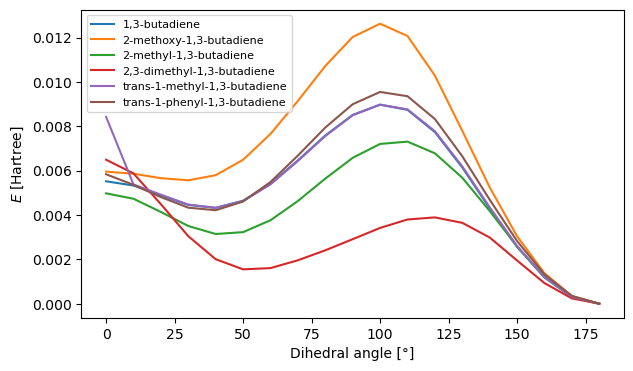

In [33]:
plt.figure(figsize=(7, 4))

for key, val in PES.items():
    normalized = [i-min(val) for i in val]
    plt.plot(dihedrals, normalized, label=key)

plt.xlabel('Dihedral angle [°]', fontsize=10)
plt.ylabel('$E$ [Hartree]', fontsize=10)

plt.legend(fontsize=8)
plt.show()

In [24]:
with open('molecules/1,3-butadiene.txt', 'r') as f:
    mol = f.read()

geom = psi4.geometry(mol)

psi4.set_options({'basis': '3-21G',
                  'freeze_core': True})

upper_bound = np.linspace(0, 180, 37)
lower_bound = [float(i-0.01) for i in upper_bound]
PES = []

for lower, upper in zip(lower_bound, upper_bound):
    my_string = f'1 2 3 4 {lower} {upper}'
    psi4.set_options({'ranged_dihedral': my_string})
    E = psi4.optimize('HF')
    PES.append(E)

psi4.core.clean()


Scratch directory: /tmp/
gradient() will perform analytic gradient computation.
   => Libint2 <=

    Primary   basis highest AM E, G, H:  6, 6, 3
    Auxiliary basis highest AM E, G, H:  7, 7, 4
    Onebody   basis highest AM E, G, H:  -, -, -
    Solid Harmonics ordering:            Gaussian

*** tstart() called on LAPTOP-0TVB8UPA
*** at Wed Apr 30 16:44:59 2025

   => Loading Basis Set <=

    Name: 3-21G
    Role: ORBITAL
    Keyword: BASIS
    atoms 1-4  entry C          line    68 file /home/bryan/miniconda3/envs/p4env/share/psi4/basis/3-21g.gbs 
    atoms 5-10 entry H          line    21 file /home/bryan/miniconda3/envs/p4env/share/psi4/basis/3-21g.gbs 


         ---------------------------------------------------------
                                   SCF
               by Justin Turney, Rob Parrish, Andy Simmonett
                          and Daniel G. A. Smith
                              RHF Reference
                        2 Threads,   1907 MiB Core
         --------

	Unable to completely converge to displaced geometry.
	RMS(dx):  1.327e-06 	Max(dx):  3.257e-06 	RMS(dq):  3.735e-01
AlgError: Exception created. Mesg: opt.py: Step is far too large.
 Caught AlgError exception


	 Current algorithm/dynamic_level is 0.


	 Alternative approaches are not available or turned on.



OptError: Maximum dynamic_level reached.